In [1]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
import keras
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(0)
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers
from sklearn.decomposition import PCA
from matplotlib.pyplot import figure
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta
from sklearn.metrics import accuracy_score, f1_score

In [2]:
x_train_scaled = pd.read_csv('data/260_sample_train_scaled.csv').set_index("Patient_ID")
x_train_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,WFDC8,LOC100506385,TRAF6,SLC30A9,ZNF77,LOC100506451,LOC100128103,LOC284294,LOC100419923,KRT37
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.620003,0.562421,0.068168,0.363113,0.422804,0.780228,0.0,1.000000,0.0,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.143228,0.201505,0.057336,0.782981,0.663072,0.629269,0.0,0.011390,0.0,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.405566,0.292509,0.373641,0.538469,0.657031,0.523246,0.0,0.352347,0.0,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.220280,0.231076,0.342264,0.556178,0.346121,0.570400,0.0,0.289215,0.0,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.390636,0.255390,0.581310,0.491315,0.243153,0.509954,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.339941,0.256610,0.329208,0.810403,0.688362,0.488245,0.0,0.000000,0.0,0.0
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.264473,0.175562,0.275027,0.651580,0.214643,0.503769,0.0,0.000000,0.0,0.0
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.327593,0.231615,0.497108,0.456867,0.234705,0.567805,0.0,0.000000,0.0,0.0


In [3]:
x_test_scaled = pd.read_csv('data/260_sample_test_scaled.csv').set_index("Patient_ID")
x_test_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,WFDC8,LOC100506385,TRAF6,SLC30A9,ZNF77,LOC100506451,LOC100128103,LOC284294,LOC100419923,KRT37
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.841880,0.930171,0.886737,0.835678,0.297964,0.668498,0.266670,0.278122,0.933520,...,0.272127,0.158761,0.477039,0.603174,0.425490,0.522545,0.0,0.416198,0.0,0.0
105_CD_plain,0.853562,0.933532,0.942213,0.794578,0.890482,0.206529,0.298987,0.350745,0.495663,0.849038,...,0.274333,0.097860,0.393713,0.372441,0.470420,0.604460,0.0,0.354617,0.0,0.0
2_CD_plain,0.165531,0.141475,0.263684,0.198091,0.160503,0.888878,0.000000,0.134461,0.989132,0.202203,...,0.236266,0.203037,0.268600,0.453277,0.293586,1.017337,0.0,0.000000,0.0,0.0
184_CD_plain,0.717121,0.660314,0.769417,0.752737,0.694874,0.514735,0.692365,0.271127,0.650742,0.694599,...,0.248285,0.151969,0.398006,0.519613,0.295247,0.540997,0.0,0.000000,0.0,0.0
312_CD_plain,0.730072,0.722909,0.713076,0.743545,0.679258,0.308459,0.399235,0.129019,0.597529,0.720390,...,0.367082,0.311587,0.431139,0.514804,0.759303,0.632481,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.241269,0.150268,0.396683,0.477946,0.355630,0.464810,0.0,0.000000,0.0,0.0
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.385842,0.269474,0.360027,0.911412,0.543782,0.505583,0.0,0.000000,0.0,0.0
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.318934,0.202156,0.476766,0.355764,0.373799,0.539196,0.0,0.000000,0.0,0.0


In [4]:
full_ds = pd.concat([x_train_scaled, x_test_scaled])
full_ds

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,WFDC8,LOC100506385,TRAF6,SLC30A9,ZNF77,LOC100506451,LOC100128103,LOC284294,LOC100419923,KRT37
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.620003,0.562421,0.068168,0.363113,0.422804,0.780228,0.0,1.000000,0.0,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.143228,0.201505,0.057336,0.782981,0.663072,0.629269,0.0,0.011390,0.0,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.405566,0.292509,0.373641,0.538469,0.657031,0.523246,0.0,0.352347,0.0,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.220280,0.231076,0.342264,0.556178,0.346121,0.570400,0.0,0.289215,0.0,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.390636,0.255390,0.581310,0.491315,0.243153,0.509954,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.241269,0.150268,0.396683,0.477946,0.355630,0.464810,0.0,0.000000,0.0,0.0
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.385842,0.269474,0.360027,0.911412,0.543782,0.505583,0.0,0.000000,0.0,0.0
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.318934,0.202156,0.476766,0.355764,0.373799,0.539196,0.0,0.000000,0.0,0.0


In [5]:
x_test_scaled.isnull().values.any()

False

In [6]:
full_ds = full_ds.sample(frac=1)

In [7]:
val_split_pt = int(0.85*len(full_ds))
split_pt = int(0.7*len(full_ds))

In [8]:
train_set = full_ds[:split_pt]
val_set = full_ds[split_pt:val_split_pt]
test_set = full_ds[val_split_pt:]

In [9]:
train_set

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,WFDC8,LOC100506385,TRAF6,SLC30A9,ZNF77,LOC100506451,LOC100128103,LOC284294,LOC100419923,KRT37
Patient_ID,,,,,,,,,,,,,,,,,,,,,
230_CD_deep_ulcer,0.512841,0.239306,0.327514,0.462345,0.249761,0.751775,0.000000,0.397554,0.885618,0.342238,...,0.245972,0.206061,0.331737,0.665971,0.520526,0.829675,0.0,0.000000,0.0,0.0
202_CD_deep_ulcer,0.730613,0.631576,0.719504,0.723623,0.680103,0.669807,0.188788,0.436573,0.654626,0.557570,...,0.263273,0.175898,0.426679,0.624670,0.047303,0.439728,0.0,0.000000,0.0,0.0
84_control,0.848339,0.806504,0.824615,0.923494,0.762137,0.199403,0.573129,0.192293,0.274358,1.042678,...,0.402809,0.275107,0.621850,0.449404,0.478901,0.459472,0.0,0.005147,0.0,0.0
22_CD_deep_ulcer,0.788681,0.745856,0.741478,0.847024,0.721888,0.223678,0.388486,0.208201,0.555424,0.719852,...,0.269770,0.224827,0.765126,0.648050,0.554659,0.452266,0.0,0.066095,0.0,0.0
35_control,0.868755,0.777184,0.832517,0.826357,0.724312,0.000000,0.578185,0.000000,0.391885,0.823626,...,0.172663,0.188365,0.348218,0.444814,0.409077,0.316351,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95_CD_deep_ulcer,0.322076,0.317311,0.295913,0.189476,0.222371,0.635286,0.186784,0.809517,0.583656,0.224686,...,0.290248,0.260985,0.351391,0.504305,0.331806,0.818300,0.0,0.000000,0.0,0.0
79_control,0.878863,0.829369,0.835280,0.875234,0.808486,0.065983,0.646077,0.175961,0.105170,0.957508,...,0.302954,0.206170,0.552370,0.617858,0.376906,0.465685,0.0,0.000000,0.0,0.0
220_CD_plain,0.702530,0.609120,0.672639,0.713718,0.613770,0.333842,0.340864,0.018566,0.482652,0.715491,...,0.358091,0.219821,0.449014,0.438076,0.515886,0.687529,0.0,0.093097,0.0,0.0


### Dimensionality reduction with PCA

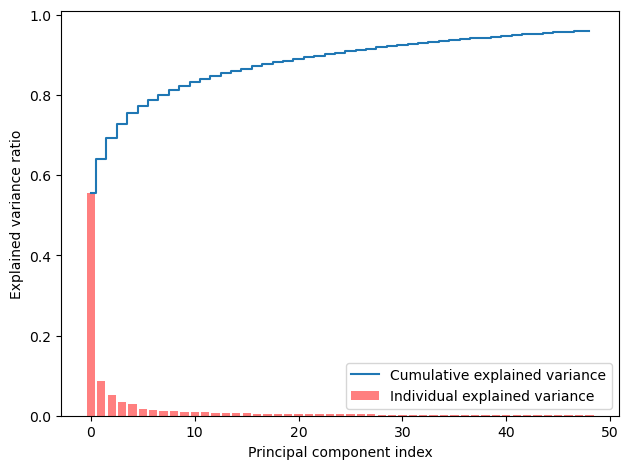

In [10]:
#https://vitalflux.com/pca-explained-variance-concept-python-example/#google_vignette

pca = PCA()
pca = PCA(n_components=.96)
#
# Determine transformed features
#
X_train_pca = pca.fit_transform(train_set)
#
# Determine explained variance using explained_variance_ration_ attribute
#
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', color='r',label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [11]:
# https://www.datacamp.com/tutorial/principal-component-analysis-in-python

def encode_pca(dataset):
    pca_x_test = PCA(n_components=32)
    principalComponents_x_test = pca_x_test.fit_transform(dataset)
    if isinstance(dataset,np.ndarray):
        index = None
    else:
        index=dataset.index
    pca_x_test_ds = pd.DataFrame(data = principalComponents_x_test, 
                                       index=index)
    return pca_x_test_ds, pca_x_test

# full_pca_dataset, pca_x = encode_pca(full_ds)
# split_pt = int(0.7 * len(full_pca_dataset))
# pca_test_dataset = full_pca_dataset[split_pt:]
# pca_train_dataset = full_pca_dataset[:split_pt]

In [12]:
full_pca_dataset, pca_x = encode_pca(full_ds)
pca_train_dataset = full_pca_dataset[:split_pt]
pca_val_dataset = full_pca_dataset[split_pt:val_split_pt]
pca_test_dataset = full_pca_dataset[val_split_pt:]

In [13]:
train_patient_ids = np.array(pca_train_dataset.index)
val_patient_ids = np.array(pca_val_dataset.index)
test_patient_ids = np.array(pca_test_dataset.index)

In [14]:
train_patient_ids.shape

(182,)

In [15]:
val_patient_ids.shape

(39,)

In [16]:
test_patient_ids.shape

(39,)

In [17]:
# pca_train_dataset.to_csv("pca_train_dataset.csv")

In [18]:
print('Explained variation per principal component: {}'.format(pca_x.explained_variance_ratio_))
print("Total variance explained:",np.sum(pca_x.explained_variance_ratio_))

Explained variation per principal component: [0.55039917 0.09076919 0.05681102 0.03219188 0.02849783 0.01637251
 0.0146013  0.01173407 0.01060928 0.00961534 0.00835421 0.00763502
 0.00659306 0.00616088 0.00551968 0.00527962 0.00511219 0.00475441
 0.00469771 0.00441403 0.00398524 0.00391531 0.0037373  0.00354318
 0.00344642 0.00337811 0.00320688 0.00318    0.00306547 0.00292992
 0.00283845 0.00263177]
Total variance explained: 0.9199804271203931


In [19]:
# pc1_var, pc2_var = np.round(pca_x_test.explained_variance_ratio_ * 100, 1)
# pc1_var

### Dimensionality reduction with autoencoder

In [20]:
def load_encoder():
    n_inputs = 220
    n_bottleneck = 32
    encoder = Sequential(
                [

#                     Input(shape=(n_inputs,)),
                    # encoder level 1
                    Dense(n_inputs*2),
                    BatchNormalization(),
                    LeakyReLU(),
                    # encoder level 2
                    Dense(n_inputs),
                    BatchNormalization(),
                    LeakyReLU(),
                    # bottleneck
                    Dense(n_bottleneck)
                ]
            )

    sh = test_set.head(1).shape
    encoder.load_weights("data/models/cd_encoder")
    encoder.build(sh) 
#     encoder.summary()
    return encoder

In [21]:
def ae_encode_dataset(dataset):
    encoder = load_encoder()
    latent_var = np.arange(32)
    print(type(dataset))
    if isinstance(dataset,np.ndarray):
        recon = encoder(dataset)
        index=None
    else:
        recon = encoder(dataset.values)
        index = dataset.index
    r = pd.DataFrame(recon, columns=latent_var, index=index)
    return r
    
full_ae_dataset = ae_encode_dataset(full_ds)

# split_pt = int(0.7 * len(full_ae_dataset))
# ae_test_dataset = full_ae_dataset[split_pt:]
# ae_train_dataset = full_ae_dataset[:split_pt]

<class 'pandas.core.frame.DataFrame'>


In [22]:
# ae_train_dataset

## True labels

In [23]:
def classify(x):
    if "_control" in x: # control
        return 0
    elif "CD_plain" in x: # Crohn's Disease no deep ulcer
#         print(x)
        return 1
    elif "CD_deep_ulcer" in x: # Crohn's Disease deep ulcer
#         print(x)
        return 2
    else:
        return 3 # Ulcerative Collitis

vec = np.vectorize(classify)

train_disease_labels = vec(train_patient_ids)
val_disease_labels = vec(val_patient_ids)
test_disease_labels = vec(test_patient_ids)

In [24]:
import matplotlib.pyplot as plt

from matplotlib.ticker import NullFormatter
from sklearn import manifold, datasets
from time import time

## KMeans clustering

### Fit KMeans (PCA & tSNE dimensionality reduction)

In [25]:
def compute_silh_scores(datapoints, cluster_labels):
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(datapoints, cluster_labels)


    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(datapoints, cluster_labels)
    
    return silhouette_avg, sample_silhouette_values

def plot_silhouette(n_clusters, cluster_labels, sample_silhouette_values, silhouette_avg, ax):
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax.set_title("The silhouette plot for the various clusters.")
    ax.set_xlabel("The silhouette coefficient values")
    ax.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax.set_yticks([])  # Clear the yaxis labels / ticks
    ax.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

In [26]:
train_disease_labels.shape

(182,)

In [27]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html


def plot_kmeans(X, X_val, disease_labels, val_disease_labels, k_labels, k_labels_val, centers, radii, reduction, num_c=4, test_set=True, plot_sil=False):

    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    


    label_sets = [k_labels, disease_labels]
    num_clusters = 3
    dset = "test" if test_set else "train"


    for i, label_set in enumerate(label_sets):
        
        ax = subplots[0][i] if plot_sil else subplots[i]

        dset = "test" if test_set else "train"

        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("KMeans clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 



        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

#         if selected_patient_idx is not None:
#             ax.scatter(Y[selected_patient_idx, 0], Y[selected_patient_idx, 1], c="cyan", s=400, marker='*',edgecolor='black', linewidth=.7, label="Selected patient")

        ax.legend()

        ax.axis("tight")
        
    if plot_sil:
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, k_labels_val)
        plot_silhouette(num_c, k_labels_val, sample_silhouette_values, silhouette_avg, subplots[1][0])
        acc = accuracy_score(val_disease_labels, k_labels_val)
        f1 = f1_score(val_disease_labels, k_labels_val, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

        ax.legend()

    
    plt.show()
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        




### Training

In [28]:
def train_kmeans(full_dataset, perplexity):
    # compress to 2D with tSNE
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    split_pt = int(0.85 * len(full_dataset))
    val_split_pt = int(0.7 * len(full_dataset))
    X_test = X[split_pt:]
    X_train = X[:val_split_pt]
    X_val = X[val_split_pt:split_pt]
    # X_train = np.concatenate([X[:split_pt], X[-num_c:]])

    num_c=4
    kmeans = KMeans(num_c, random_state=0).fit(X_train)
    k_labels_train = kmeans.predict(X_train)
    k_labels_val = kmeans.predict(X_val)
    k_labels_test = kmeans.predict(X_test)


    # representation of the KMeans model (both)
    # centers = X[-num_c:]
    centers = kmeans.cluster_centers_
    radii = [cdist(X_train[k_labels_train == i], [center]).max()
             for i, center in enumerate(centers)]
    
    return kmeans, X_train, X_val, X_test, k_labels_train, k_labels_val, k_labels_test, centers, radii

In [29]:
def plot_val_scores(sil_scores, acc_scores, f1_scores, reduction):
    plt.figure()
    plt.plot(perplexities, sil_scores, label="Avg silhouette score")
    plt.plot(perplexities, acc_scores, label="Accuracy")
    plt.plot(perplexities, f1_scores, label="F1-score")
    plt.xlabel("Perplexity")
    plt.title("Effect of tSNE perplexity value on clustering evaluation over validation set ("+reduction+" reduction)")

    plt.legend()
    plt.show()

In [30]:
np.arange(0, 251, 10)[1:]

array([ 10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120, 130,
       140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250])

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


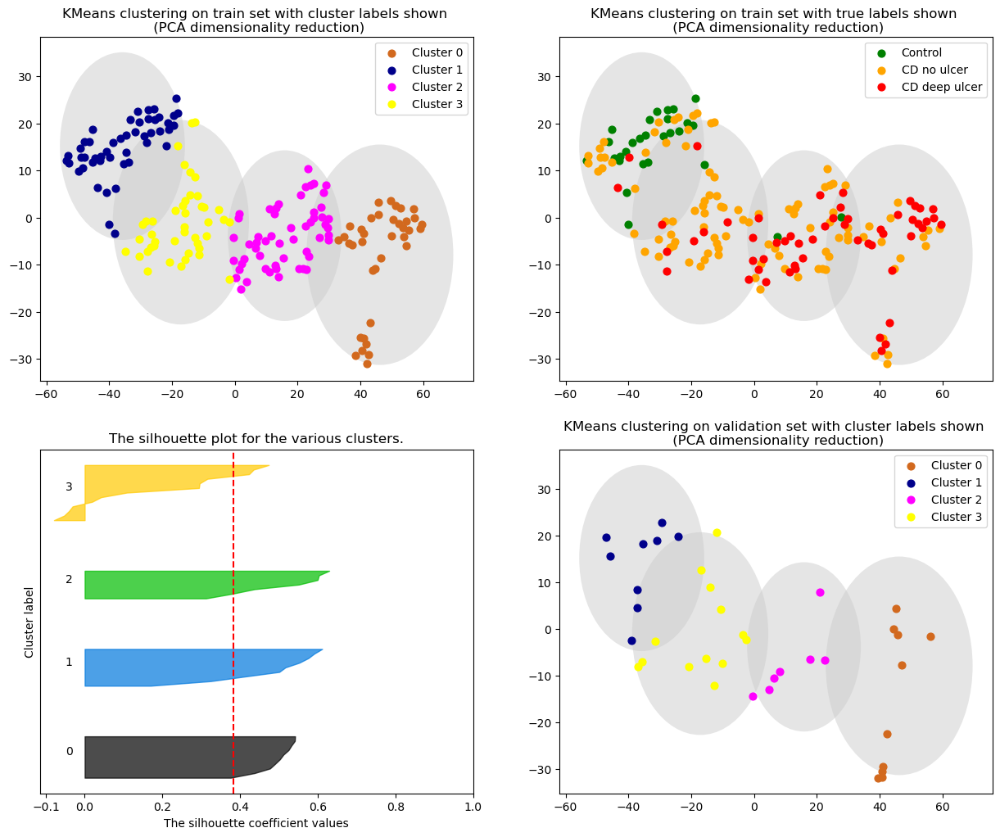

The average silhouette_score is : 0.3822927
Accuracy: 0.10256410256410256
F1 score: 0.12948717948717947


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


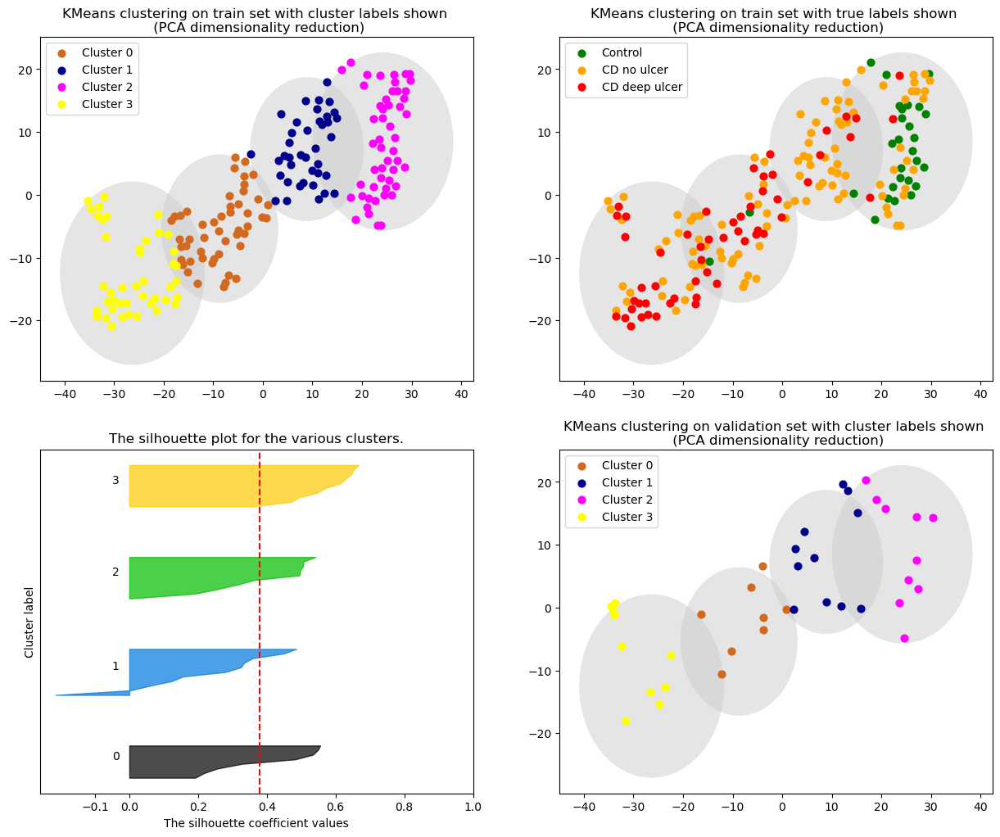

The average silhouette_score is : 0.3795482
Accuracy: 0.15384615384615385
F1 score: 0.2019230769230769


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


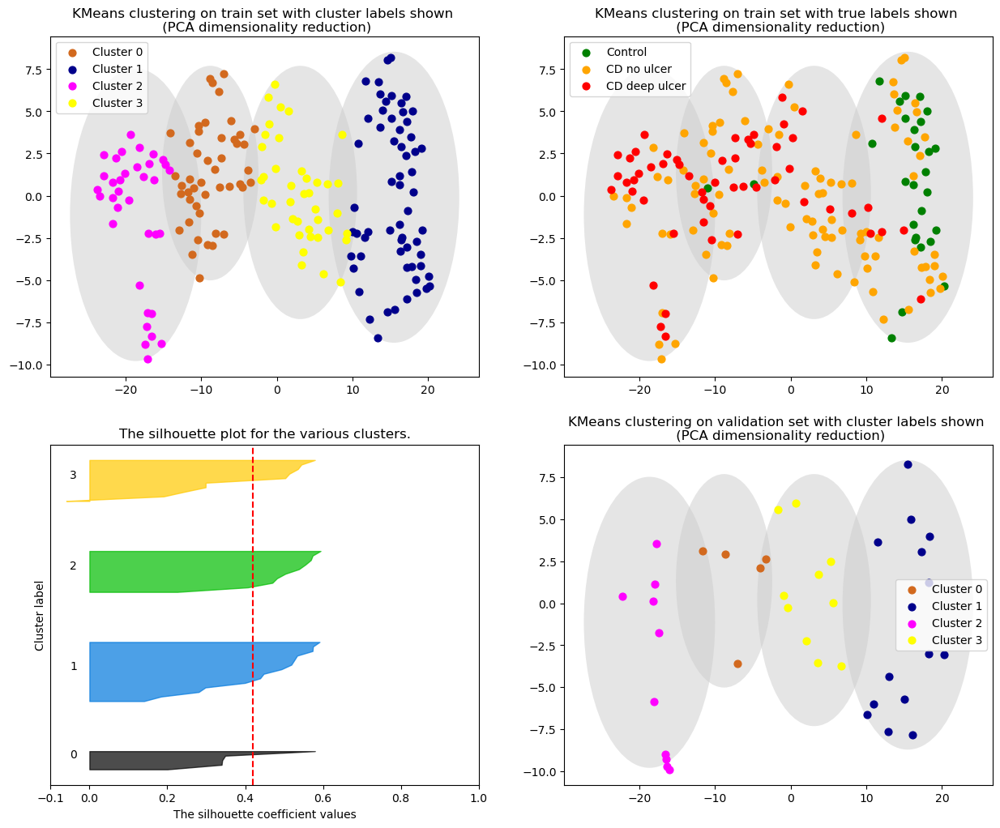

The average silhouette_score is : 0.41973802
Accuracy: 0.2564102564102564
F1 score: 0.2817813765182186


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


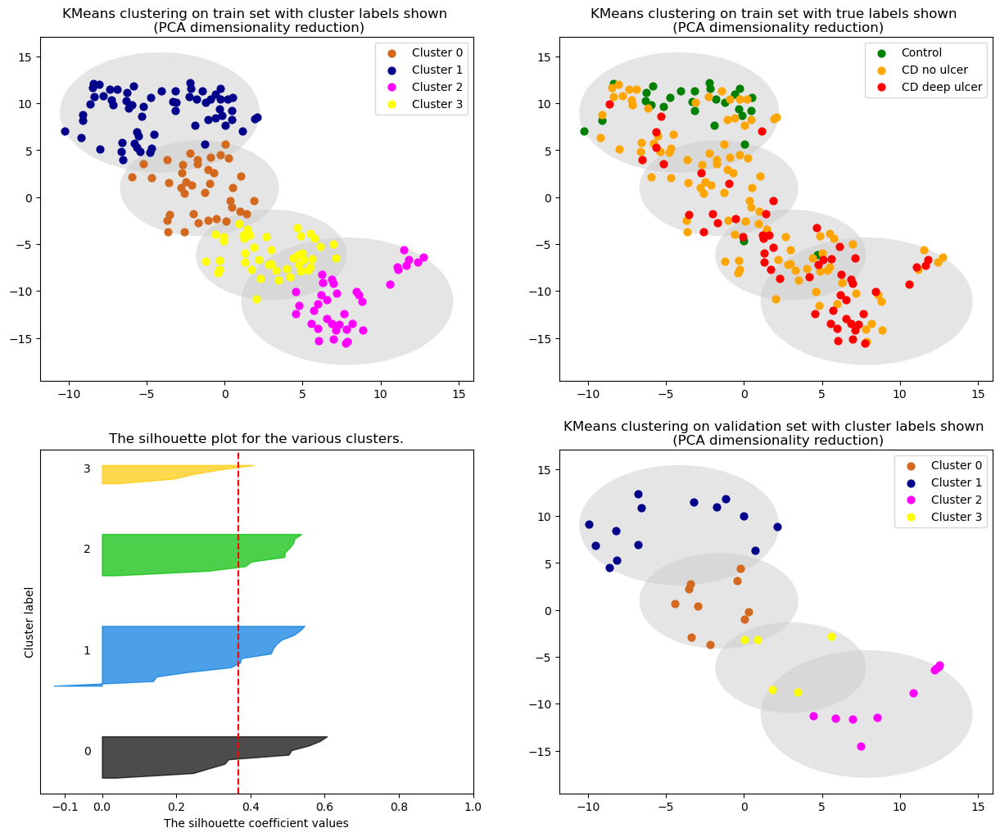

The average silhouette_score is : 0.36742386
Accuracy: 0.28205128205128205
F1 score: 0.3060728744939271


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


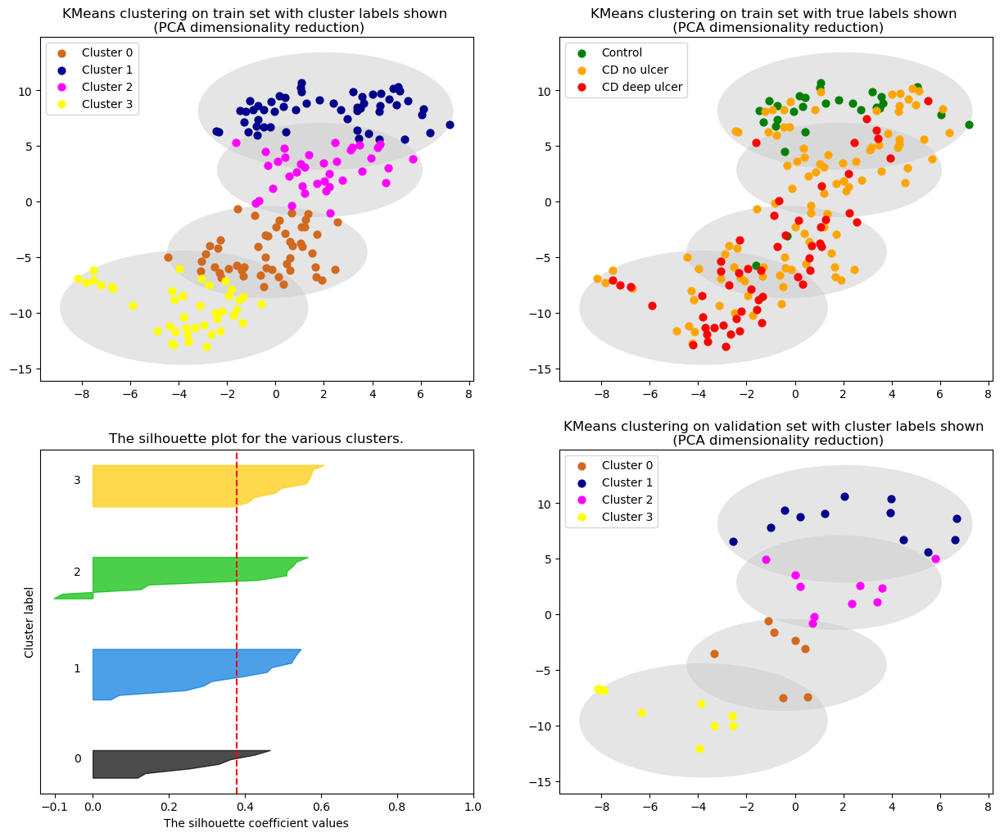

The average silhouette_score is : 0.37827626
Accuracy: 0.20512820512820512
F1 score: 0.2360446570972887


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


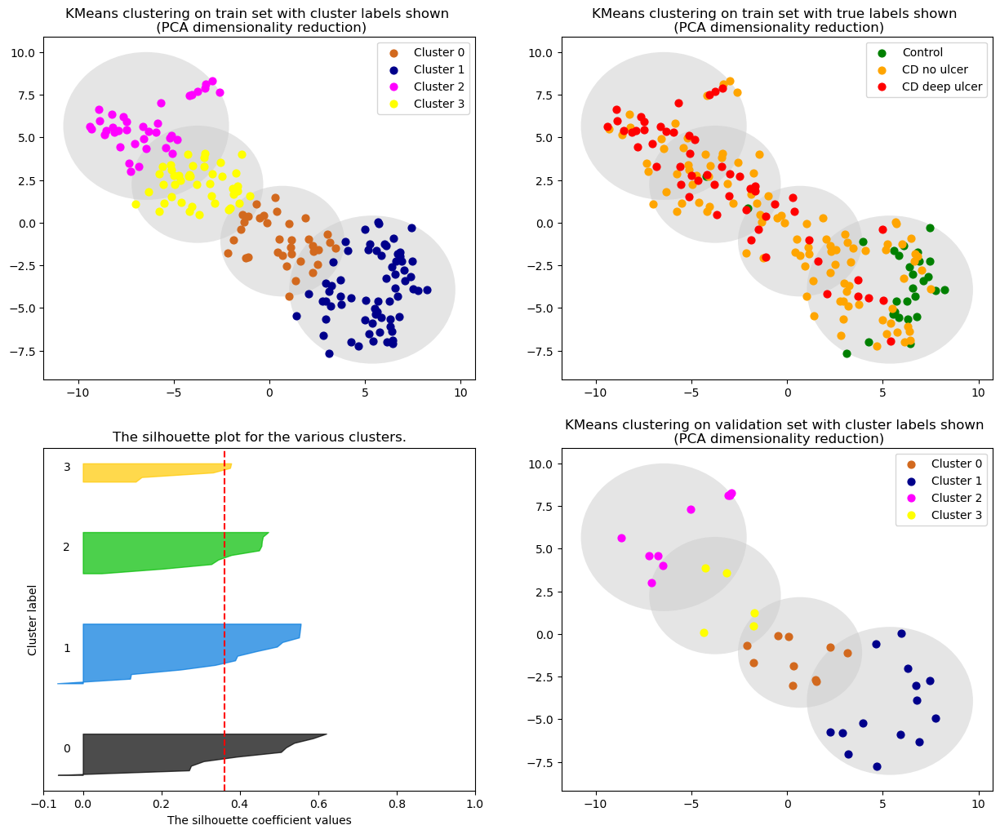

The average silhouette_score is : 0.3621766
Accuracy: 0.28205128205128205
F1 score: 0.3060728744939271


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


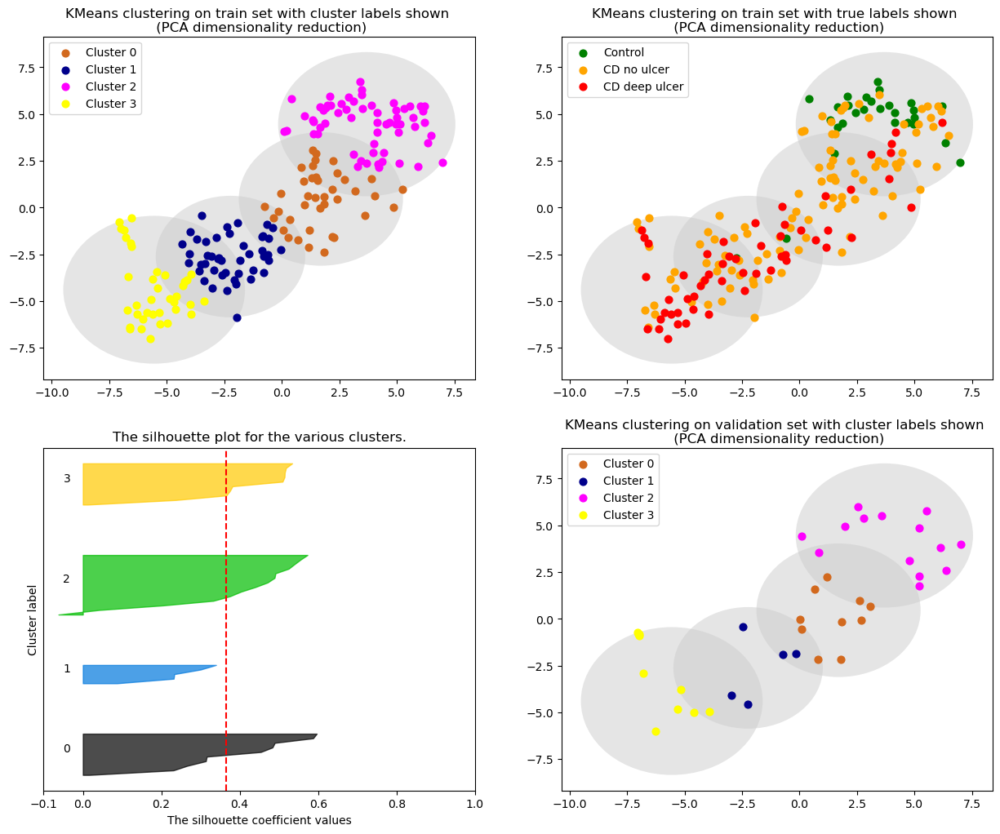

The average silhouette_score is : 0.36630392
Accuracy: 0.10256410256410256
F1 score: 0.14855185300529428


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


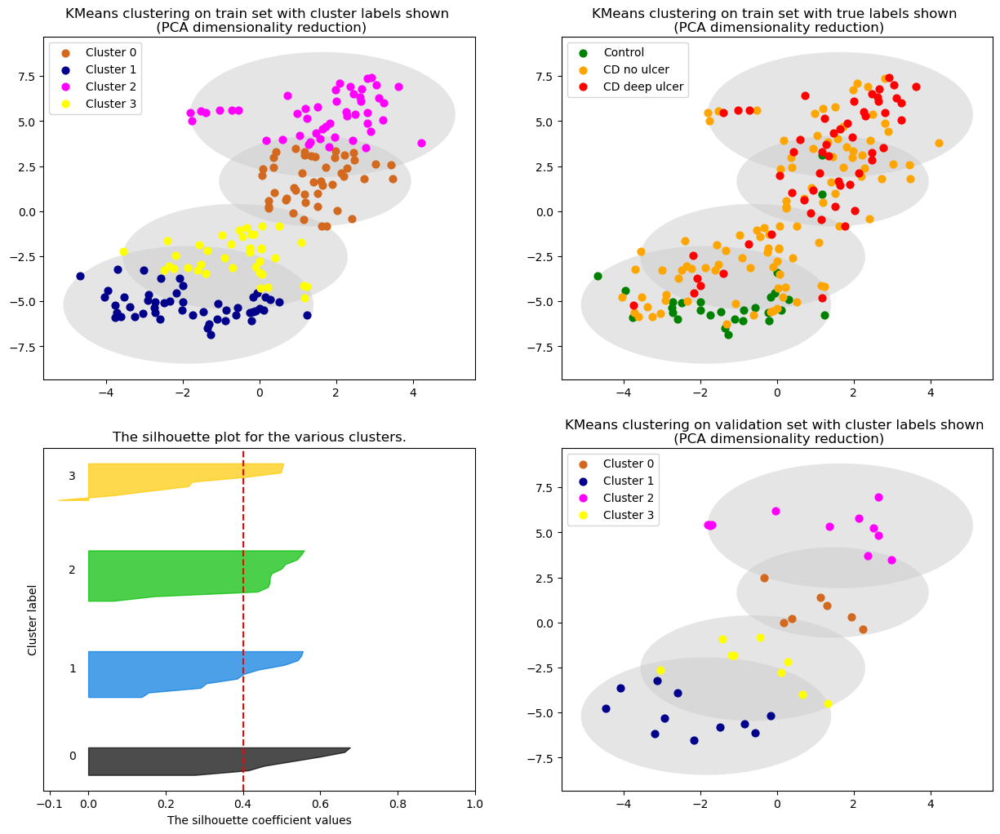

The average silhouette_score is : 0.40147334
Accuracy: 0.23076923076923078
F1 score: 0.24450549450549447


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


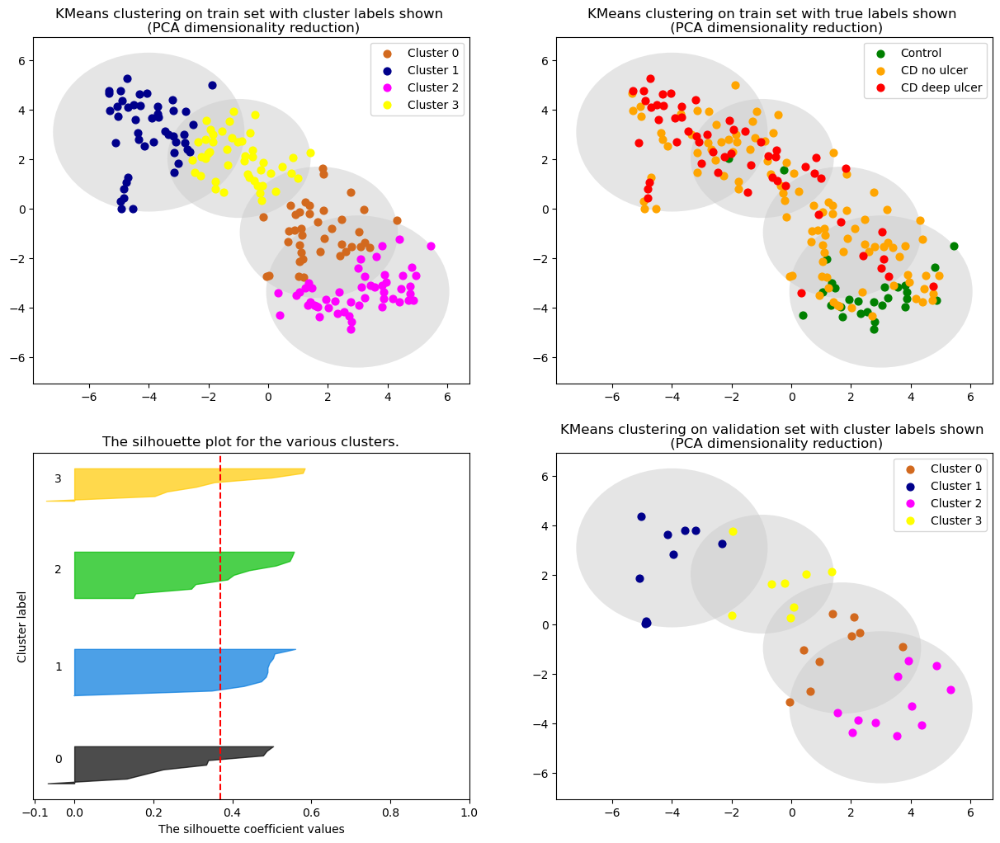

The average silhouette_score is : 0.36878964
Accuracy: 0.23076923076923078
F1 score: 0.28685897435897434


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


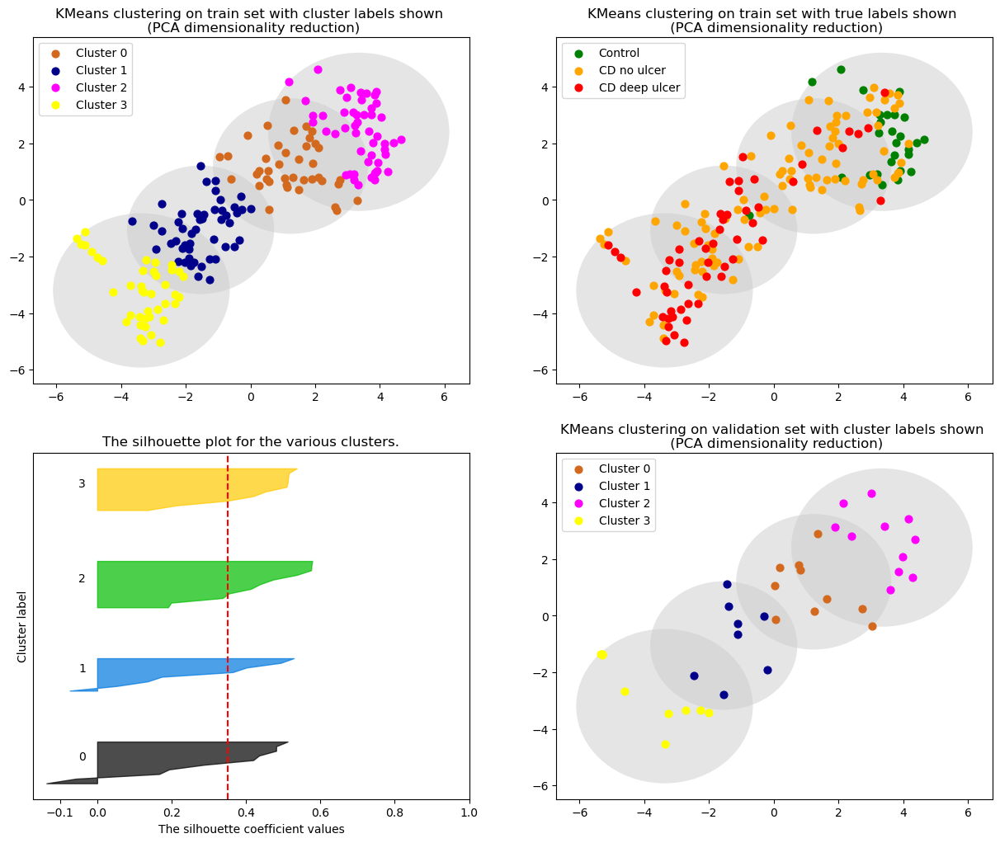

The average silhouette_score is : 0.35101733
Accuracy: 0.20512820512820512
F1 score: 0.2713946670389502


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


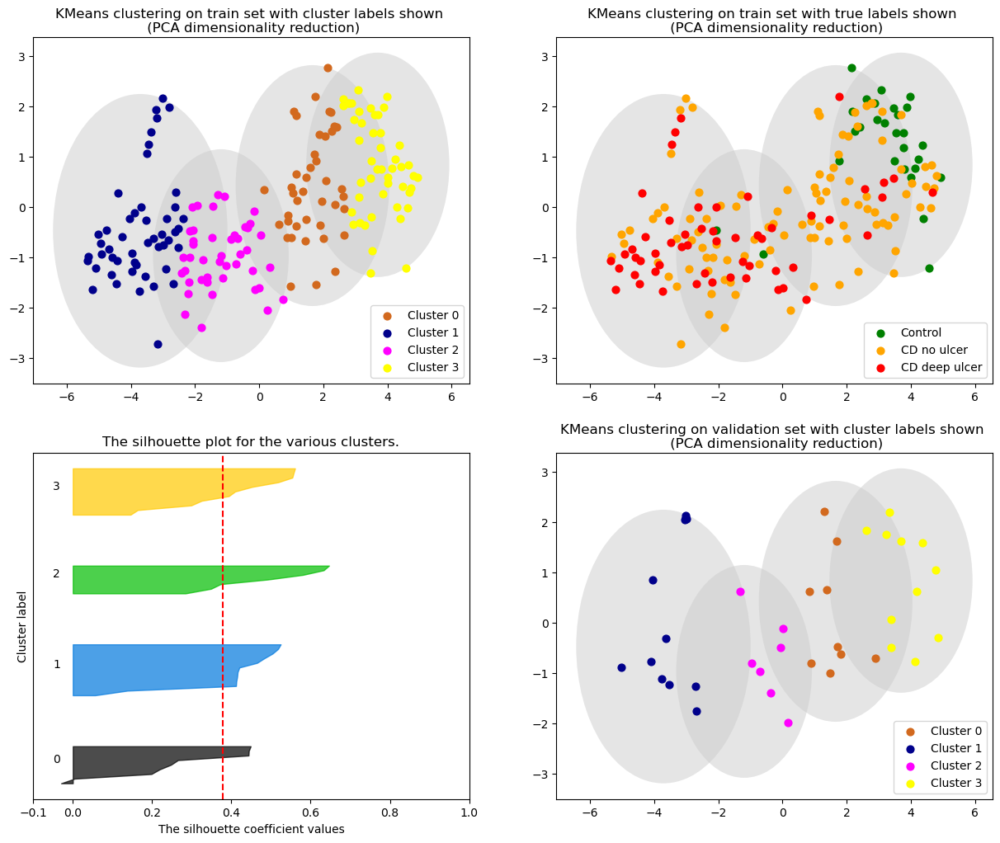

The average silhouette_score is : 0.3779735
Accuracy: 0.2564102564102564
F1 score: 0.30856643356643354


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


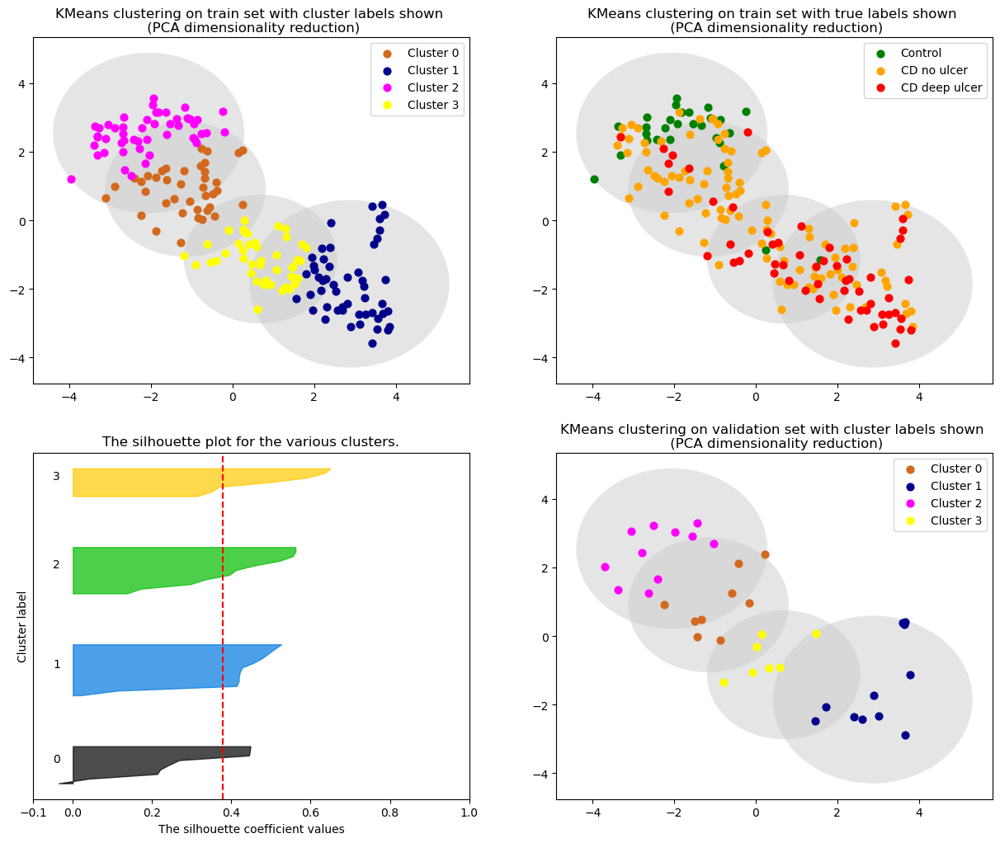

The average silhouette_score is : 0.37922254
Accuracy: 0.23076923076923078
F1 score: 0.2797202797202797


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


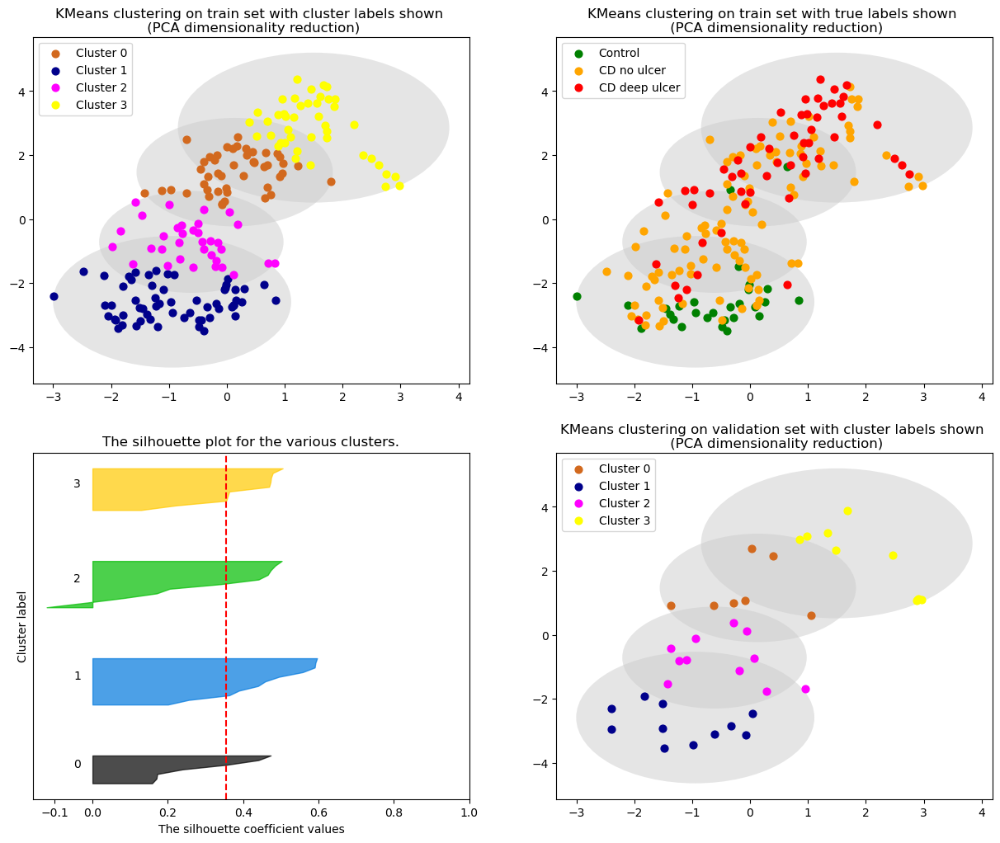

The average silhouette_score is : 0.35388967
Accuracy: 0.1794871794871795
F1 score: 0.20384615384615382


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


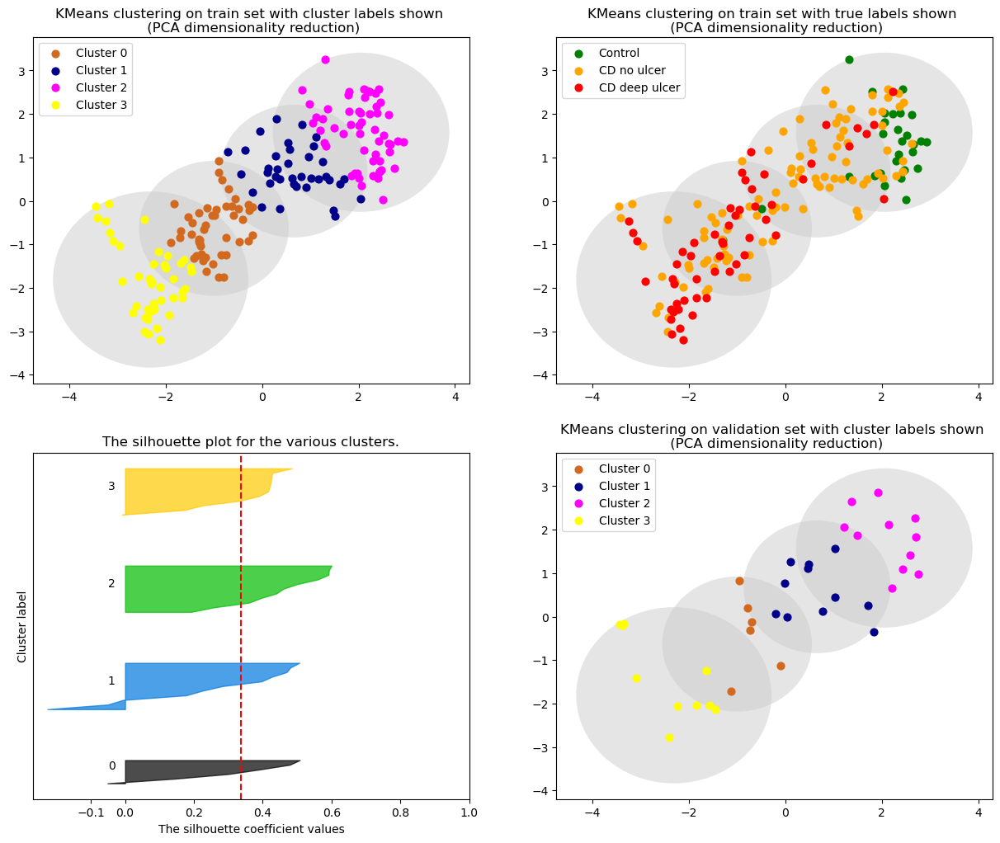

The average silhouette_score is : 0.33618698
Accuracy: 0.15384615384615385
F1 score: 0.2019230769230769


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


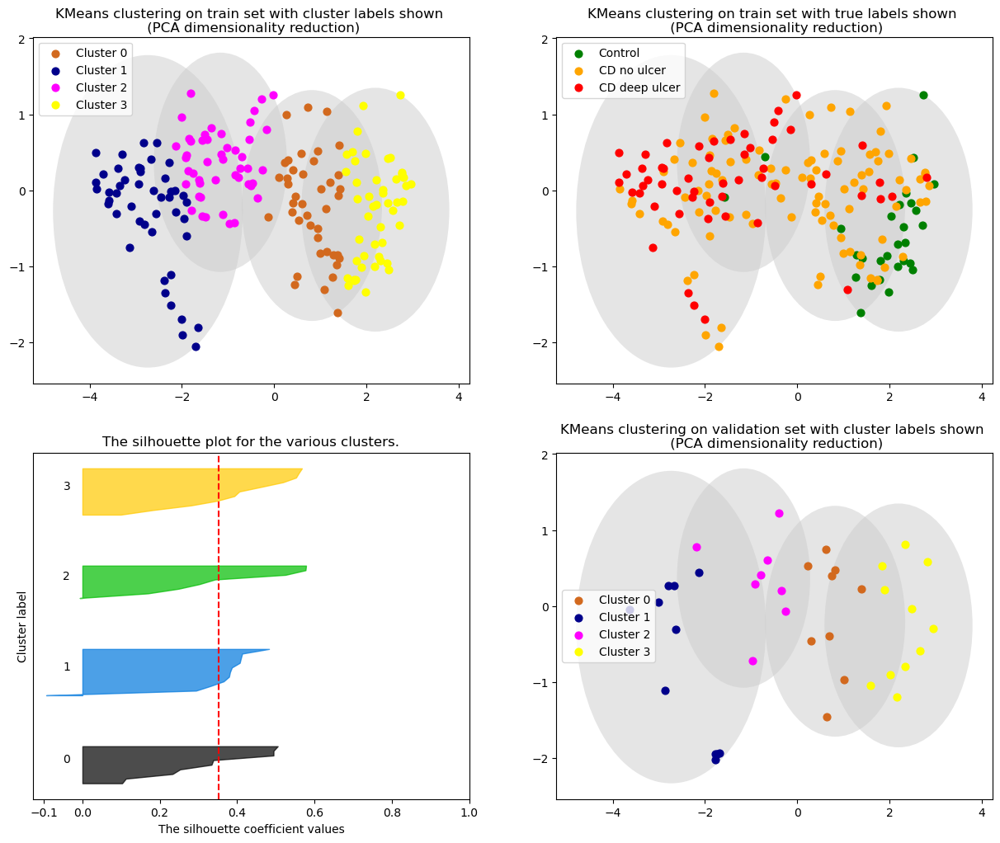

The average silhouette_score is : 0.35200268
Accuracy: 0.28205128205128205
F1 score: 0.34115761689291096


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


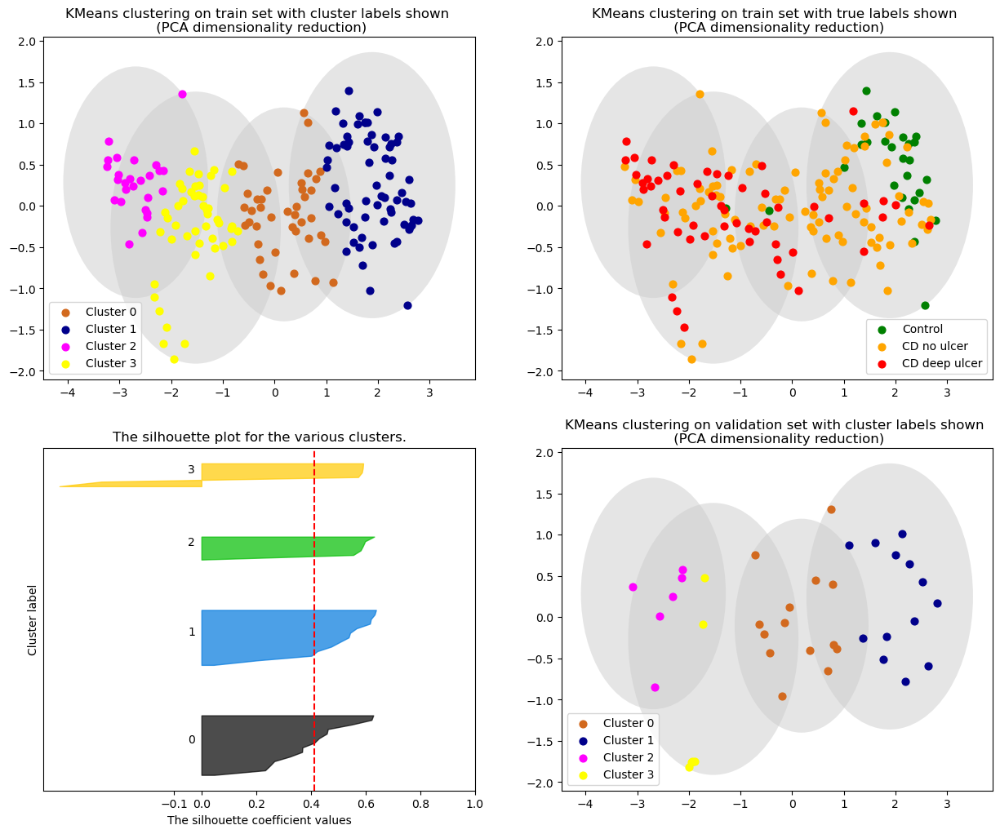

The average silhouette_score is : 0.4113619
Accuracy: 0.23076923076923078
F1 score: 0.2707456226637812


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


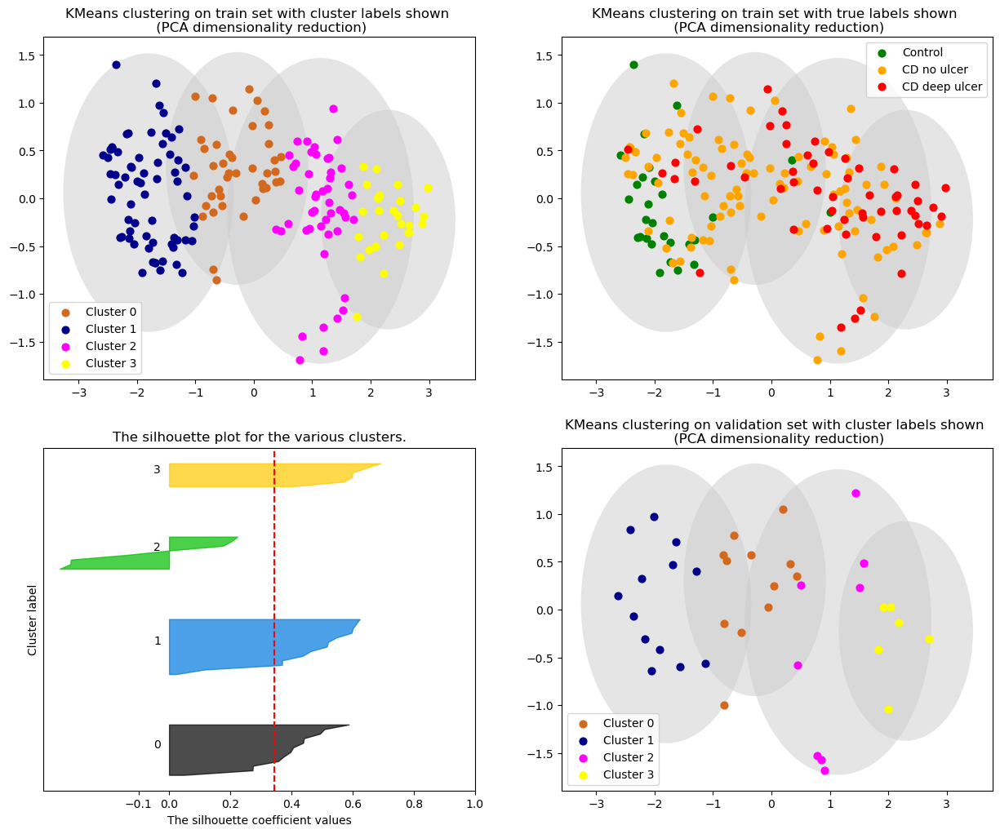

The average silhouette_score is : 0.3427014
Accuracy: 0.20512820512820512
F1 score: 0.23464770523594053


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


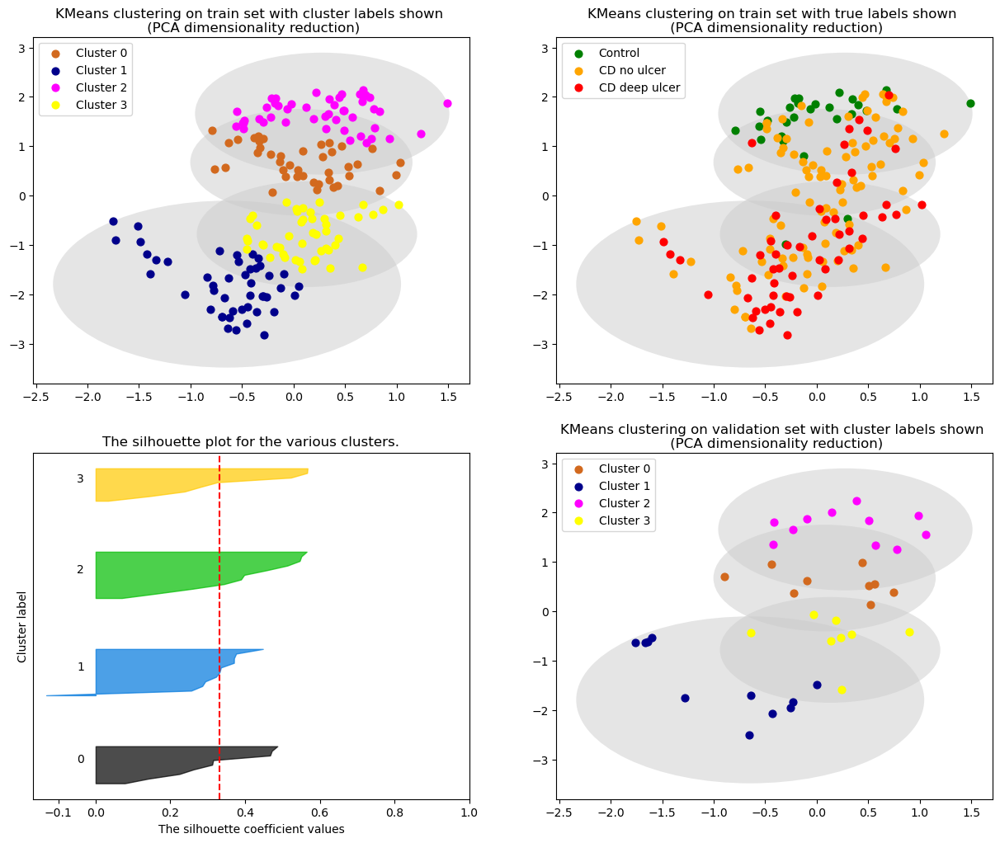

The average silhouette_score is : 0.33214104
Accuracy: 0.23076923076923078
F1 score: 0.28685897435897434


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


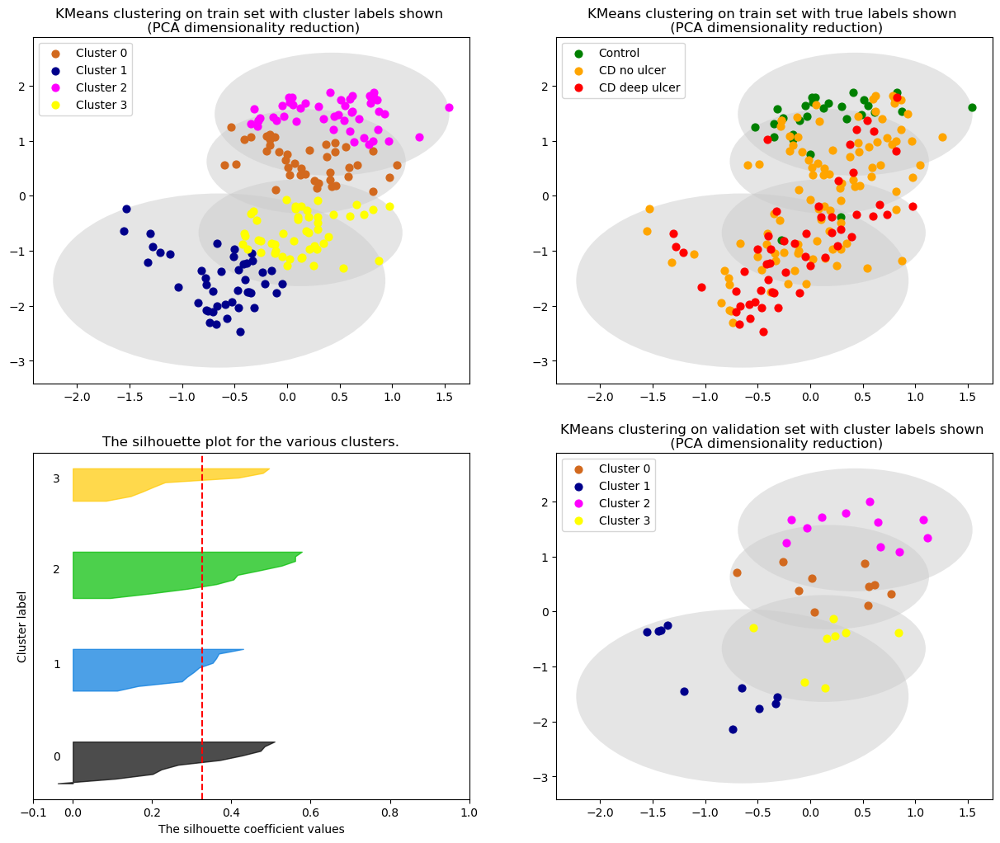

The average silhouette_score is : 0.3255982
Accuracy: 0.20512820512820512
F1 score: 0.2570197205171738


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


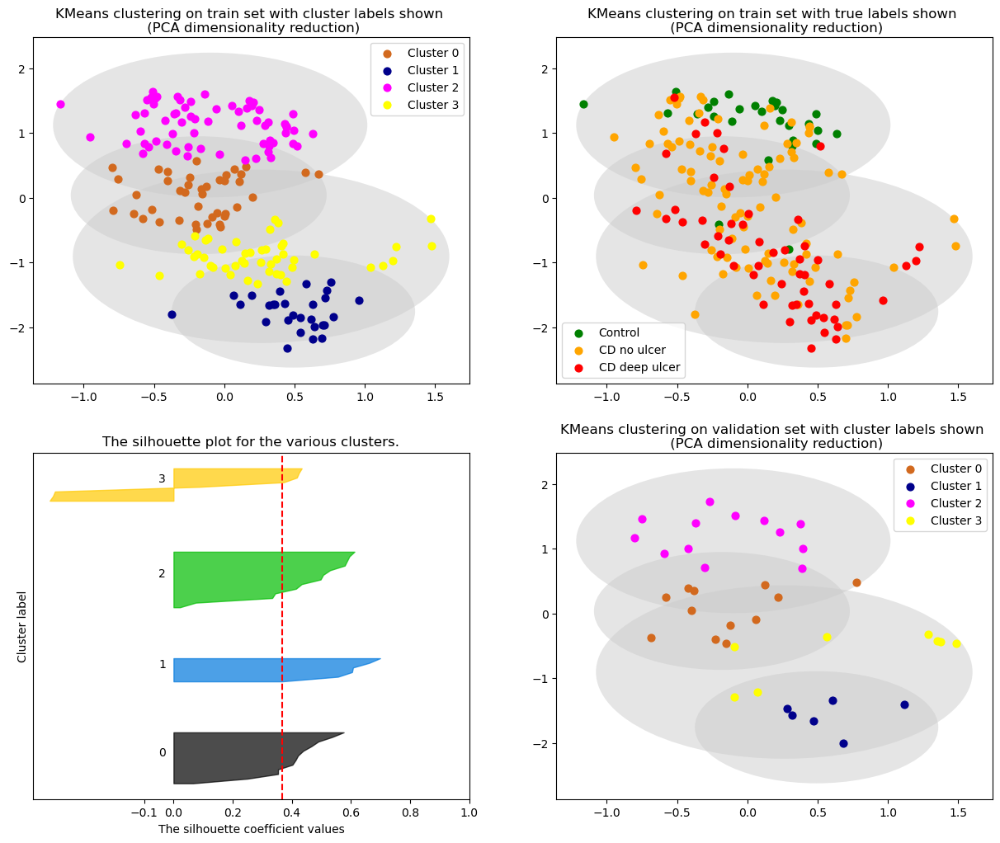

The average silhouette_score is : 0.36651826
Accuracy: 0.10256410256410256
F1 score: 0.14163614163614163


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


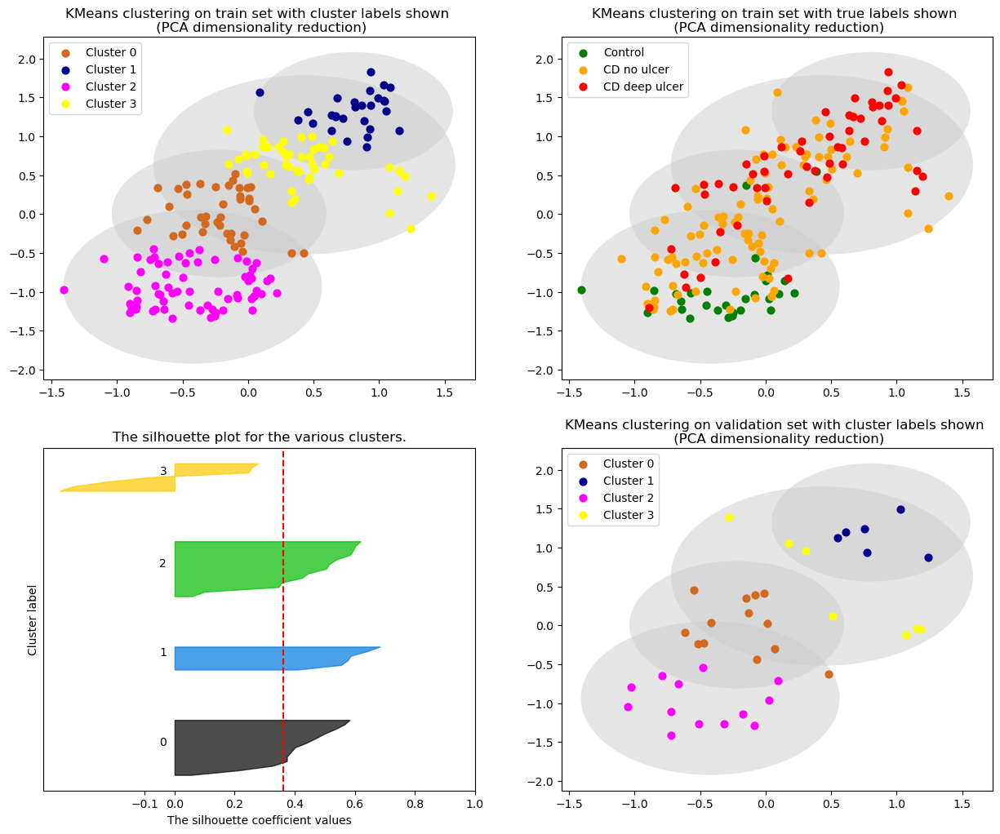

The average silhouette_score is : 0.36160383
Accuracy: 0.10256410256410256
F1 score: 0.14063714063714064


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


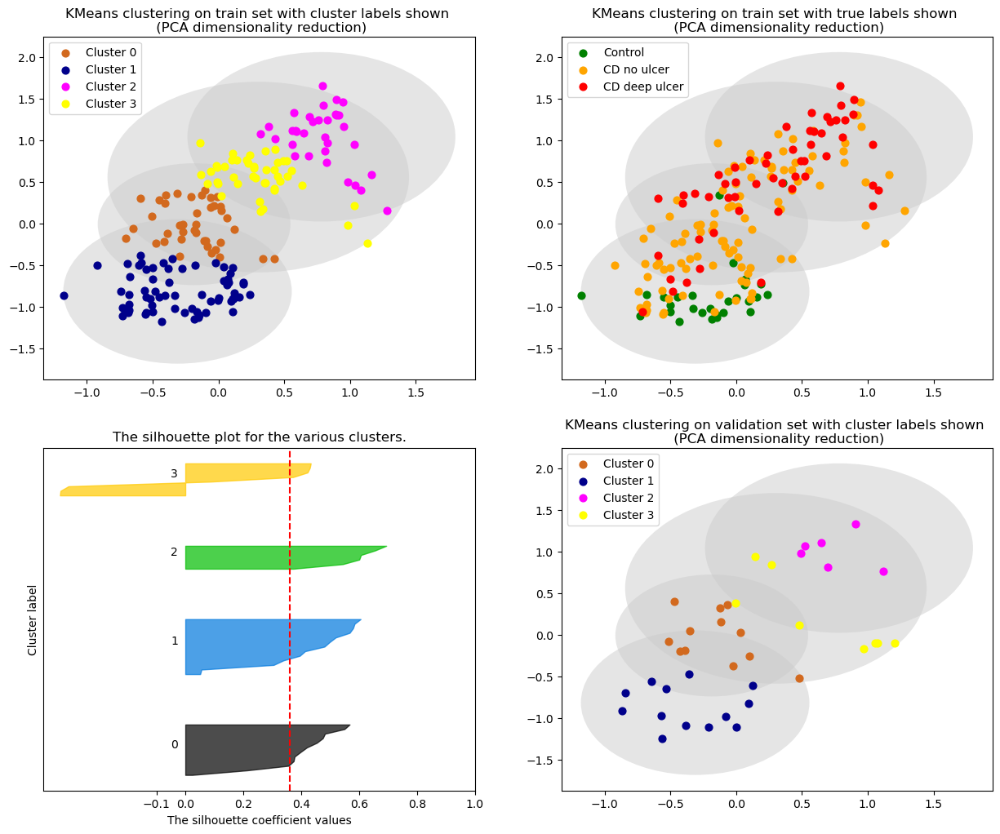

The average silhouette_score is : 0.3596666
Accuracy: 0.23076923076923078
F1 score: 0.27265675500969616


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


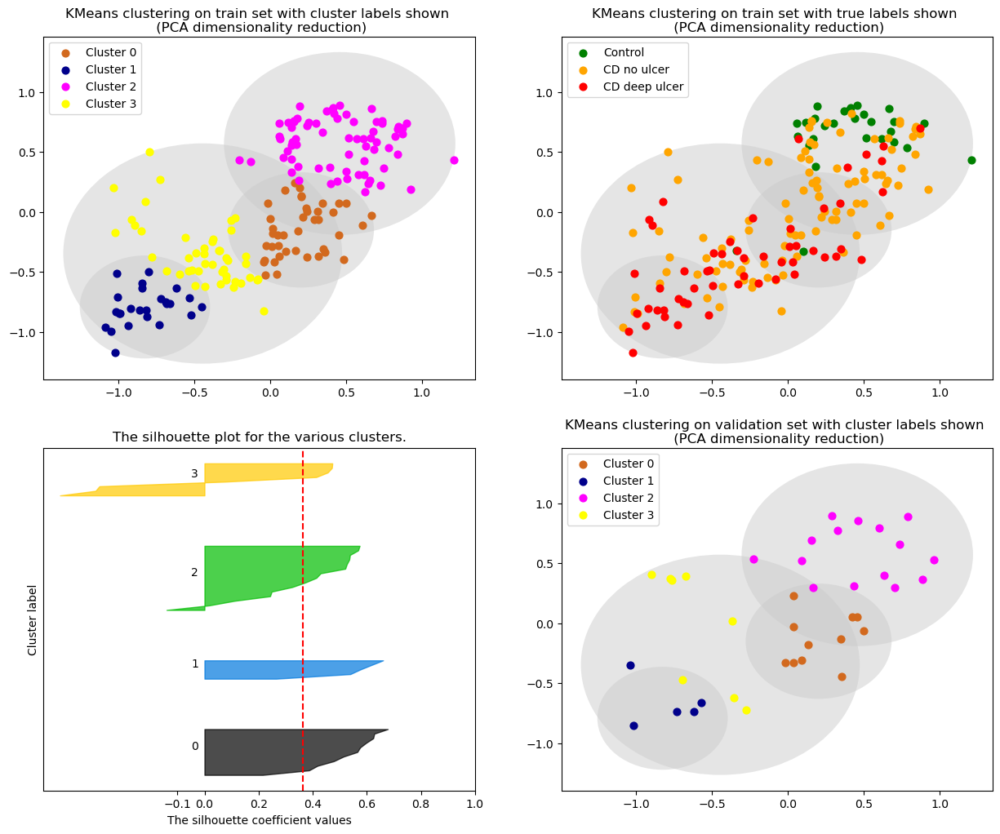

The average silhouette_score is : 0.36346313
Accuracy: 0.07692307692307693
F1 score: 0.12426035502958577


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


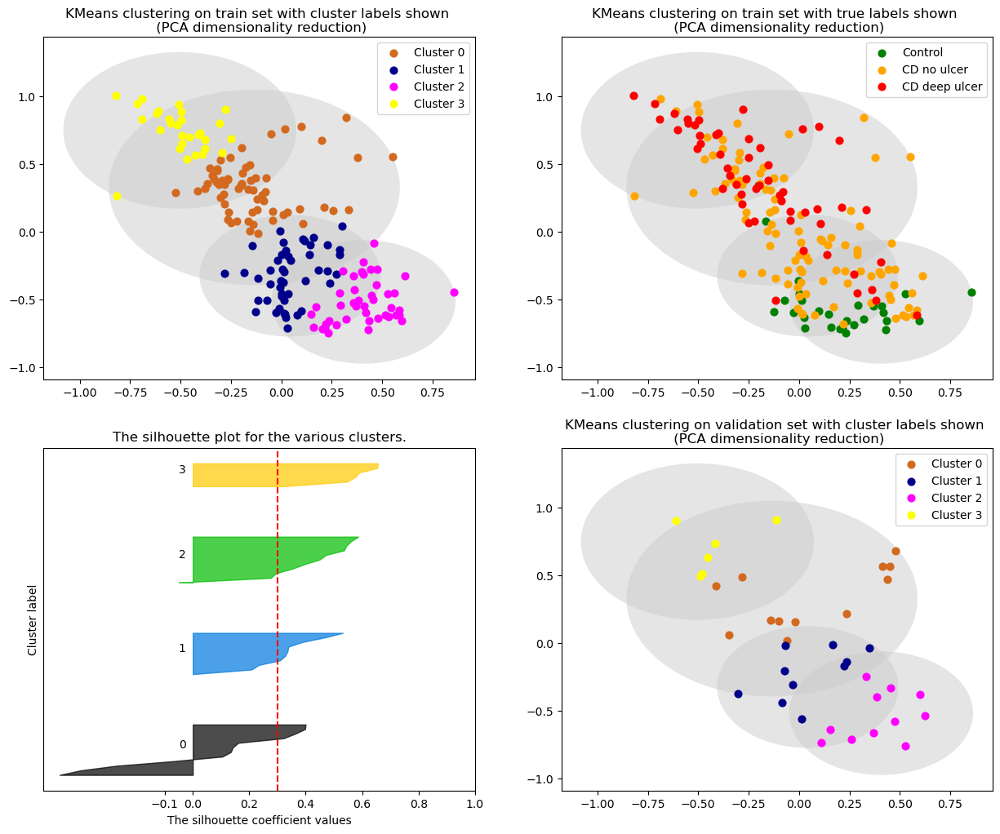

The average silhouette_score is : 0.300302
Accuracy: 0.1282051282051282
F1 score: 0.17369727047146402


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


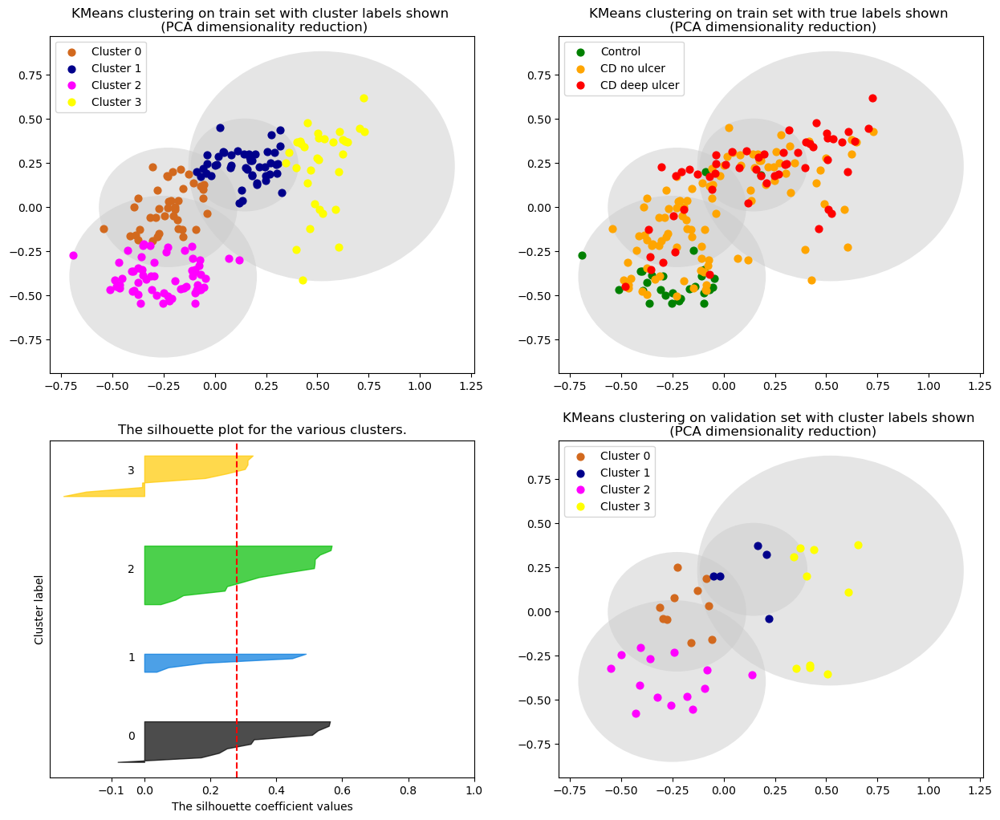

The average silhouette_score is : 0.2796773
Accuracy: 0.10256410256410256
F1 score: 0.14855185300529428


In [31]:
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_pca, X_val_pca, train_disease_labels, val_disease_labels, k_labels_train_pca, k_labels_val_pca, centers_pca, radii_pca, "PCA", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

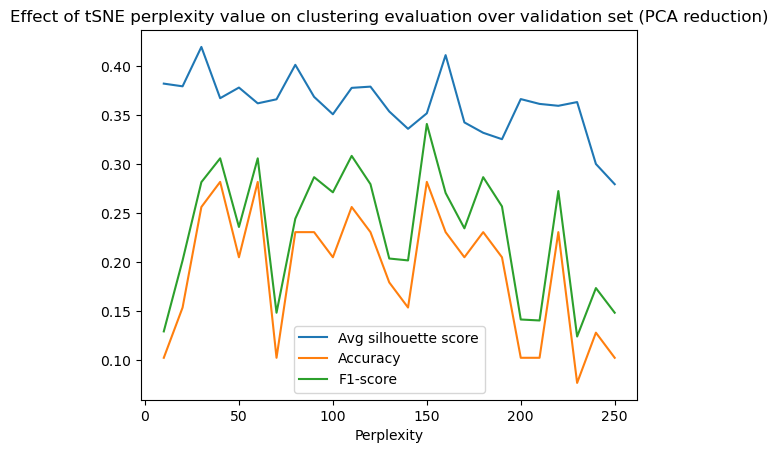

In [32]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


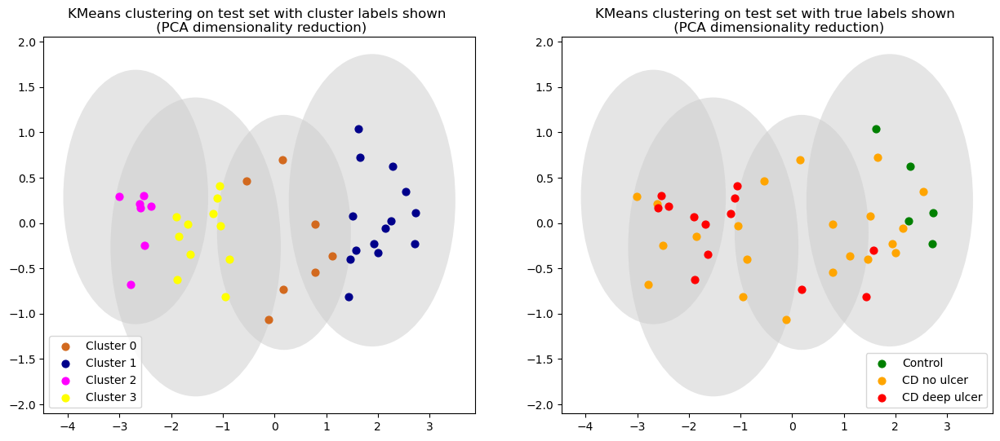

In [33]:
# plot with chosen tsne perplexity
perplexity = 160
kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_pca, None, test_disease_labels, None, k_labels_test_pca, None, centers_pca, radii_pca, "PCA", test_set=True)
        
# silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val_pca, k_labels_val_pca)
# acc = accuracy_score(val_disease_labels, k_labels_val_pca)
# f1 = f1_score(val_disease_labels, k_labels_val_pca, average='weighted')
# print("The average silhouette_score is :",silhouette_avg)
# print("Accuracy:",acc)
# print("F1 score:",f1)


### Fit KMeans (Autoencoder & tSNE dimensionality reduction)

### Training

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


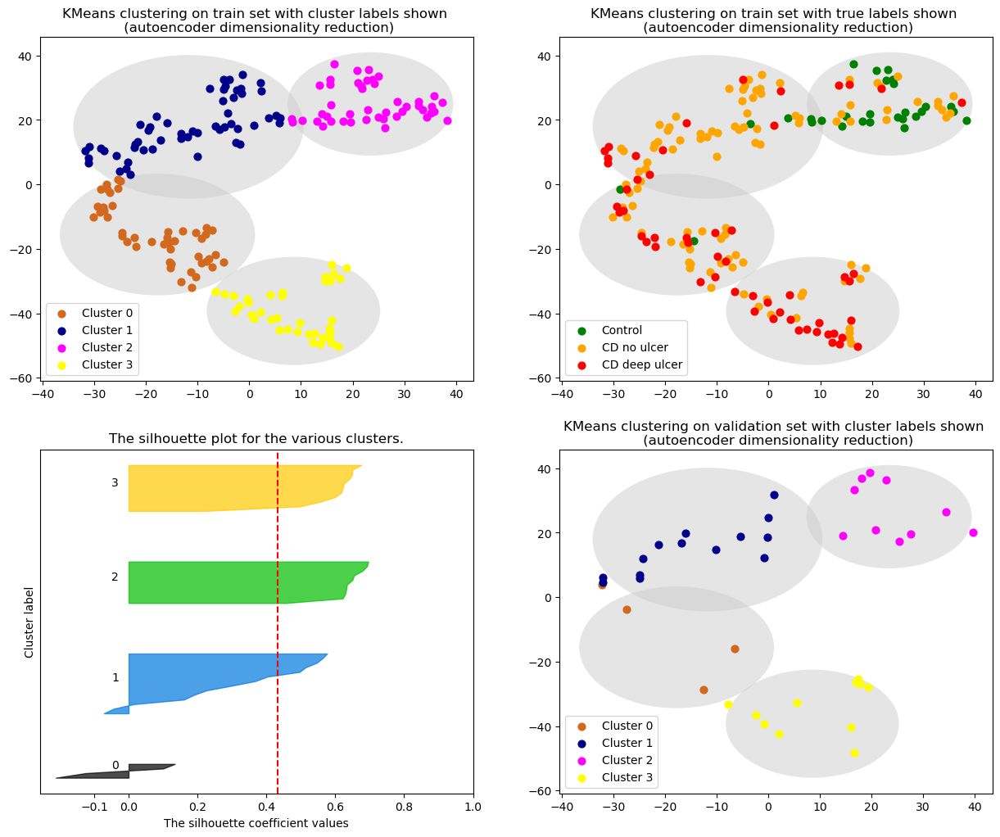

The average silhouette_score is : 0.43170527
Accuracy: 0.20512820512820512
F1 score: 0.2461538461538461


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


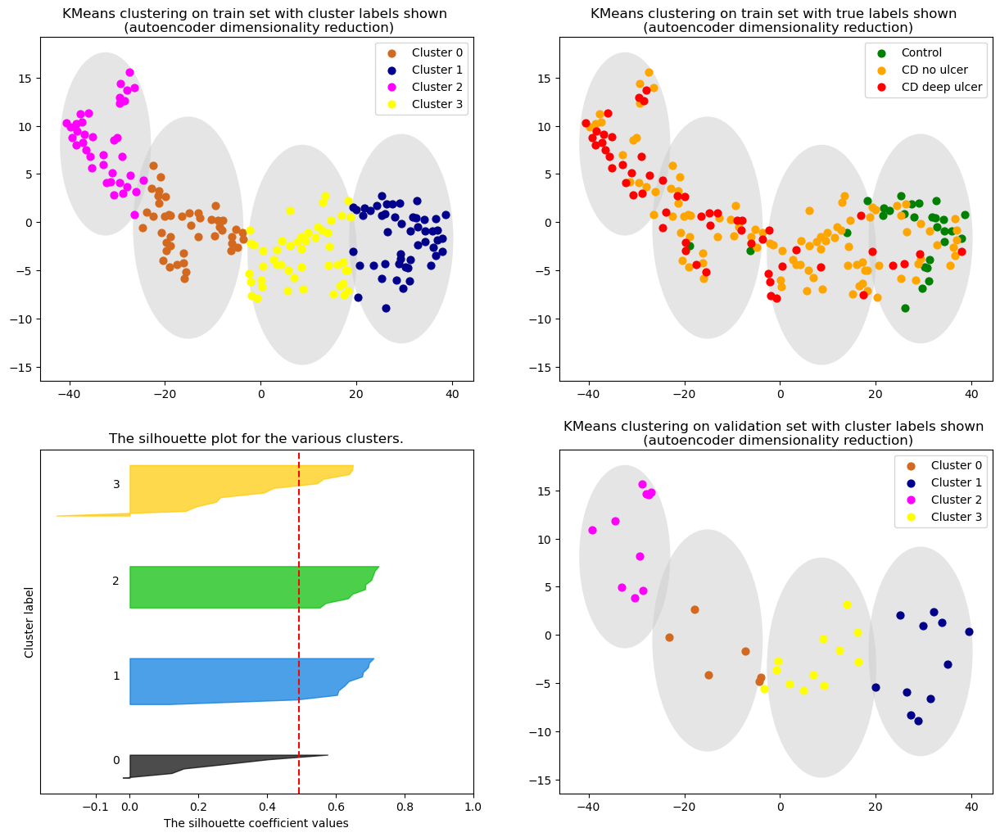

The average silhouette_score is : 0.49235183
Accuracy: 0.20512820512820512
F1 score: 0.23178137651821865


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


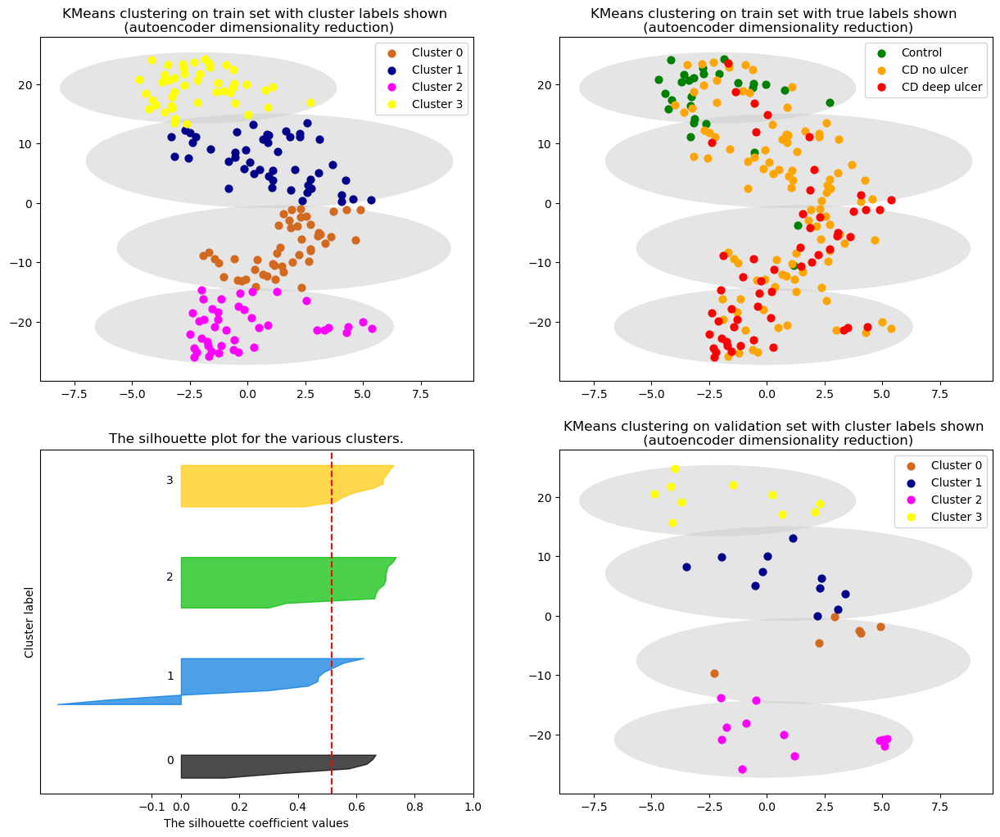

The average silhouette_score is : 0.51579446
Accuracy: 0.28205128205128205
F1 score: 0.31181318681318676


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


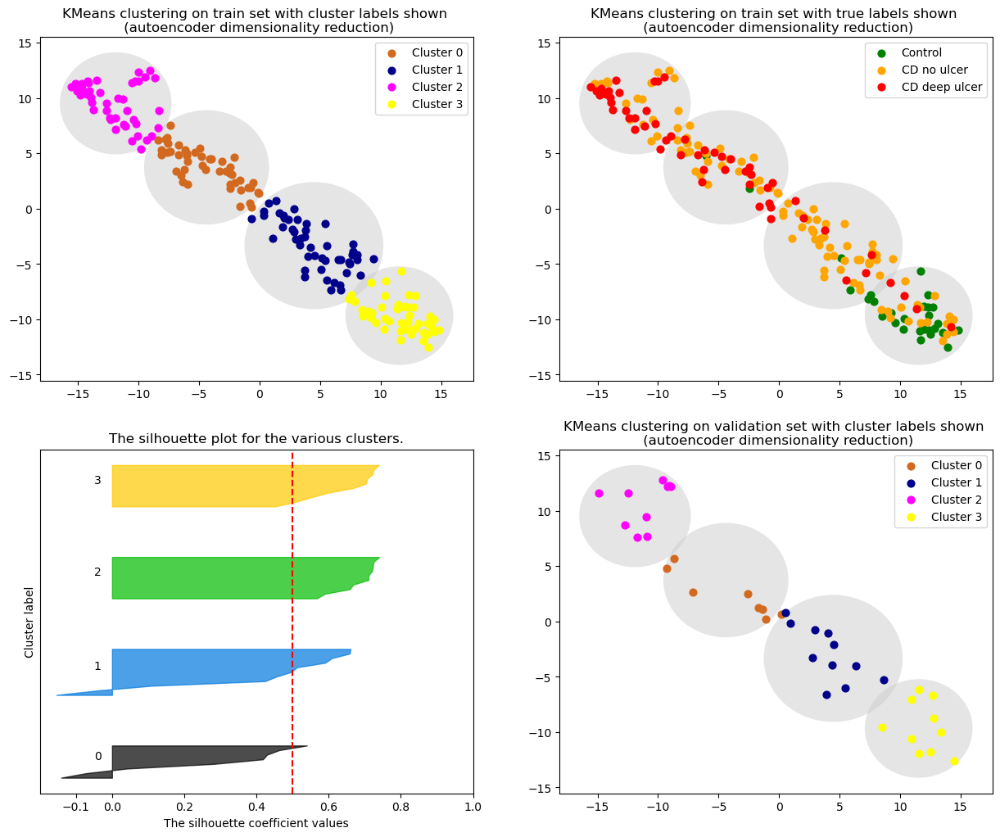

The average silhouette_score is : 0.49954063
Accuracy: 0.2564102564102564
F1 score: 0.2990890688259109


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


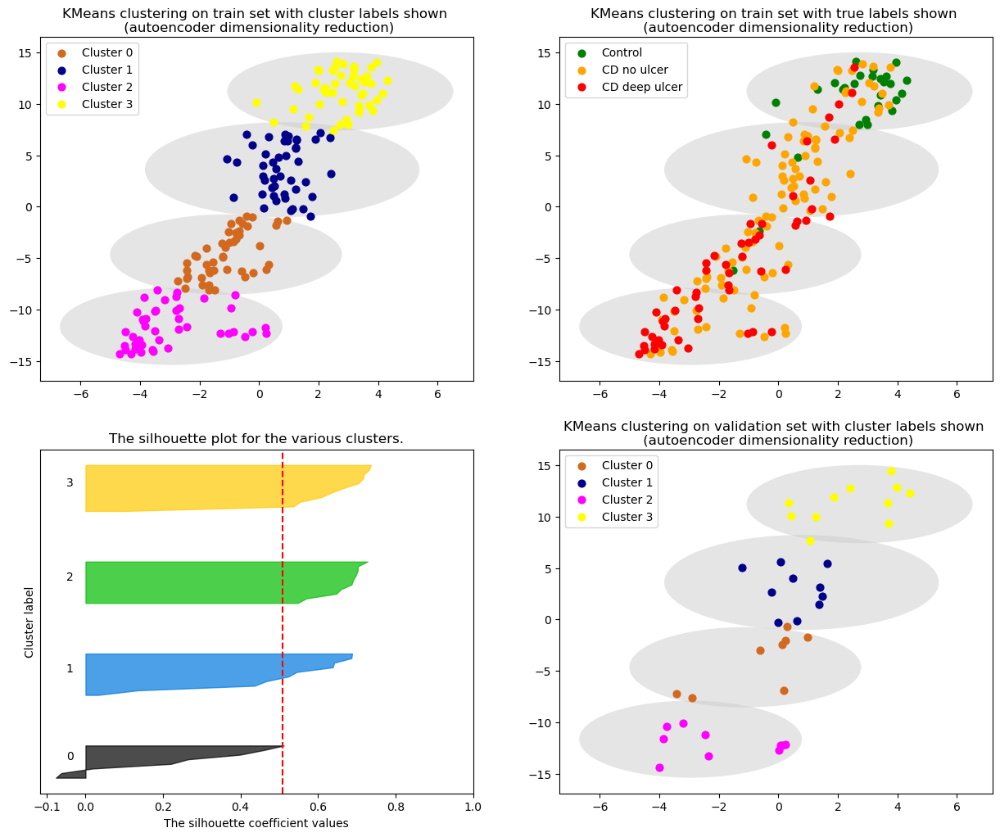

The average silhouette_score is : 0.50927305
Accuracy: 0.23076923076923078
F1 score: 0.27086326237429803


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


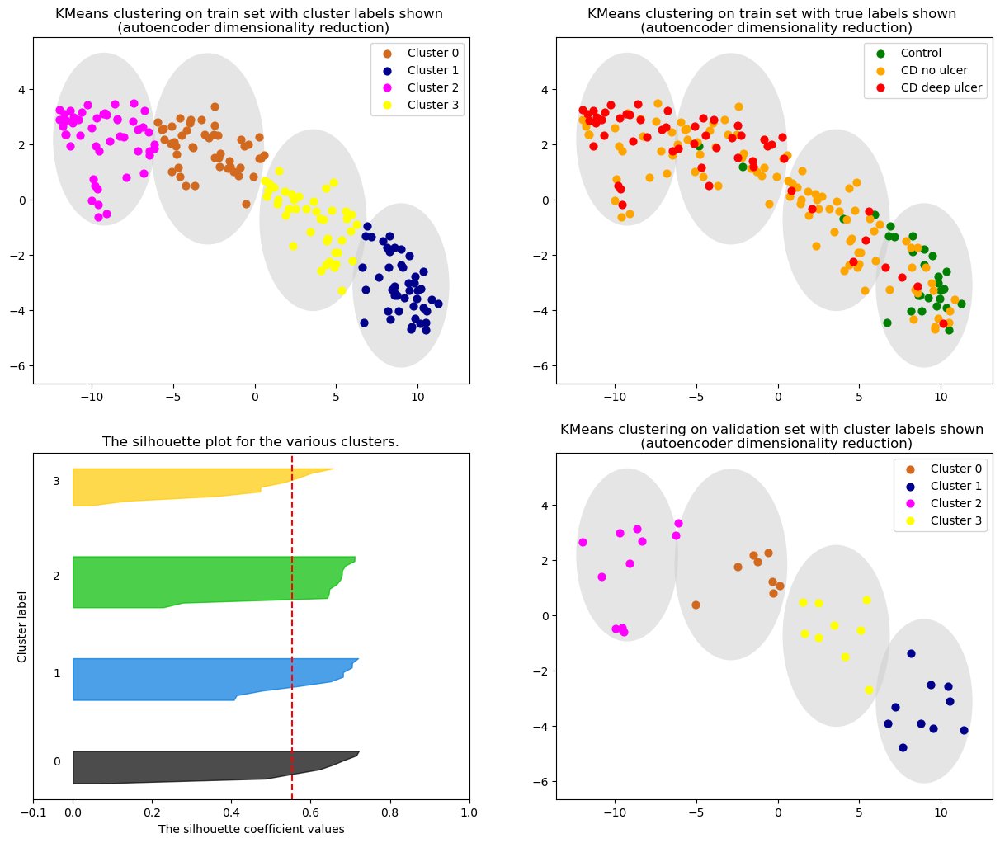

The average silhouette_score is : 0.5540726
Accuracy: 0.20512820512820512
F1 score: 0.21410847217298828


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


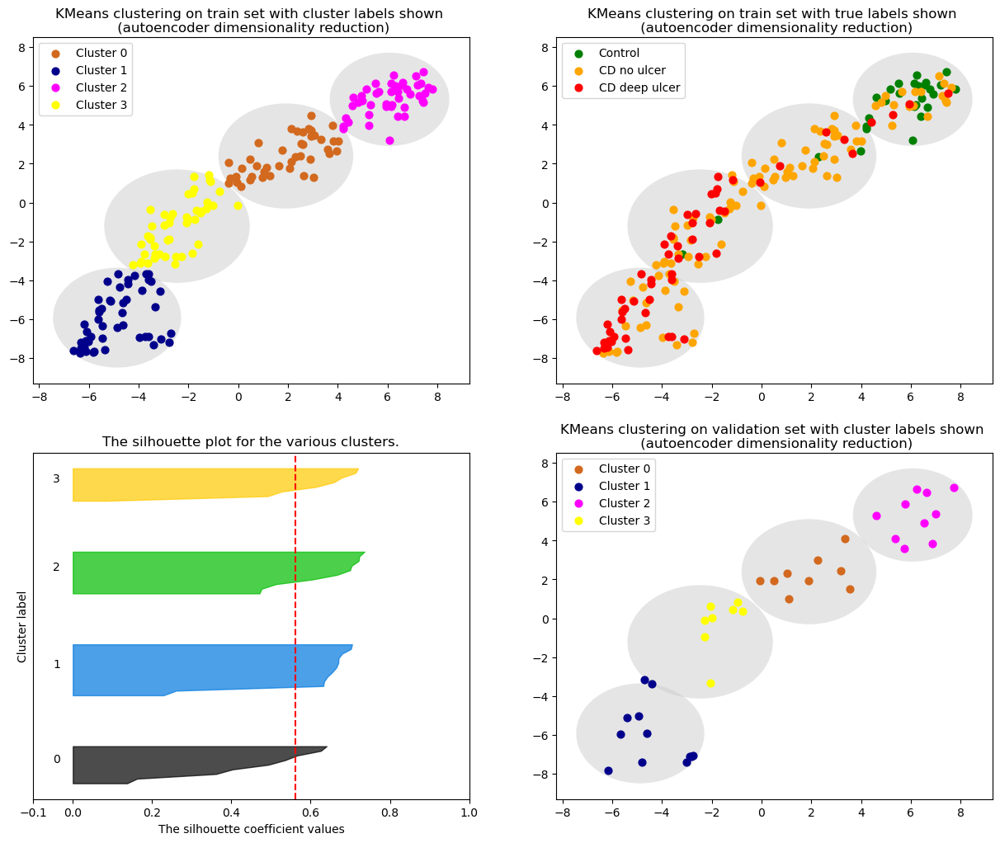

The average silhouette_score is : 0.5606946
Accuracy: 0.23076923076923078
F1 score: 0.2797202797202797


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


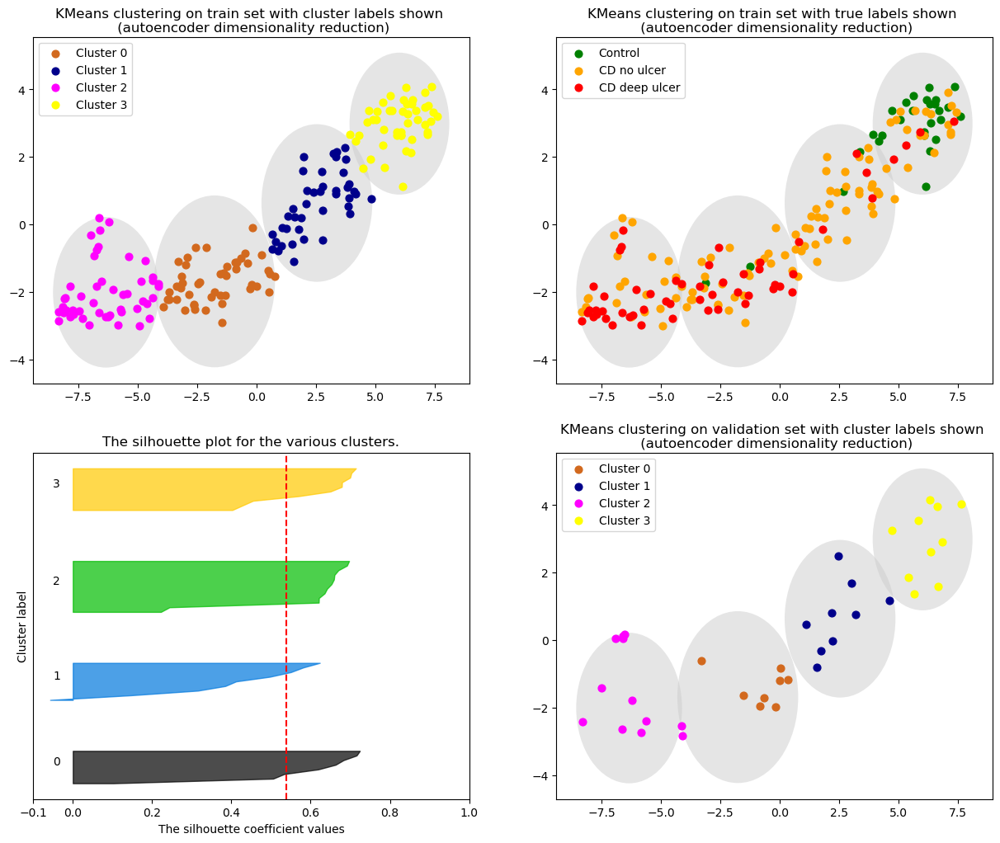

The average silhouette_score is : 0.53827775
Accuracy: 0.23076923076923078
F1 score: 0.25347985347985347


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


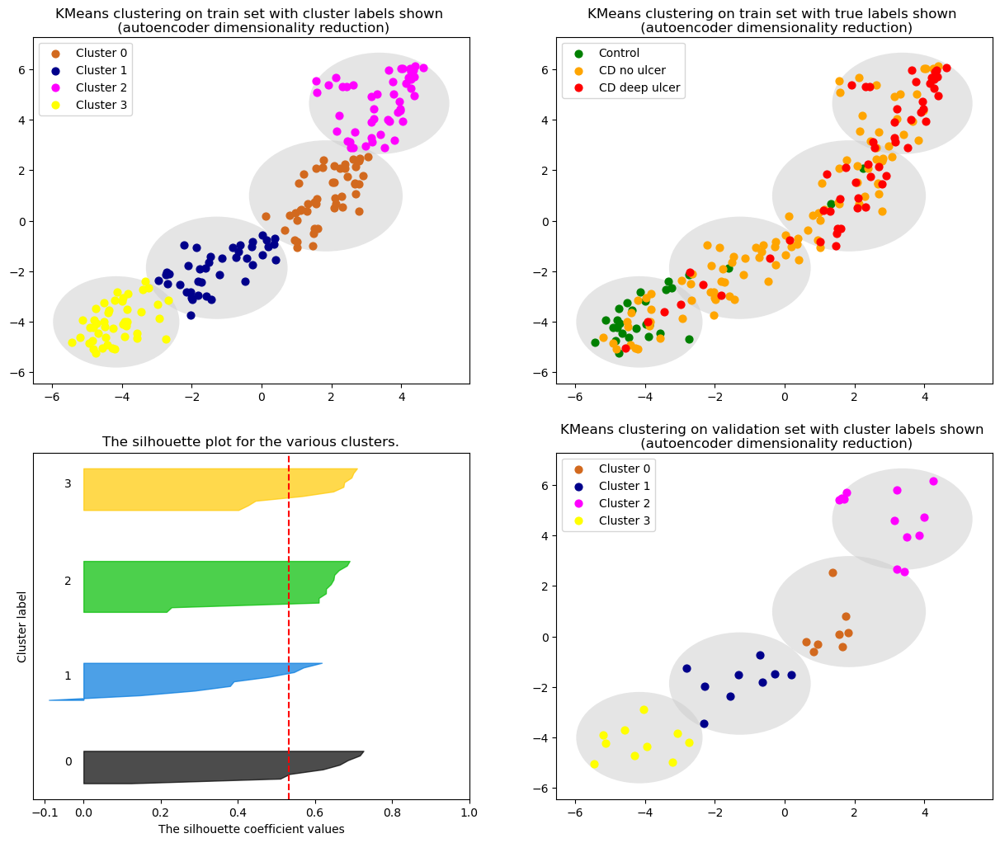

The average silhouette_score is : 0.5320089
Accuracy: 0.23076923076923078
F1 score: 0.25347985347985347


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


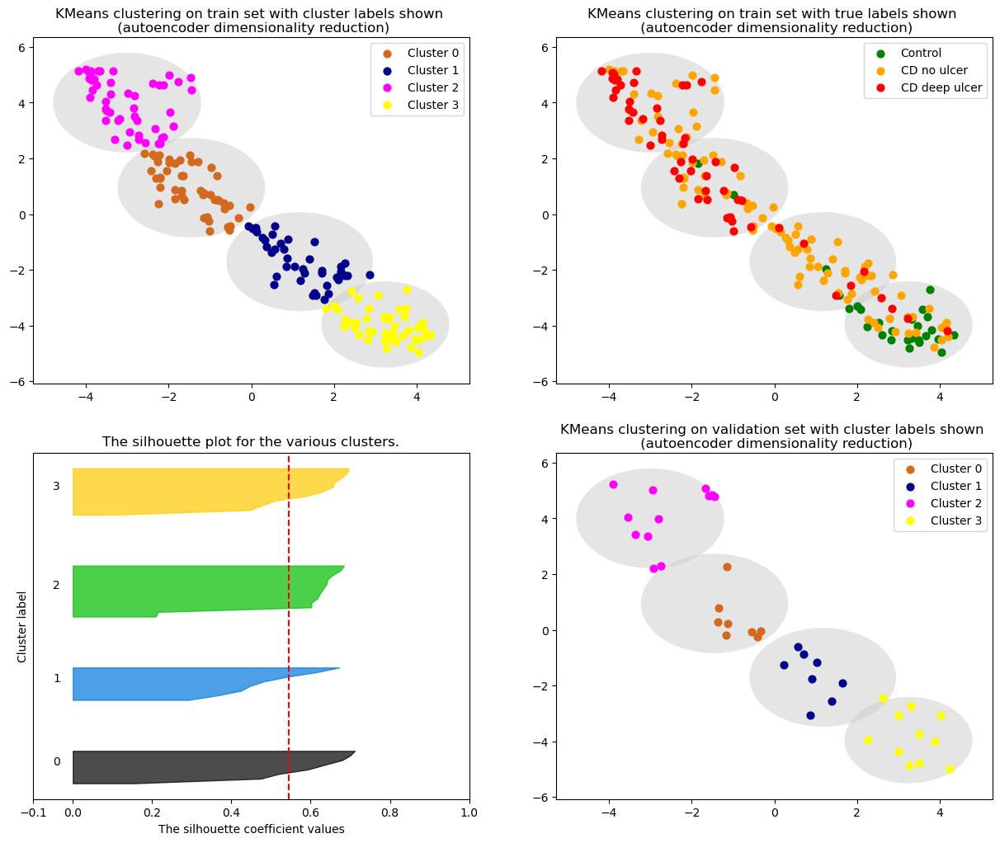

The average silhouette_score is : 0.54474837
Accuracy: 0.20512820512820512
F1 score: 0.22129594543387646


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


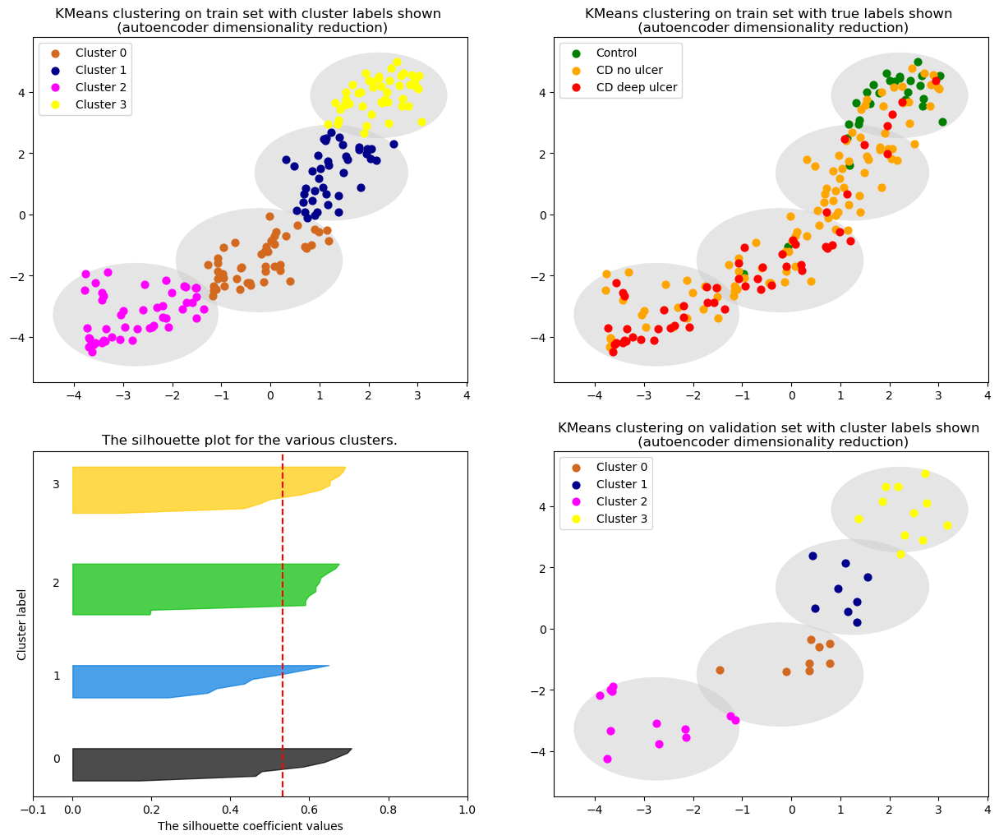

The average silhouette_score is : 0.5318938
Accuracy: 0.20512820512820512
F1 score: 0.22129594543387646


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


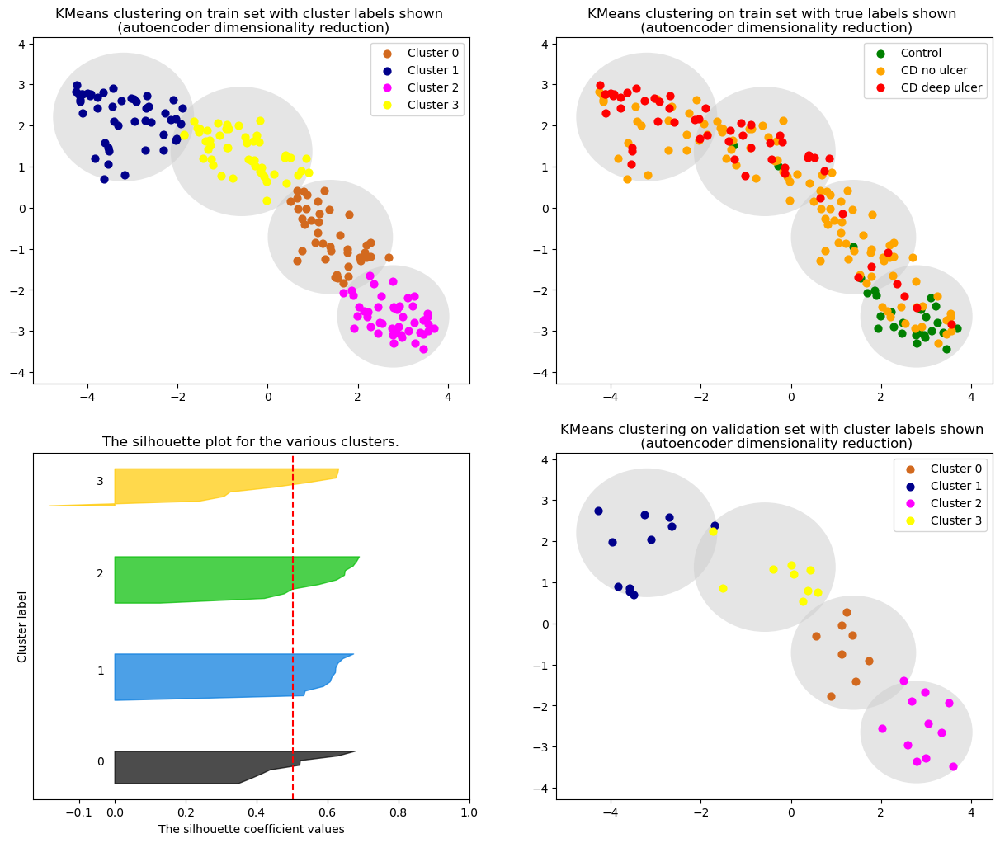

The average silhouette_score is : 0.50316954
Accuracy: 0.20512820512820512
F1 score: 0.25622171945701355


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


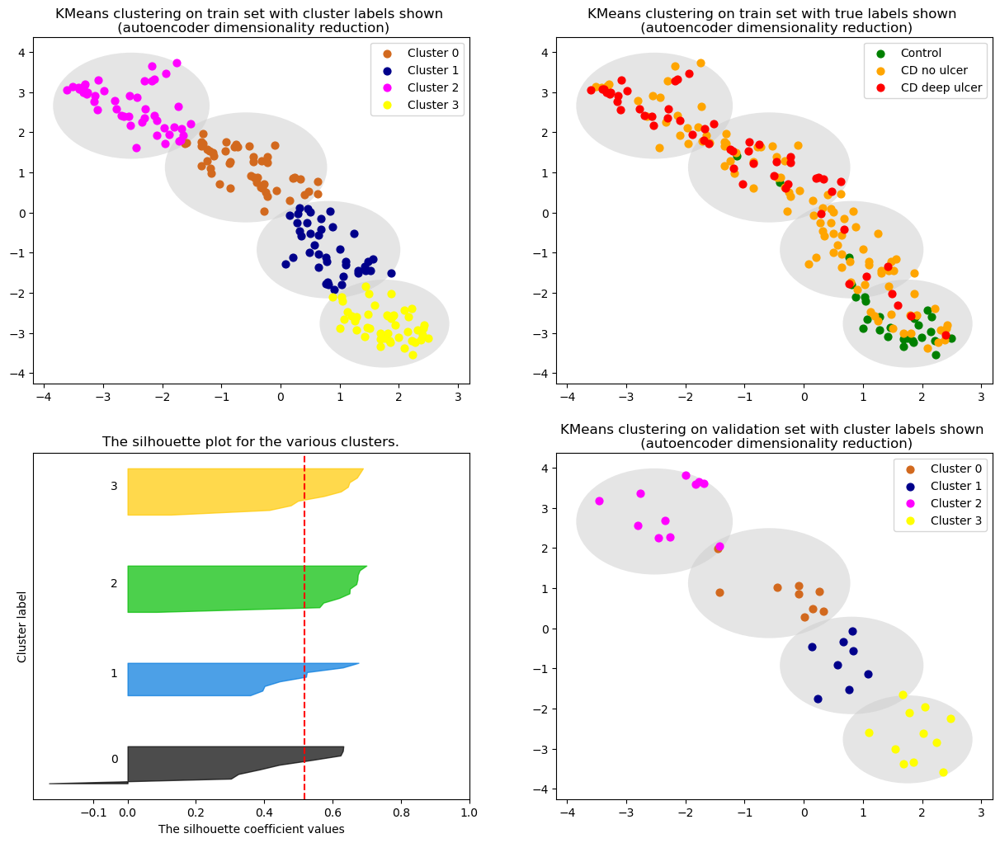

The average silhouette_score is : 0.5177246
Accuracy: 0.20512820512820512
F1 score: 0.22679045092838196


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


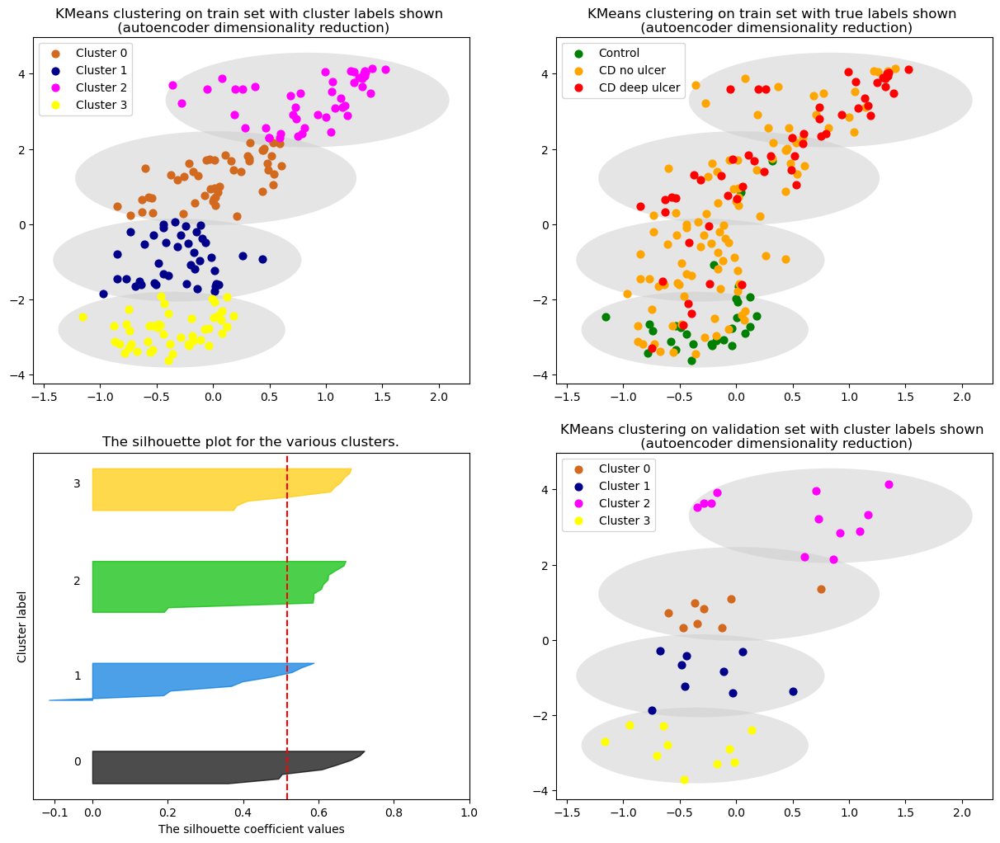

The average silhouette_score is : 0.5177737
Accuracy: 0.23076923076923078
F1 score: 0.25347985347985347


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


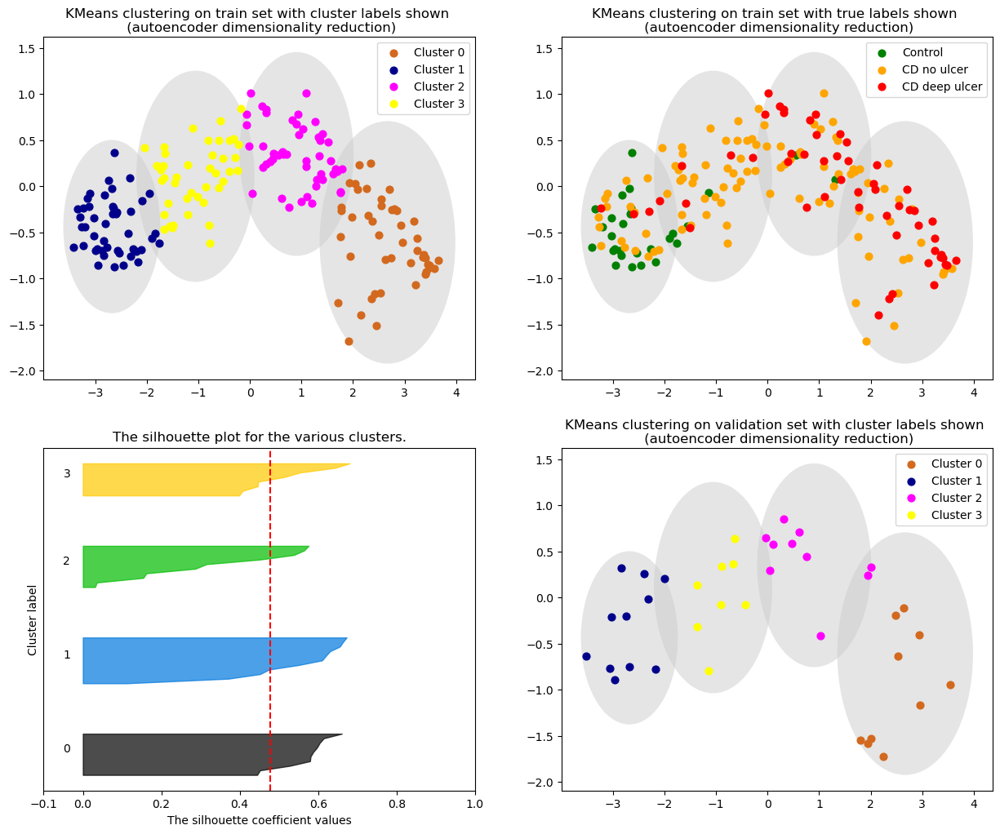

The average silhouette_score is : 0.47856614
Accuracy: 0.15384615384615385
F1 score: 0.18319838056680163


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


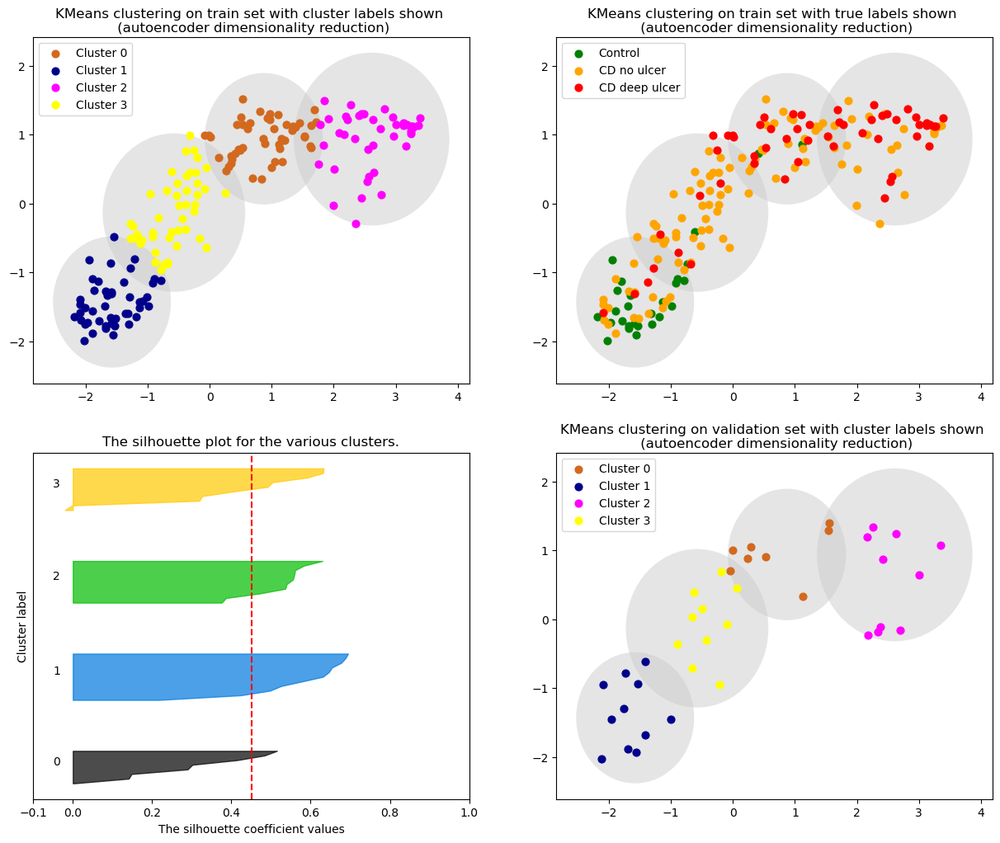

The average silhouette_score is : 0.4515342
Accuracy: 0.20512820512820512
F1 score: 0.23178137651821865


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


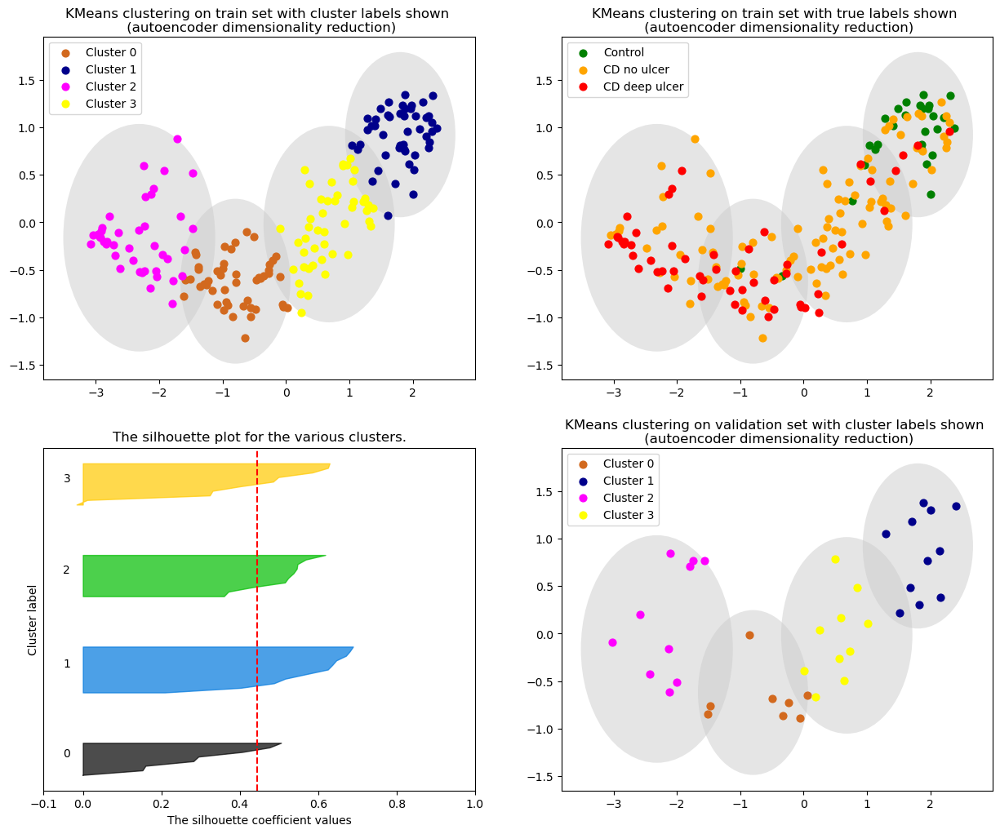

The average silhouette_score is : 0.44366243
Accuracy: 0.20512820512820512
F1 score: 0.23178137651821865


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


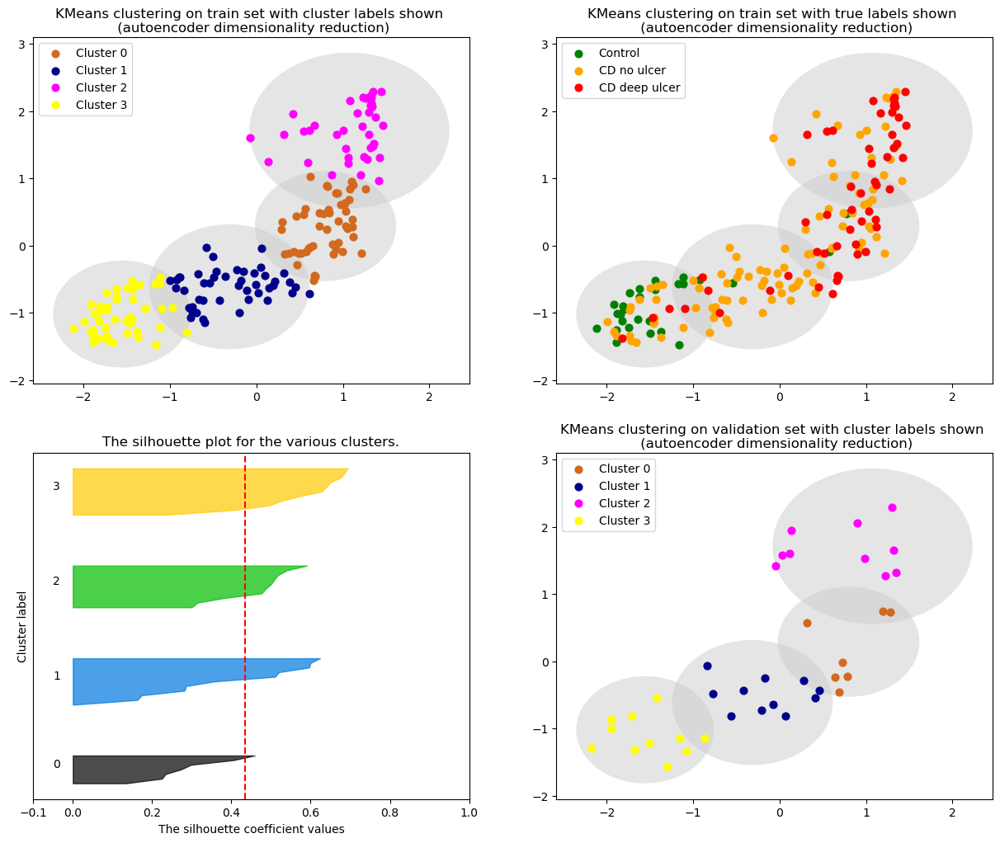

The average silhouette_score is : 0.43523377
Accuracy: 0.2564102564102564
F1 score: 0.2990890688259109


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


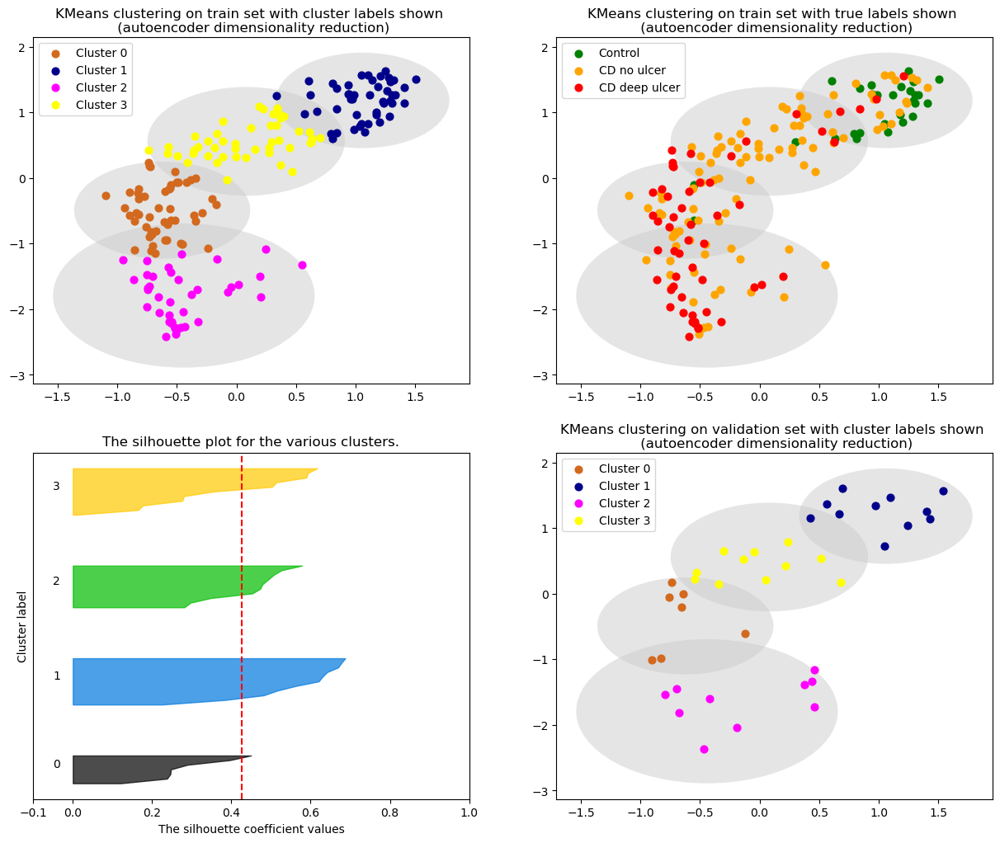

The average silhouette_score is : 0.4256778
Accuracy: 0.20512820512820512
F1 score: 0.23178137651821865


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


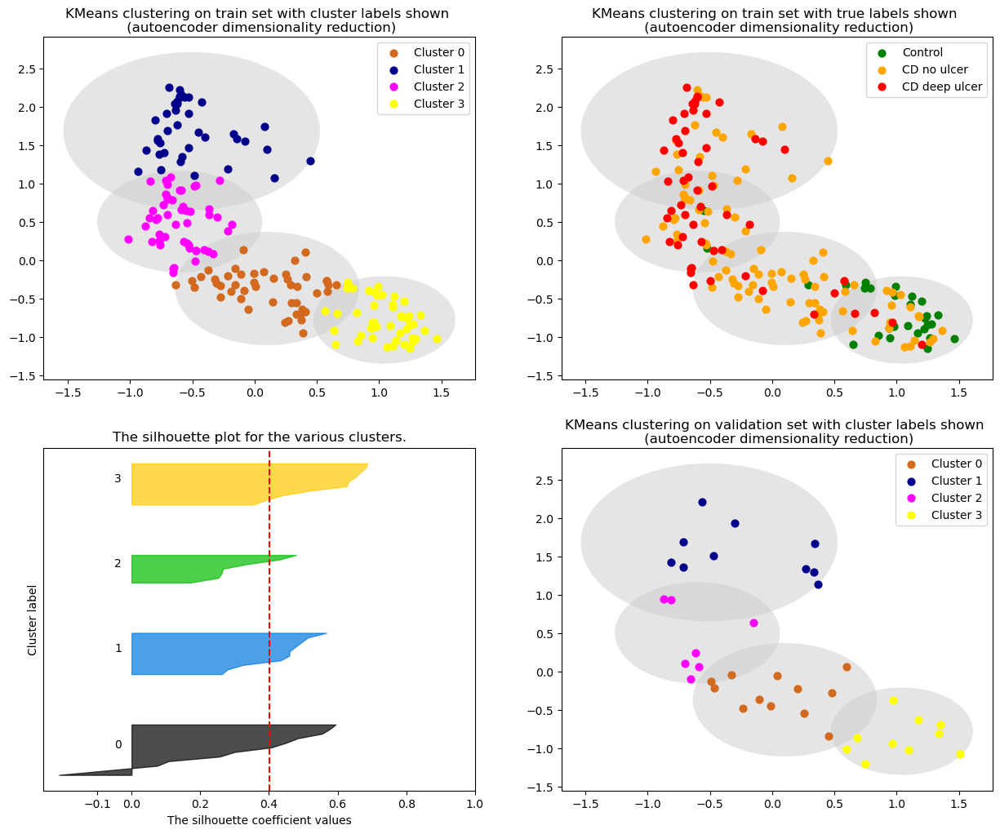

The average silhouette_score is : 0.40088812
Accuracy: 0.2564102564102564
F1 score: 0.3100850762141084


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


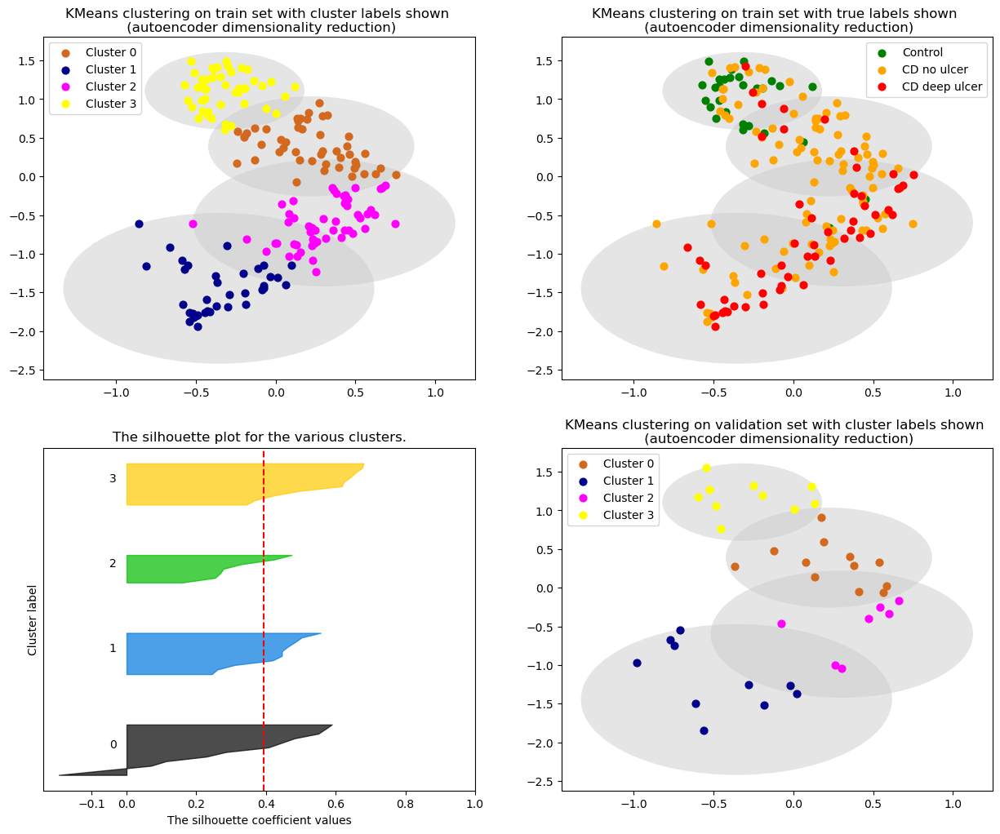

The average silhouette_score is : 0.39330176
Accuracy: 0.2564102564102564
F1 score: 0.3100850762141084


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


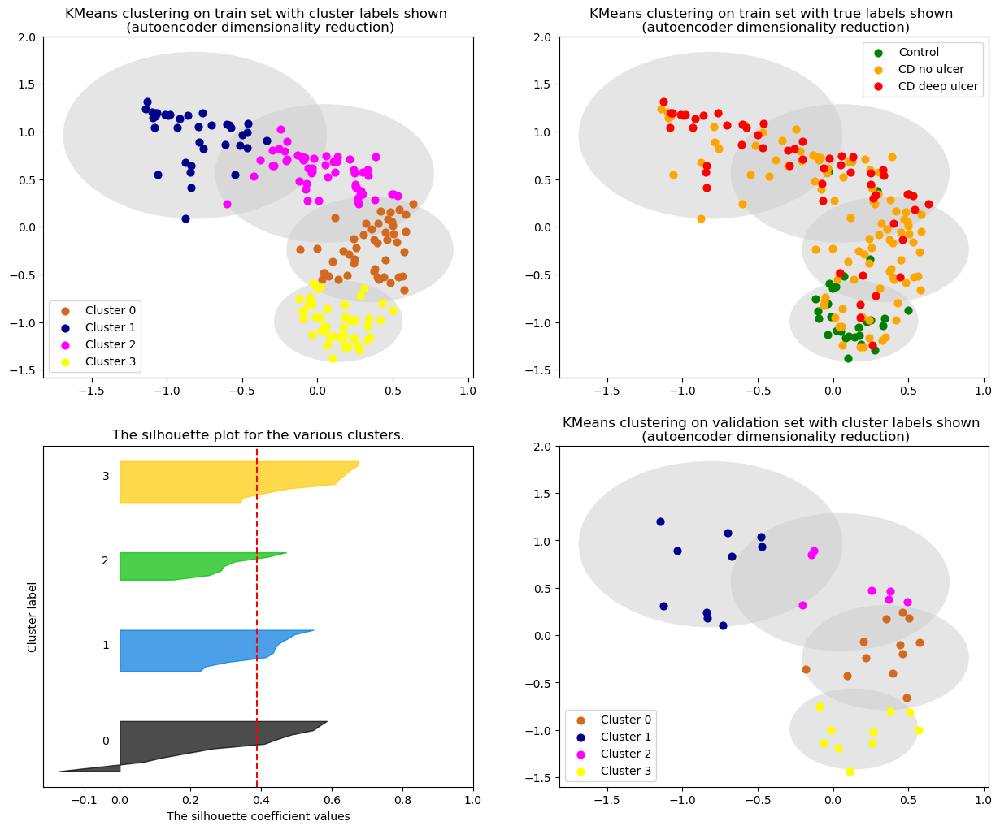

The average silhouette_score is : 0.3876916
Accuracy: 0.2564102564102564
F1 score: 0.3100850762141084


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


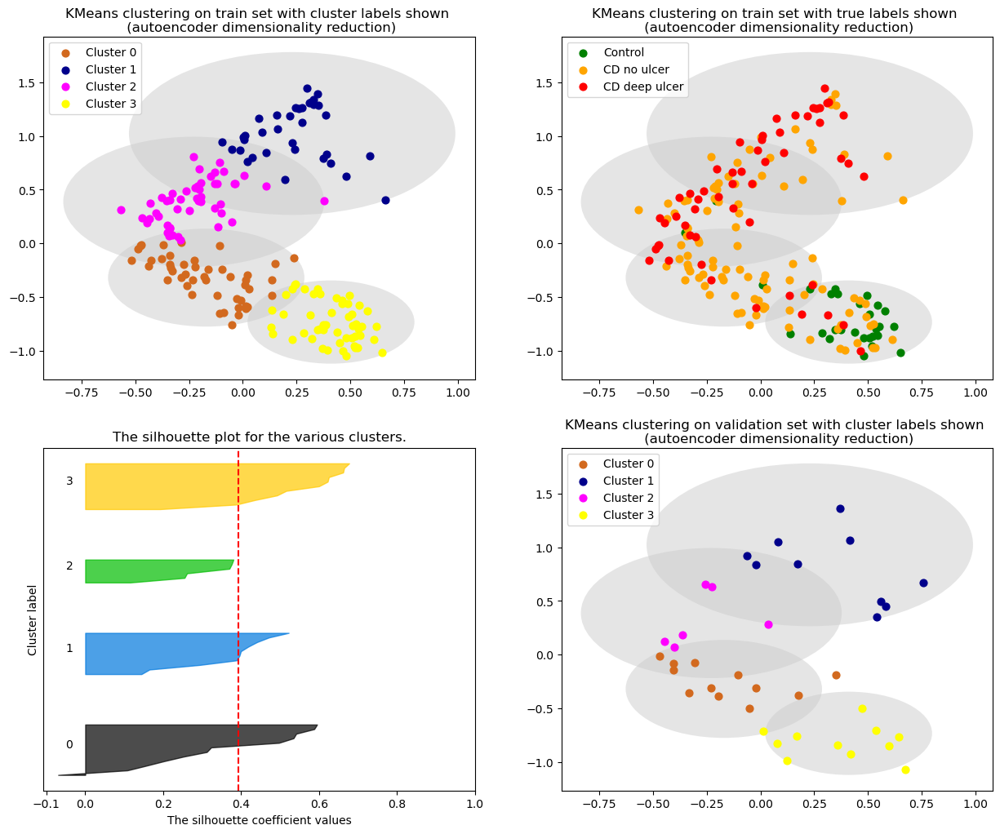

The average silhouette_score is : 0.3923918
Accuracy: 0.2564102564102564
F1 score: 0.31393123006026225


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


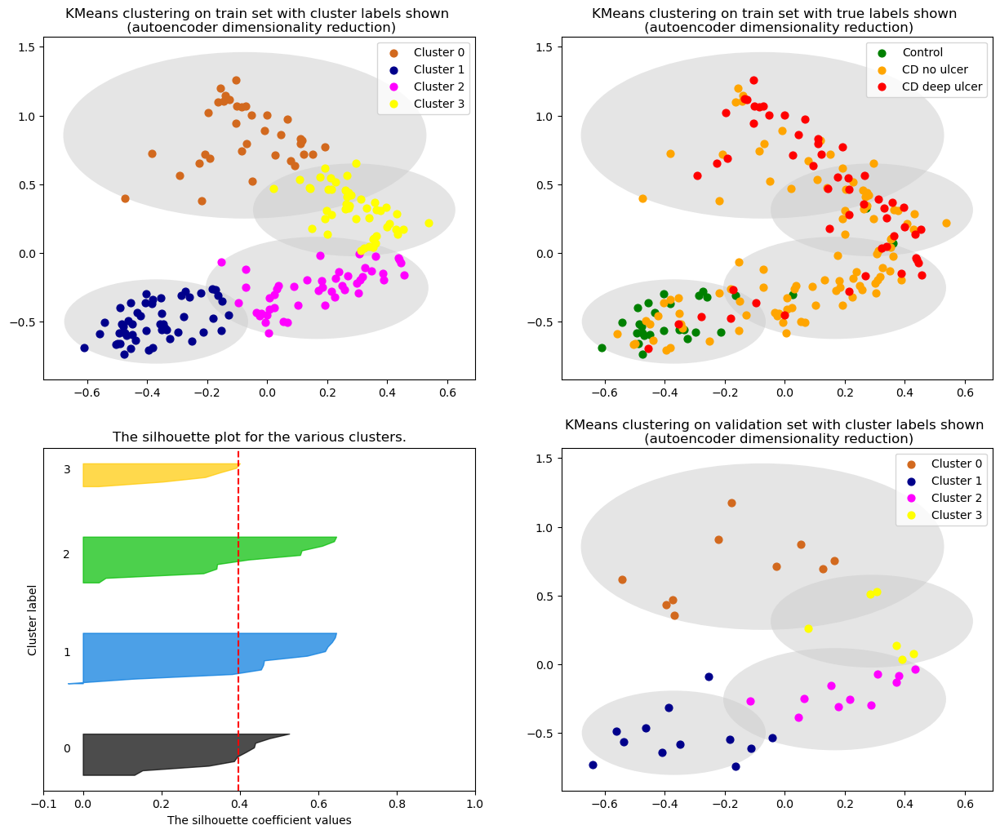

The average silhouette_score is : 0.39681885
Accuracy: 0.20512820512820512
F1 score: 0.23240093240093243


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


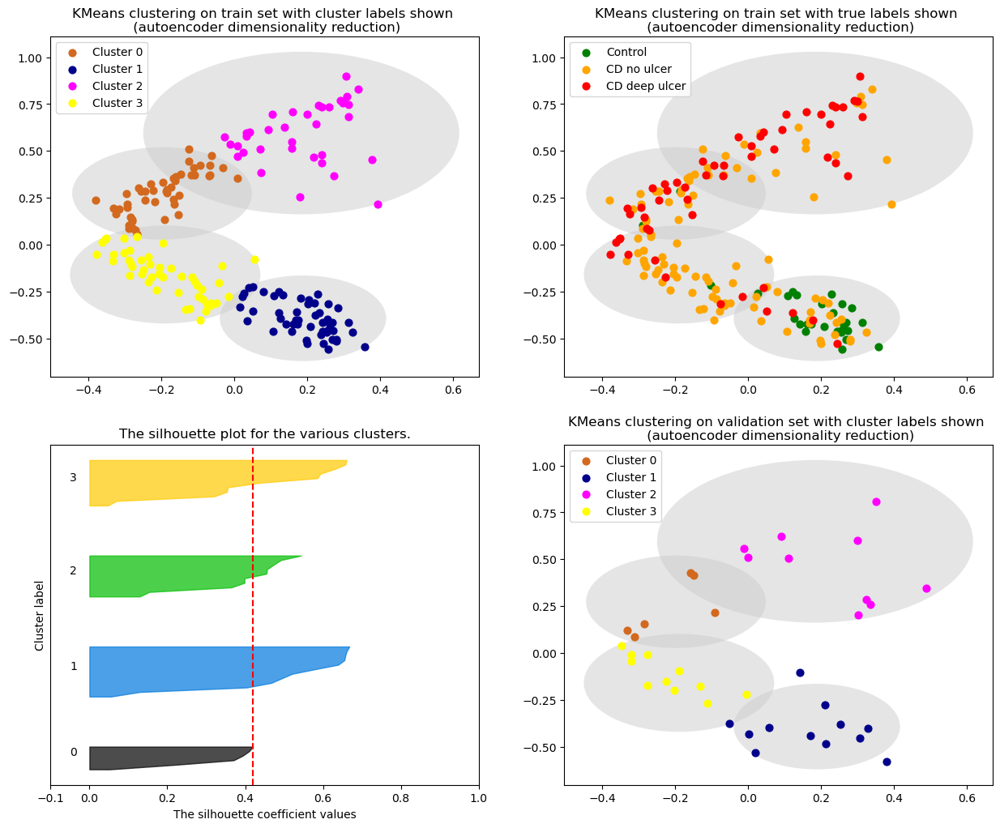

The average silhouette_score is : 0.41973954
Accuracy: 0.23076923076923078
F1 score: 0.2603361550729972


In [34]:
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_ae, X_train_ae, X_val_ae, X_test_ae, k_labels_train_ae, k_labels_val_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_ae, X_val_ae, train_disease_labels, val_disease_labels, k_labels_train_ae, k_labels_val_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]

# for perplexity in perplexities:
#     kmeans_ae, X_train_ae, X_test_ae, k_labels_train_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
#     print("Perplexity =",perplexity)
#     plot_kmeans(X_train_ae, train_disease_labels, k_labels_train_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)

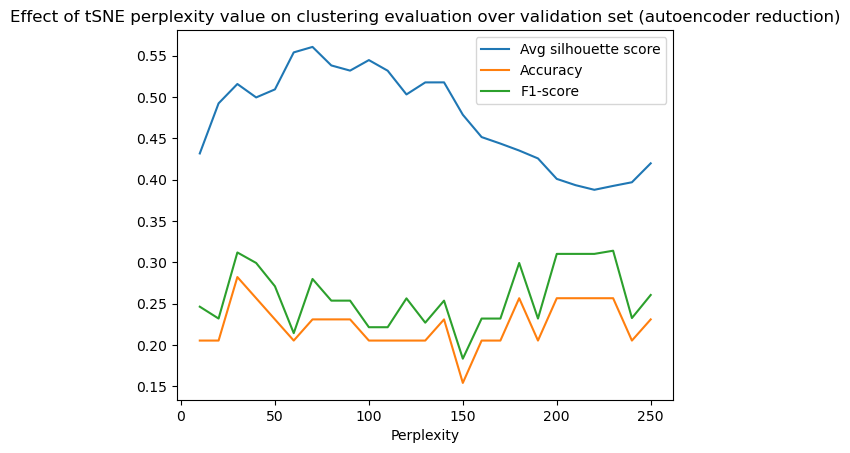

In [35]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


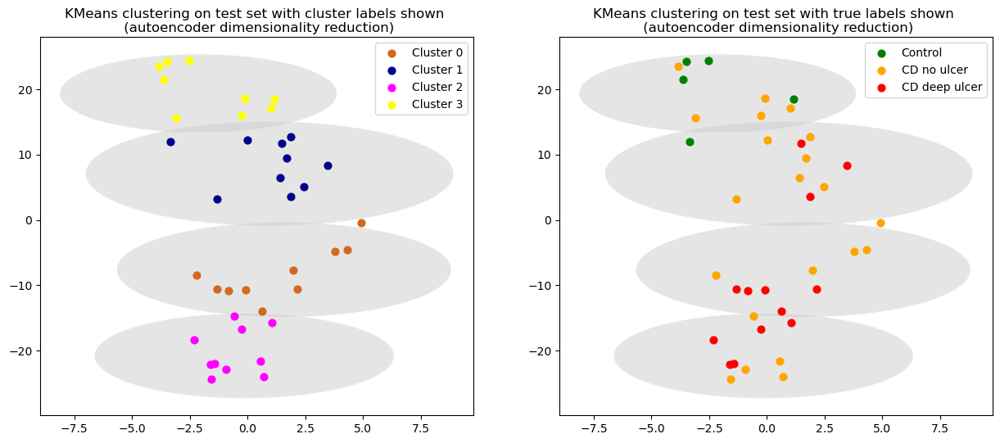

In [36]:
# plot with chosen tsne perplexity
perplexity = 30
kmeans_ae, X_train_ae, _, X_test_ae, k_labels_train_ae, _, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_ae, None, test_disease_labels, None, k_labels_test_ae, None, centers_ae, radii_ae, "autoencoder", test_set=True)


## Process KMeans models

In [37]:
def pair_repeat(dup, cls_assignments, num_c, amounts):
    all_clusters = np.arange(num_c)
    # replace one of the duplicates with max of remaining clusters
    replace_class = np.where(cls_assignments == dup[0])[0][0]
    rem_cluster_a, rem_cluster_b = np.setdiff1d(all_clusters,cls_assignments)
    # rem_cluster_b
    if amounts[replace_class][rem_cluster_a] > amounts[replace_class][rem_cluster_b]:
        cls_assignments[replace_class] = rem_cluster_a
    else:
        cls_assignments[replace_class] = rem_cluster_b
        
    return cls_assignments

def handle_duplicates(cls_assignments, dup, c, num_c, amounts):
#     print("c:",c)
    if len(c) != 1:
        
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)
    else: # 3 repeats of same thing
        # reassign class least associated to next most associated cluster
        given_cluster = dup[0]
        cls_least = np.argmin(amounts[:,given_cluster])
#         print(cls_least)
        class_amounts = amounts[cls_least,:]
        class_amounts[given_cluster] = -1
        next_cluster = np.argmax(class_amounts)
        cls_assignments[cls_least] = next_cluster
#         print("intermediate assignments",cls_assignments)
        
        # handle other duplicate pair
        u, c = np.unique(cls_assignments, return_counts=True)
        dup = u[c > 1]
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)

    return cls_assignments


def softmax(x): 
    return np.exp(x)/sum(np.exp(x))

In [38]:

    
def process_clusters(amounts, X_train, num_c):
    all_clusters = np.arange(num_c)

    
    cls_assignments = np.argmax(amounts, axis=1) # assigned to class 0, 1, 2
#     print("initial cls assignments:",cls_assignments)
    
    # check for and handle duplicates
    u, c = np.unique(cls_assignments, return_counts=True)
    dup = u[c > 1]
#     print("dup:",dup[0])
    if len(dup) > 0:
        cls_assignments = handle_duplicates(cls_assignments, dup, c, num_c, amounts)
        
            
    class_assignment_amounts = np.max(amounts, axis=1) 
    
    assignments = [None] * 3
    
    assigned = 0
    while assigned < num_c - 1:
        curr_max_class = np.argmax(class_assignment_amounts)
        assigned_cluster = cls_assignments[curr_max_class]
        if assignments[curr_max_class] is None:
            assignments[curr_max_class] = [assigned_cluster]
        else:
            assignments[curr_max_class].append(assigned_cluster)
        class_assignment_amounts[curr_max_class] = -1
        assigned += 1

    # Assign remaining cluster
    
    rem_cluster = np.setdiff1d(all_clusters,cls_assignments)[0]
    
    rem_cls_assignment = np.argmax(amounts[:,rem_cluster], axis=0)
    assignments[rem_cls_assignment].append(rem_cluster)
    couple = assignments[rem_cls_assignment]
    # clusters assigned to disease class 0, 1, 2 (control, CD_no_ulcer, CD_deep_ulcer)
    
#     print(assignments)
#     print(couple)
    return assignments, couple

In [39]:
def get_class_from_label(label, couple, assignments):
    if label in couple:
        search_term = couple
    else:
        search_term = [label]
    try:
        cls = assignments.index(search_term)
    except:
        return None
    return cls


In [40]:
def get_final_clusters(assignments, couple, labels):
    test_set_clusters = []
    for label in labels:
        cls = get_class_from_label(label, couple, assignments)
        test_set_clusters.append(cls)

    test_set_clusters = np.array(test_set_clusters)
    return test_set_clusters

In [41]:
# centers = kmeans.cluster_centers_
# centers

In [42]:
num_c = 4

In [43]:
def get_count_matrix_km(kmeans, X_train, train_disease_labels):

    
    # make matrix to record number of each class in each cluster
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    centers = kmeans.cluster_centers_
    for c, cls in enumerate(classes):
        for pt in X_train[train_disease_labels==c]:
            pt = pt.reshape(1,-1)
            distances = cdist(centers, pt, 'euclidean')
            closest_cluster = np.argmin(distances)
            amounts[c][closest_cluster] += 1
    

#     print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts

In [44]:
# get_count_matrix_km(kmeans, X_train, train_disease_labels)

### Apply resulting models to test sets

In [45]:
centers_pca

array([[ 0.18335666, -0.10309477],
       [ 1.8896939 ,  0.25121906],
       [-2.686631  ,  0.28736538],
       [-1.5258081 , -0.26360777]], dtype=float32)

In [46]:
km_labels_list = [k_labels_test_ae, k_labels_test_pca]
km_models_list = [kmeans_ae, kmeans_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]
centers_list = [centers_ae, centers_pca]
radii_list = [radii_ae, radii_pca]


In [47]:
# X_test_ae

In [48]:
def compute_metrics(X, true_labels, clus_labels):
    silhouette_avg, sample_silhouette_values = compute_silh_scores(X, clus_labels)
    acc = accuracy_score(true_labels, clus_labels)
    f1 = f1_score(true_labels, clus_labels, average='weighted')
#     print("The average silhouette_score is :",silhouette_avg)
#     print("Accuracy:",acc)
#     print("F1 score:",f1)
    
    return silhouette_avg, sample_silhouette_values, acc, f1

def print_scores(s_avgs, accs, f1_scores):
    typ = ["Autoencoder","PCA"]
    for i in range(len(accs)):
        print(typ[i]+":")
        print("Average silhouette score:",s_avgs[i])
        print("Accuracy:",accs[i])
        print("F1 score:",f1_scores[i])

C:\Users\shard\AppData\Local\Temp\ipykernel_11712\2391998775.py:46: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


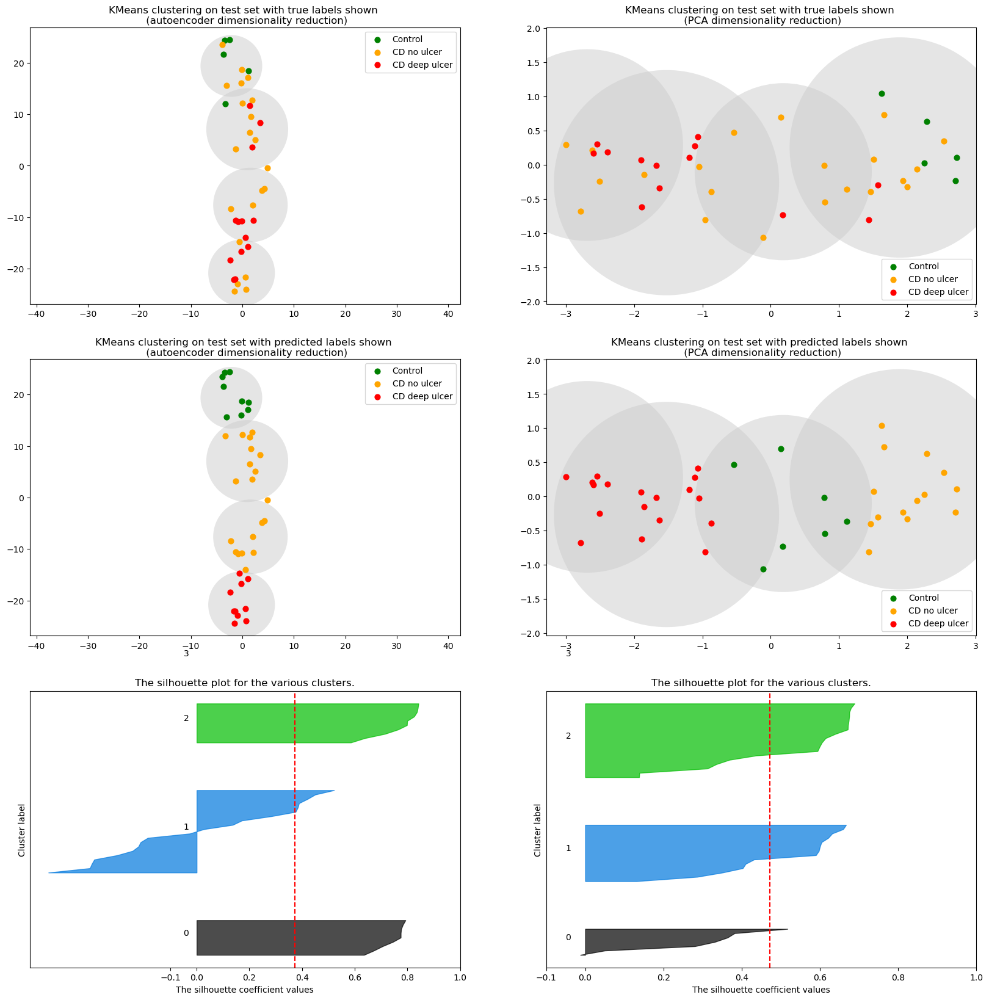

Autoencoder:
Average silhouette score: 0.3722369
Accuracy: 0.5128205128205128
F1 score: 0.4273504273504273
PCA:
Average silhouette score: 0.47224092
Accuracy: 0.717948717948718
F1 score: 0.6389743589743591


In [49]:
def plot_final_km_models(labels_list, models_list, train_set_list, test_set_list, centers_list, radii_list, num_c):

    (fig, subplots) = plt.subplots(3, 2, figsize=(20,20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(models_list)):
    #         print(i)
            ax = subplots[t][i]
            km = models_list[i]
            km_labels = labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
            centers = centers_list[i]
            radii = radii_list[i]
            if t > 0:
                amounts = get_count_matrix_km(km, X_train, train_disease_labels)
                assignments, couple = process_clusters(amounts, X_train, num_c)
                test_set_clusters = get_final_clusters(assignments, couple, km_labels)
                final_clusters_lst.append(test_set_clusters)
            else:
                test_set_clusters = test_disease_labels
    #         print("gmmlabels:",gmm_labels)
    #         print("tsclusters:",test_set_clusters)
    #         print("asgn:",assignments)
            

#             if t > 0:
#                 test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
#                 final_clusters_lst.append(test_set_clusters)
#                 final_probs_lst.append(probs)
#             else:
#                 test_set_clusters = test_disease_labels


            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on test set with "+label+" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            for c, r in zip(centers, radii):
                ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

            ax.legend()

    s_avgs = []
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]
        true_labels = labels_list[j]
#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, true_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)

    
    return final_clusters_lst
        
final_clusters_ae, final_clusters_pca = plot_final_km_models(km_labels_list, km_models_list, train_set_list, test_set_list, centers_list, radii_list, num_c)

In [50]:
final_clusters_ae

array([2, 2, 0, 1, 2, 0, 2, 1, 0, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1,
       0, 1, 1, 2, 0, 1, 0, 0, 2, 2, 1, 1, 0, 1, 2, 0, 1])

## Gaussian Mixture Models

In [51]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html

from matplotlib.patches import Ellipse
from sklearn import mixture

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, X_val, true_labels, reduction, num_c=3, test=False, plot_sil=False):
    
    
    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    

    gmm_labels = gmm.predict(X)
#     (fig, subplots) = plt.subplots(1, 2, figsize=(15, 6))
#     ax = ax or plt.gca()
    labels = [gmm_labels, true_labels]
    num_clusters = 3
    dset = "test" if test else "train"
    for i, label_set in enumerate(labels):
        ax = subplots[0][i] if plot_sil else subplots[i]
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                        wrap=True)
            
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

        ax.axis('equal')
        

        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
        ax.legend()
        
        
    if plot_sil:
        gmm_val_labels = gmm.predict(X_val)
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, gmm_val_labels)
        plot_silhouette(num_c, gmm_val_labels, sample_silhouette_values, silhouette_avg, subplots[1][0])
#         subplots[1][1].axis('off')
        acc = accuracy_score(val_disease_labels, gmm_val_labels)
        f1 = f1_score(val_disease_labels, gmm_val_labels, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
    
    plt.show()
    
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        
        
    return gmm_labels

        
# def get_tsne_ds_true_labels():
#     tsne = manifold.TSNE(
#         n_components=2,
#         init="random",
#         random_state=0,
#         perplexity=24,
#         n_iter=750,
#         method='exact'
#     )
#     X = tsne.fit_transform(test_set)

In [52]:
# gmm.means_
# gmm.covariances_
# gmm.weights_

### Fit GMM with PCA dimensionality reduction

#### Training

In [53]:
num_c = 4

def fit_gmm(full_dataset, perplexity, num_c):
    gmm = mixture.GaussianMixture(n_components=num_c,covariance_type='full', random_state=42)
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    split_pt = int(0.7*len(full_dataset))
    split_pt_val = int(0.85*len(full_dataset))
    X_test = X[split_pt_val:]
    X_train = X[:split_pt]
    X_val = X[split_pt:split_pt_val]
    gmm.fit(X_train)
    
    return gmm, X_train, X_test, X_val

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 10


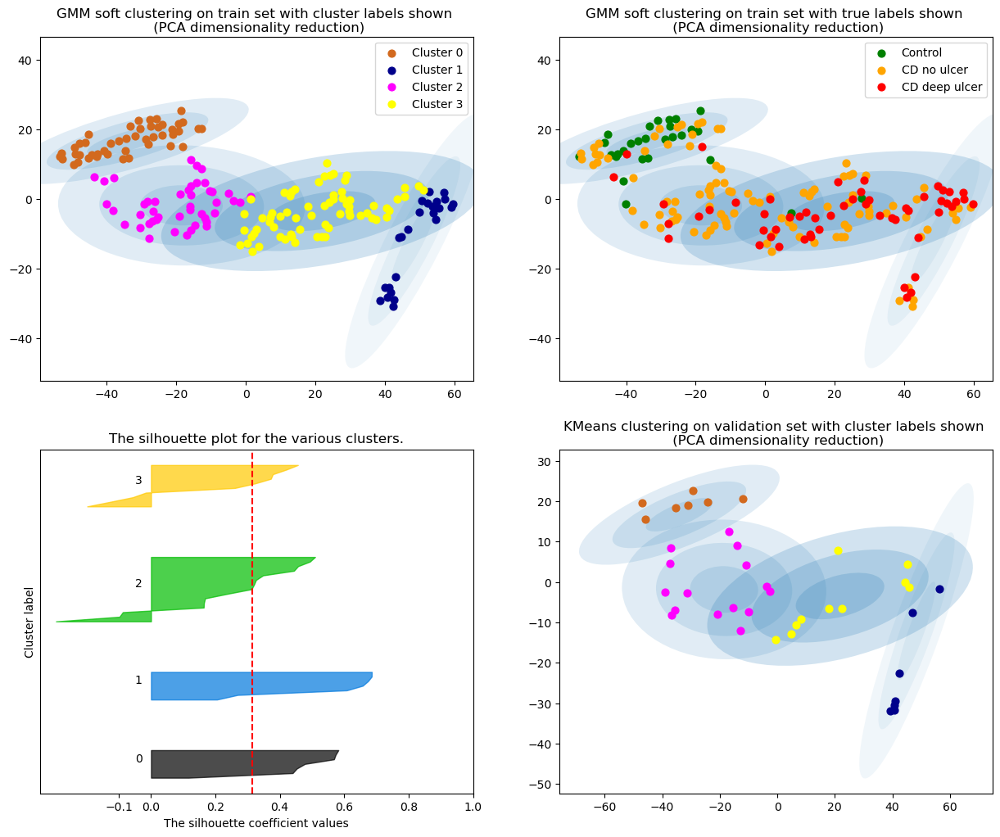

The average silhouette_score is : 0.3146488
Accuracy: 0.3333333333333333
F1 score: 0.3942307692307692


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 20


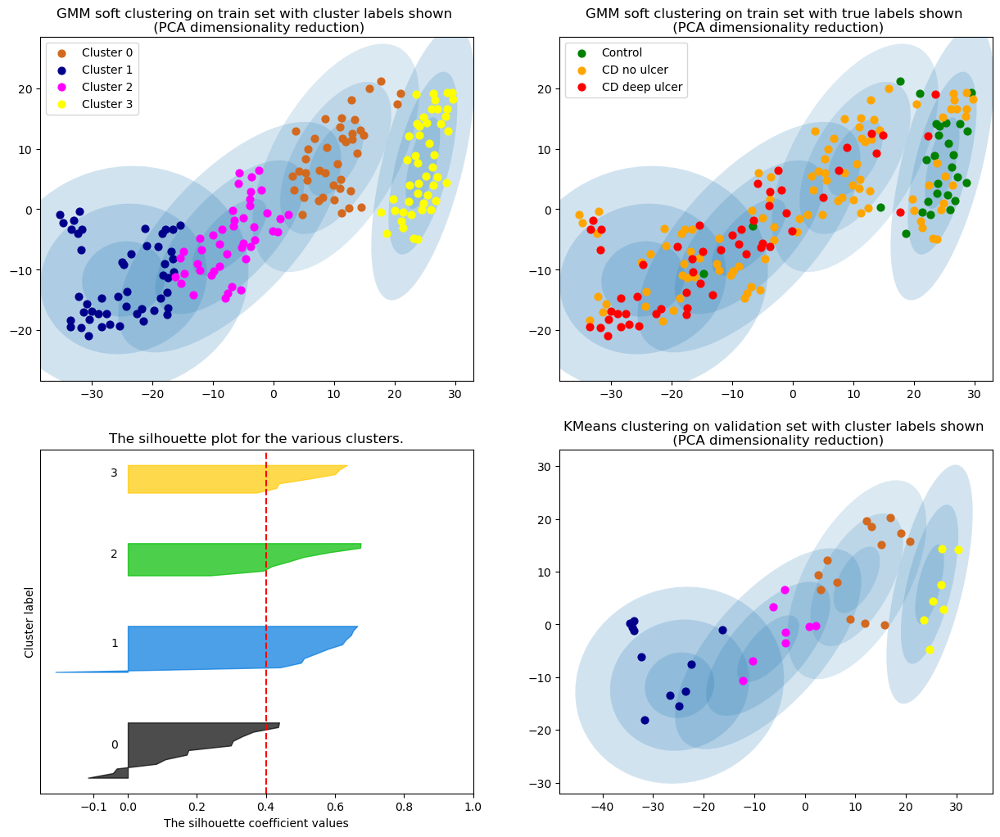

The average silhouette_score is : 0.40174764
Accuracy: 0.3333333333333333
F1 score: 0.3737916495269436


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 30


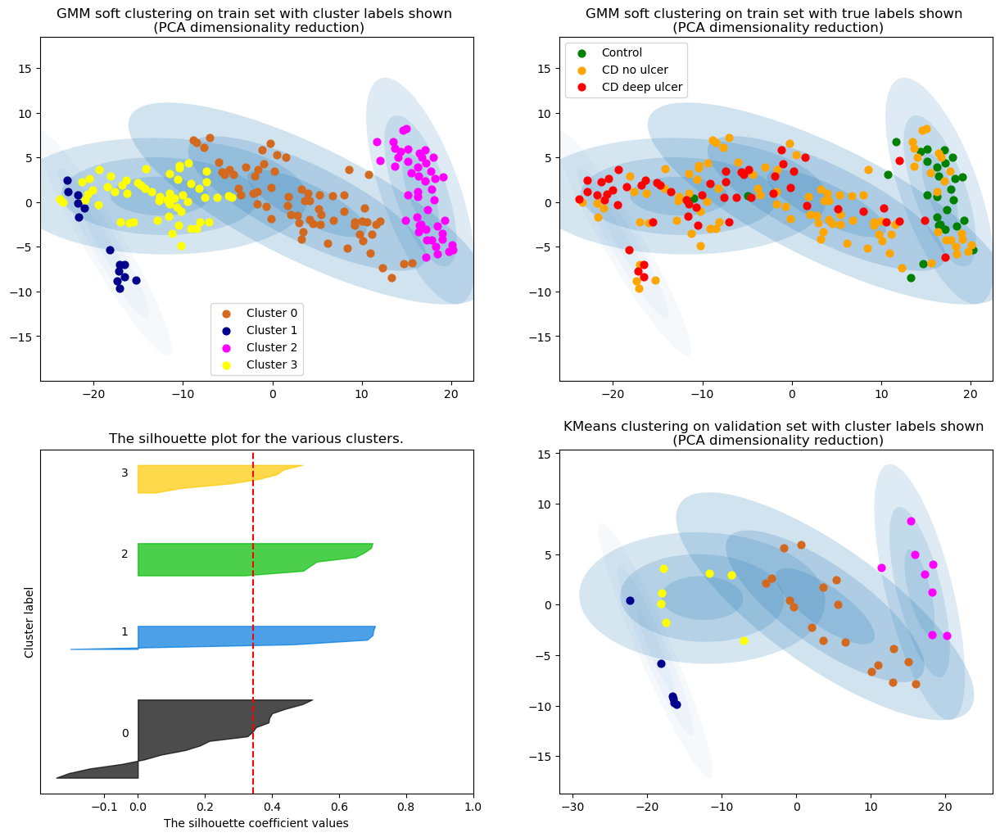

The average silhouette_score is : 0.3448237
Accuracy: 0.23076923076923078
F1 score: 0.2678062678062678


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 40


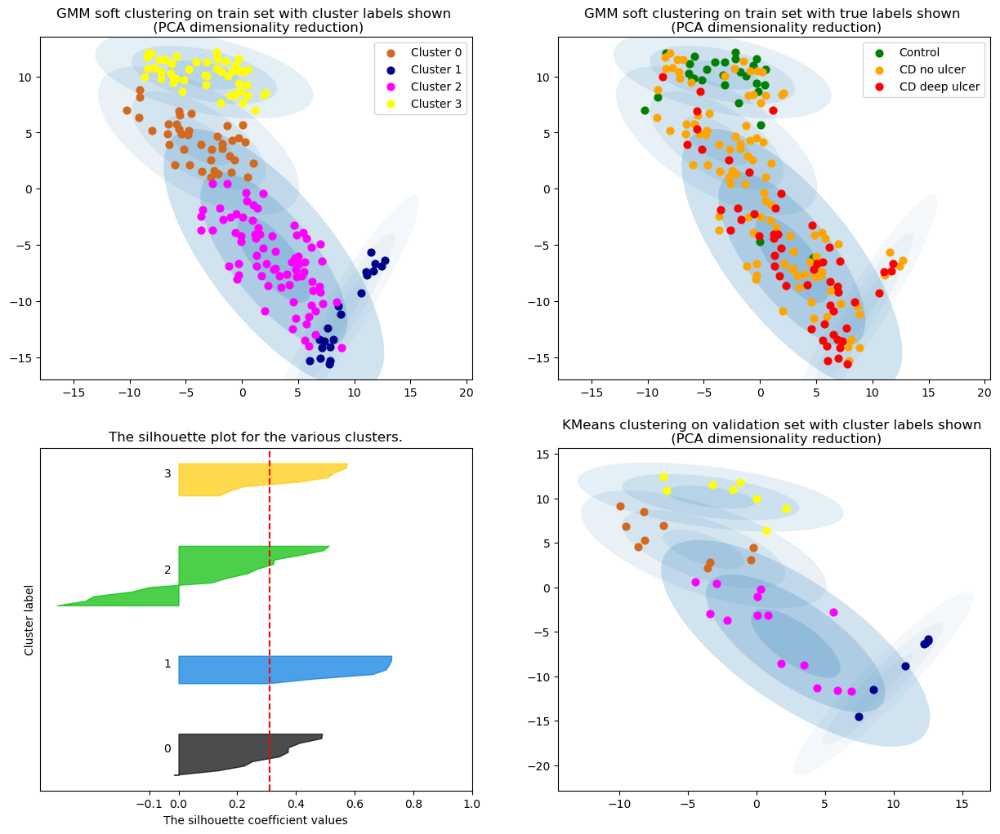

The average silhouette_score is : 0.30931708
Accuracy: 0.358974358974359
F1 score: 0.38980813237106143


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 50


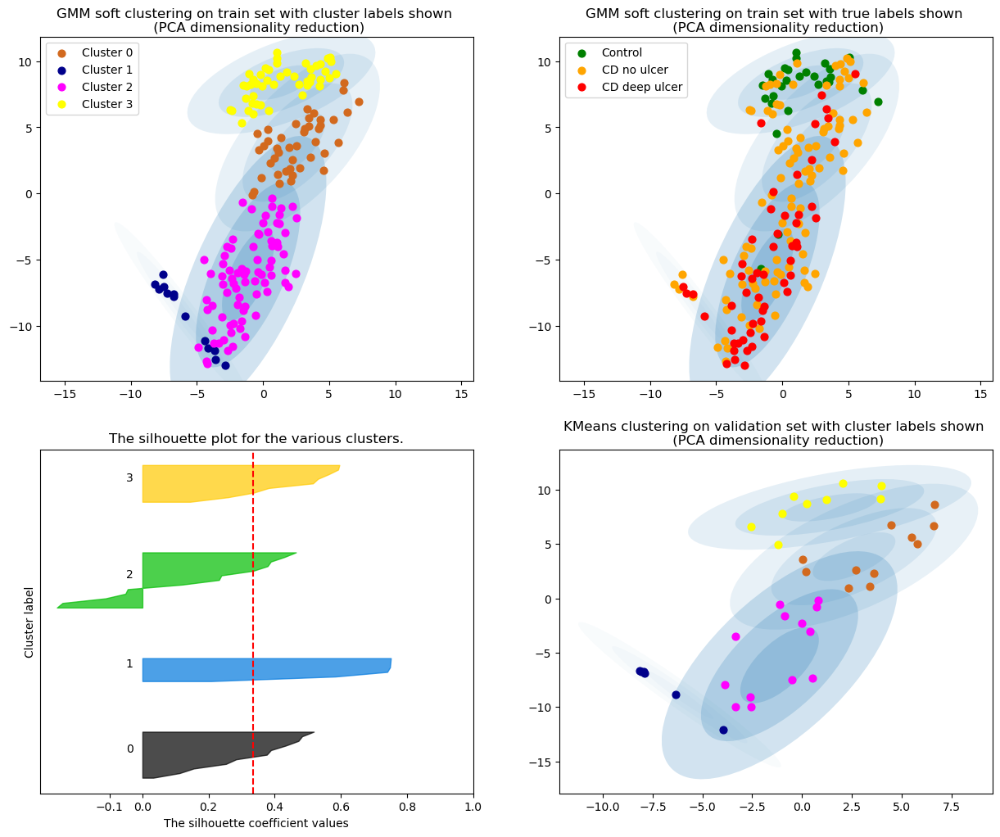

The average silhouette_score is : 0.33571422
Accuracy: 0.3333333333333333
F1 score: 0.37355607355607356


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 60


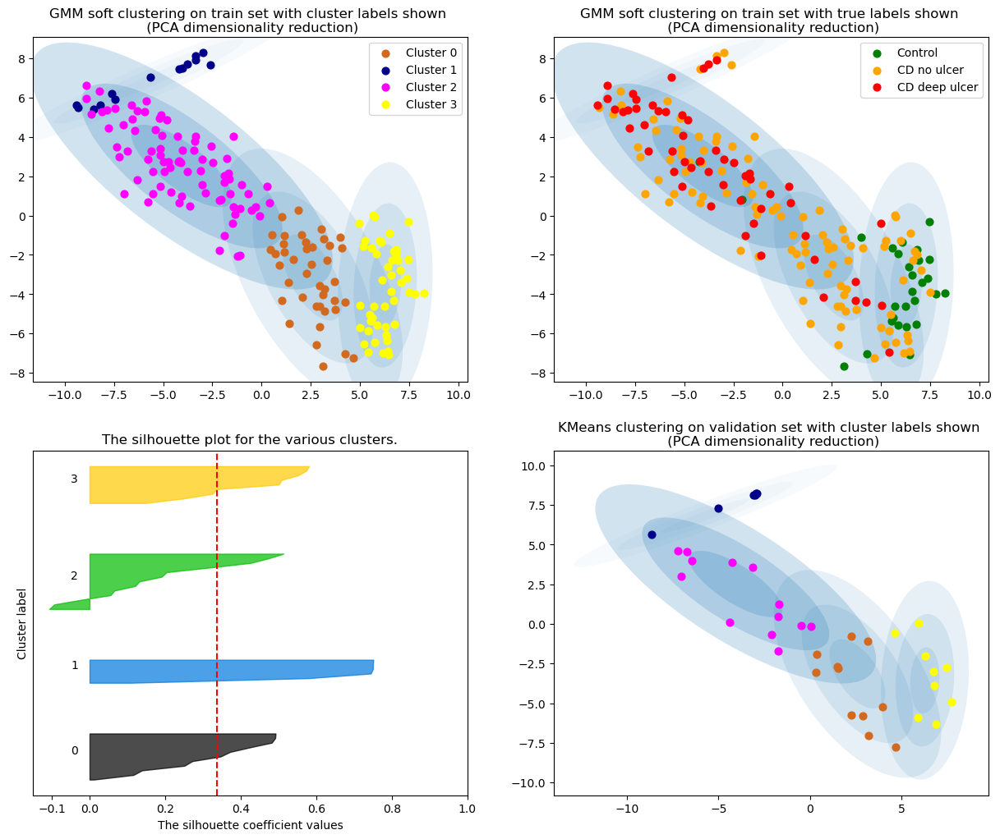

The average silhouette_score is : 0.33695877
Accuracy: 0.3333333333333333
F1 score: 0.37355607355607356


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 70


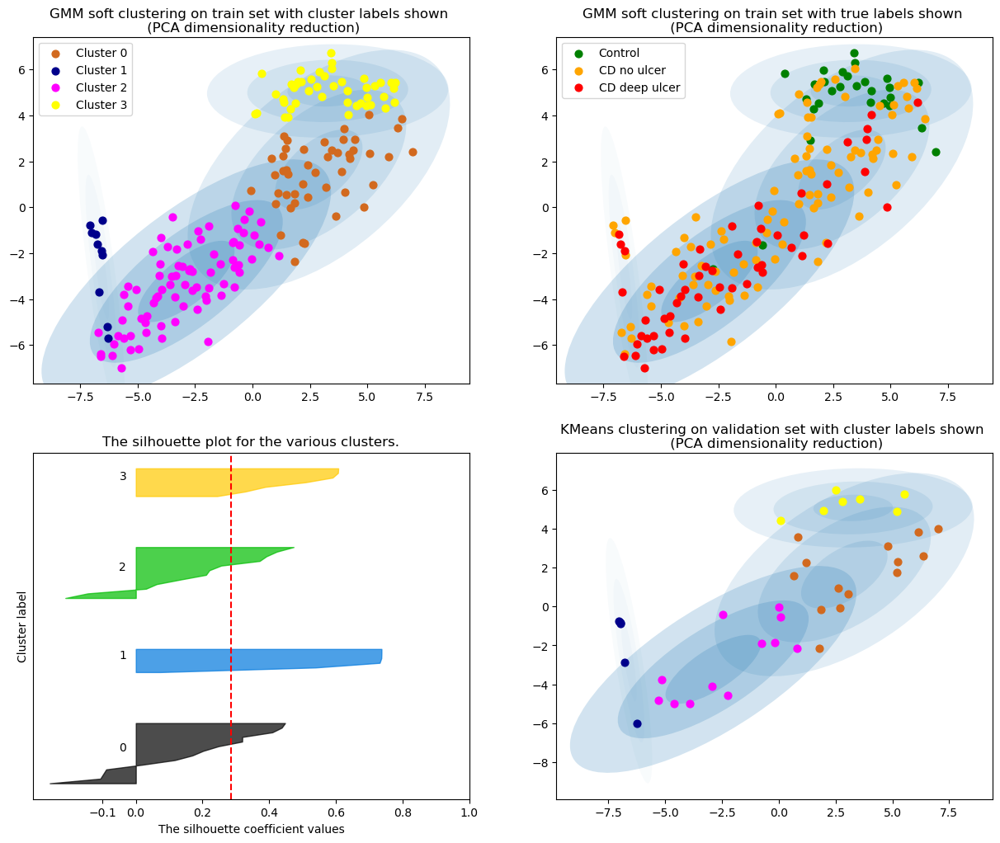

The average silhouette_score is : 0.28673583
Accuracy: 0.358974358974359
F1 score: 0.3895878678487374


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 80


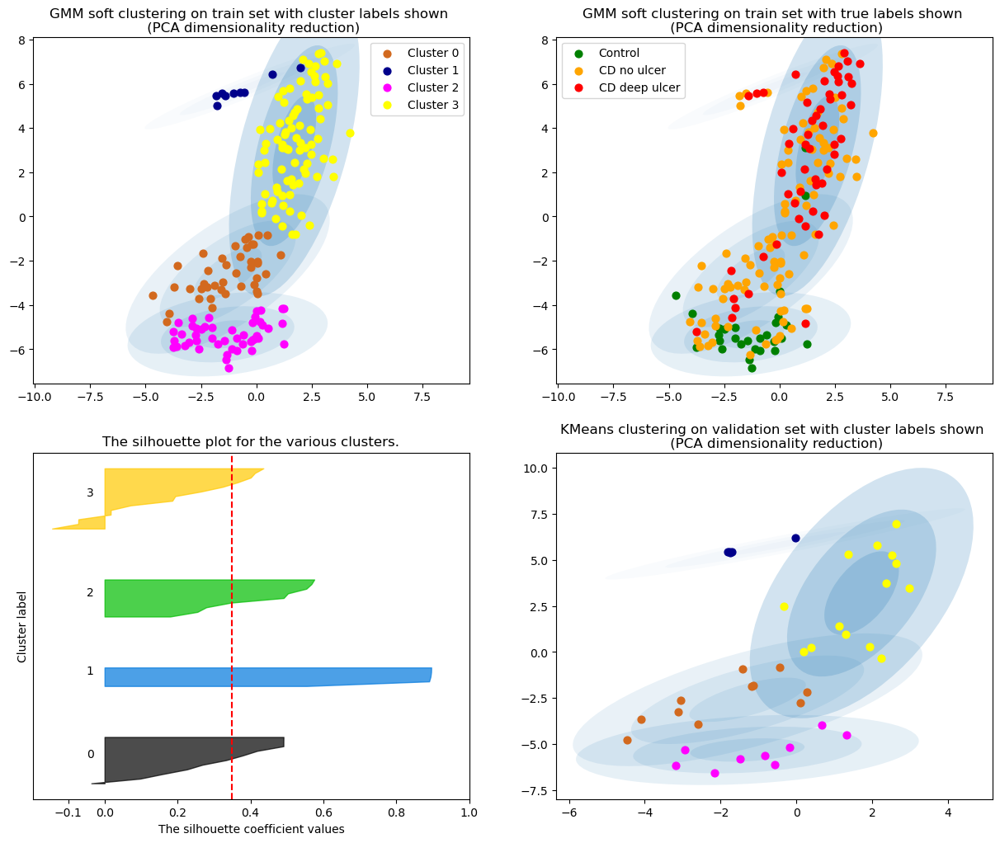

The average silhouette_score is : 0.348632
Accuracy: 0.1794871794871795
F1 score: 0.23491124260355029


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 90


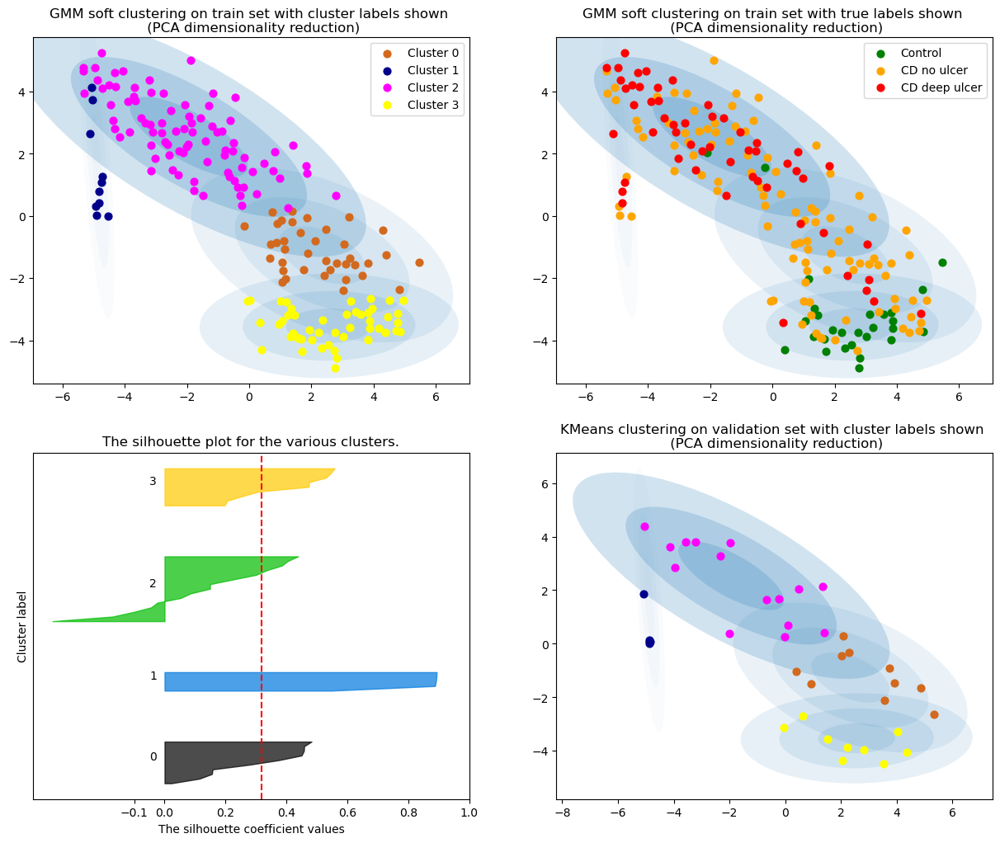

The average silhouette_score is : 0.3187512
Accuracy: 0.3076923076923077
F1 score: 0.33470881345375275


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 100


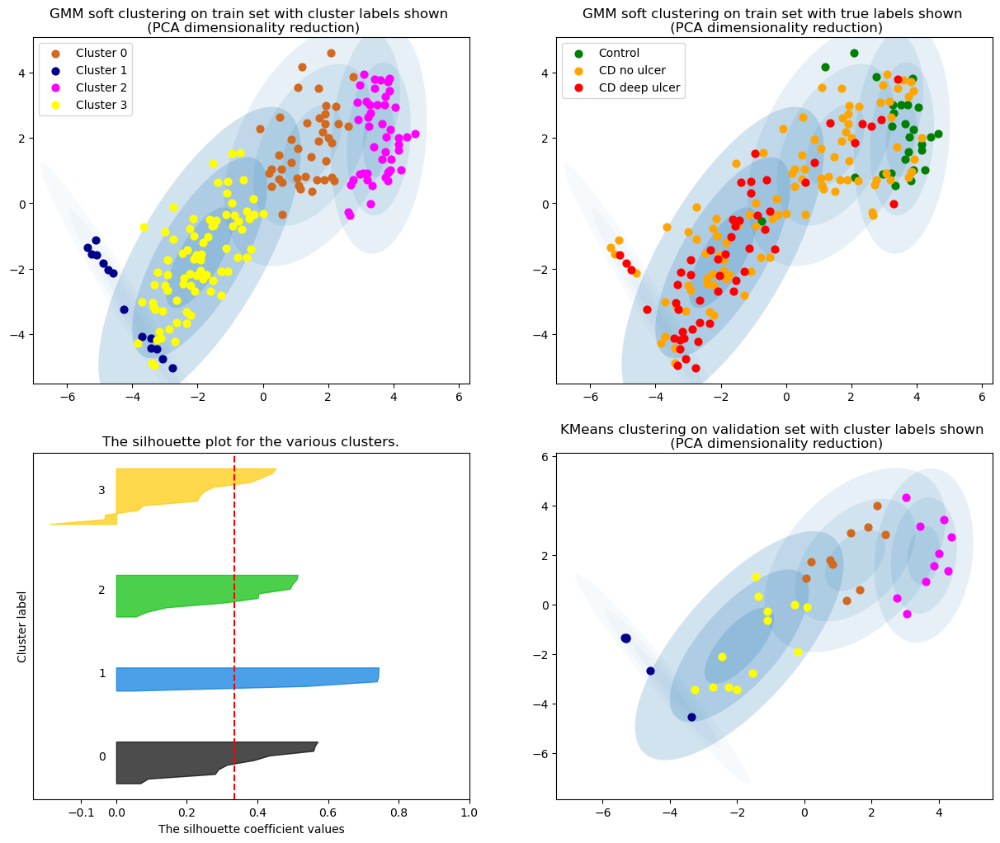

The average silhouette_score is : 0.335099
Accuracy: 0.1794871794871795
F1 score: 0.24801319538161642


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 110


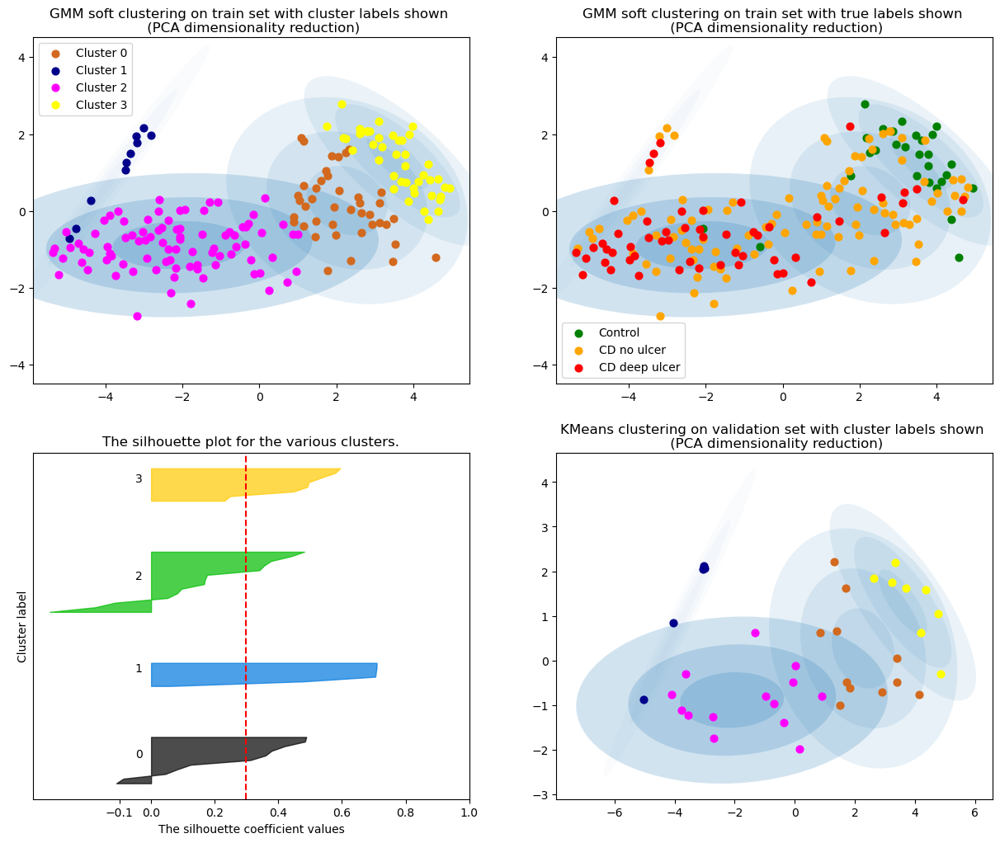

The average silhouette_score is : 0.29783913
Accuracy: 0.3076923076923077
F1 score: 0.34591849374458067


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passin

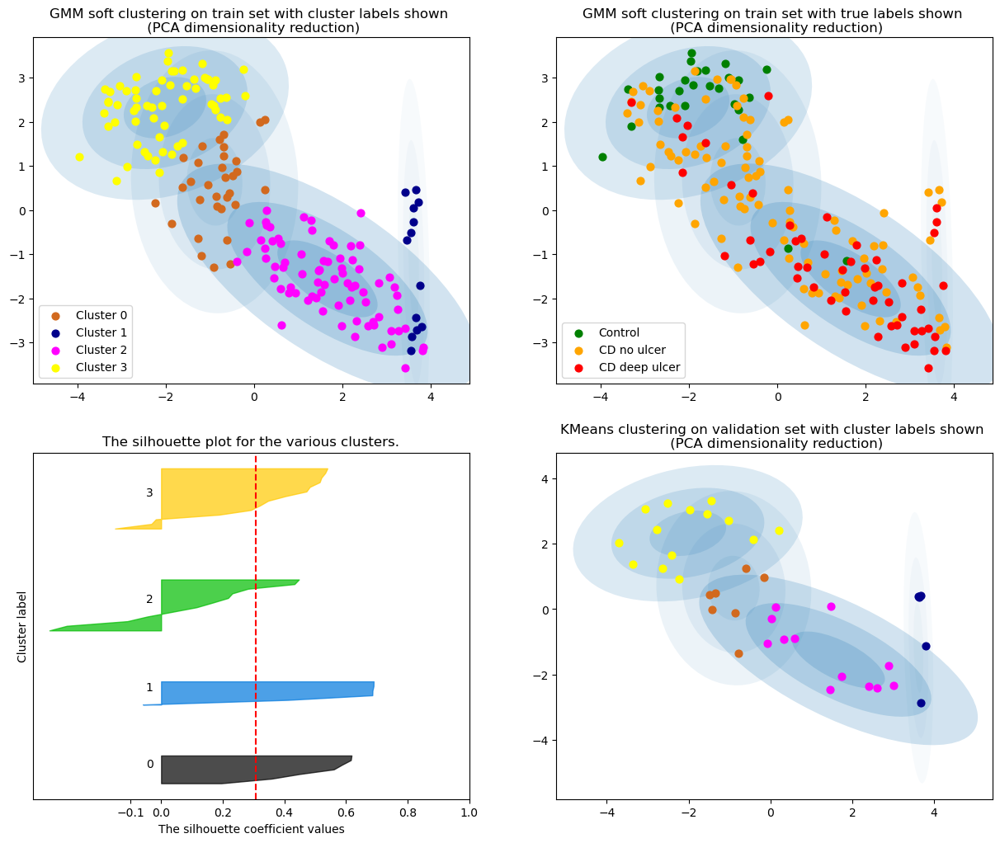

The average silhouette_score is : 0.30790752
Accuracy: 0.28205128205128205
F1 score: 0.33816646316646315


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 130


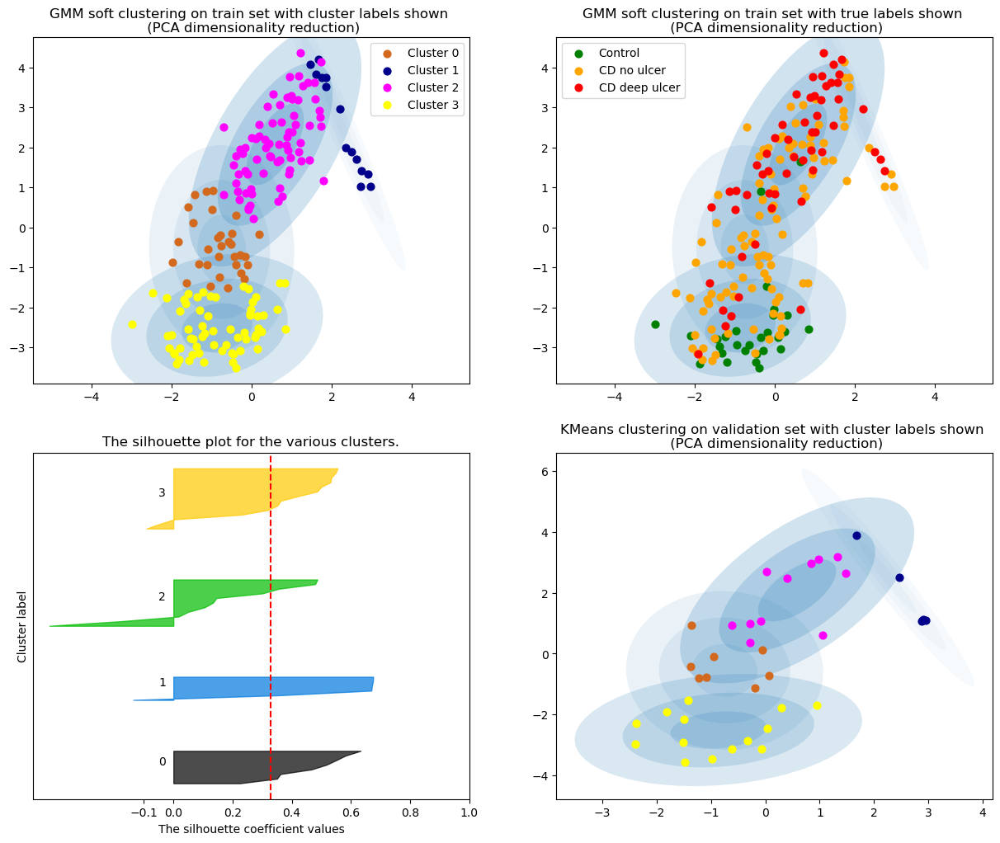

The average silhouette_score is : 0.32781824
Accuracy: 0.28205128205128205
F1 score: 0.34196413608178317


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 140


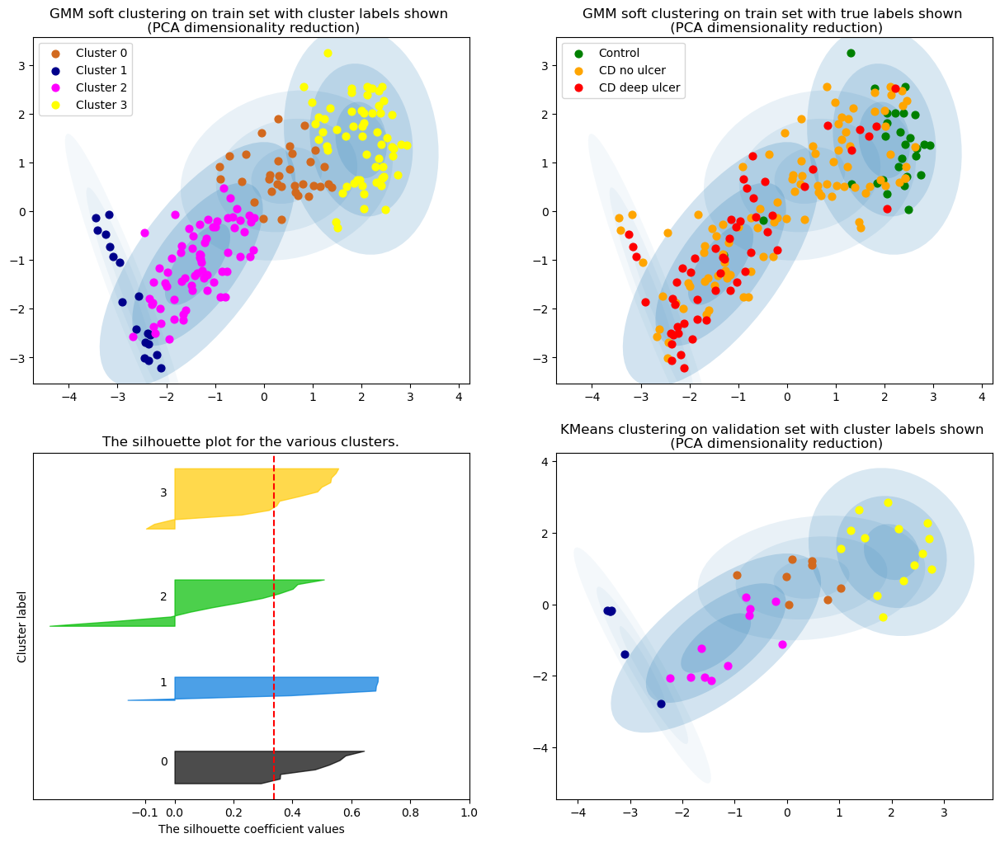

The average silhouette_score is : 0.3370781
Accuracy: 0.28205128205128205
F1 score: 0.34196413608178317


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 150


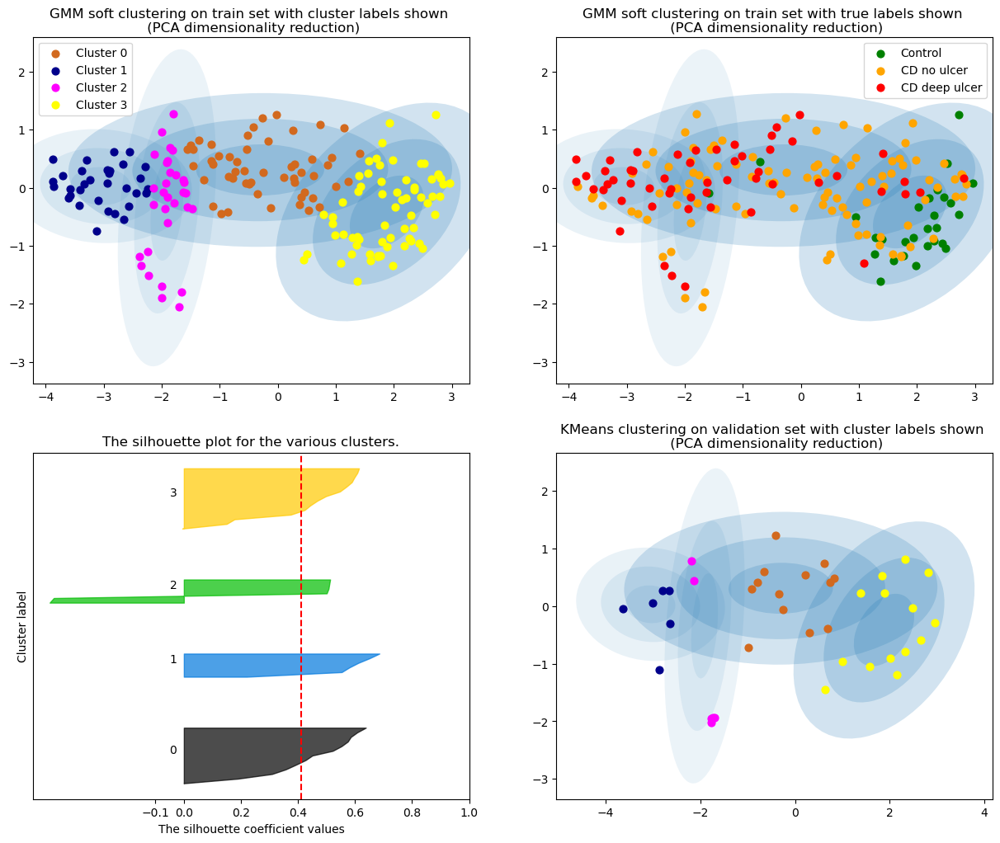

The average silhouette_score is : 0.41179255
Accuracy: 0.15384615384615385
F1 score: 0.20217560217560218


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 160


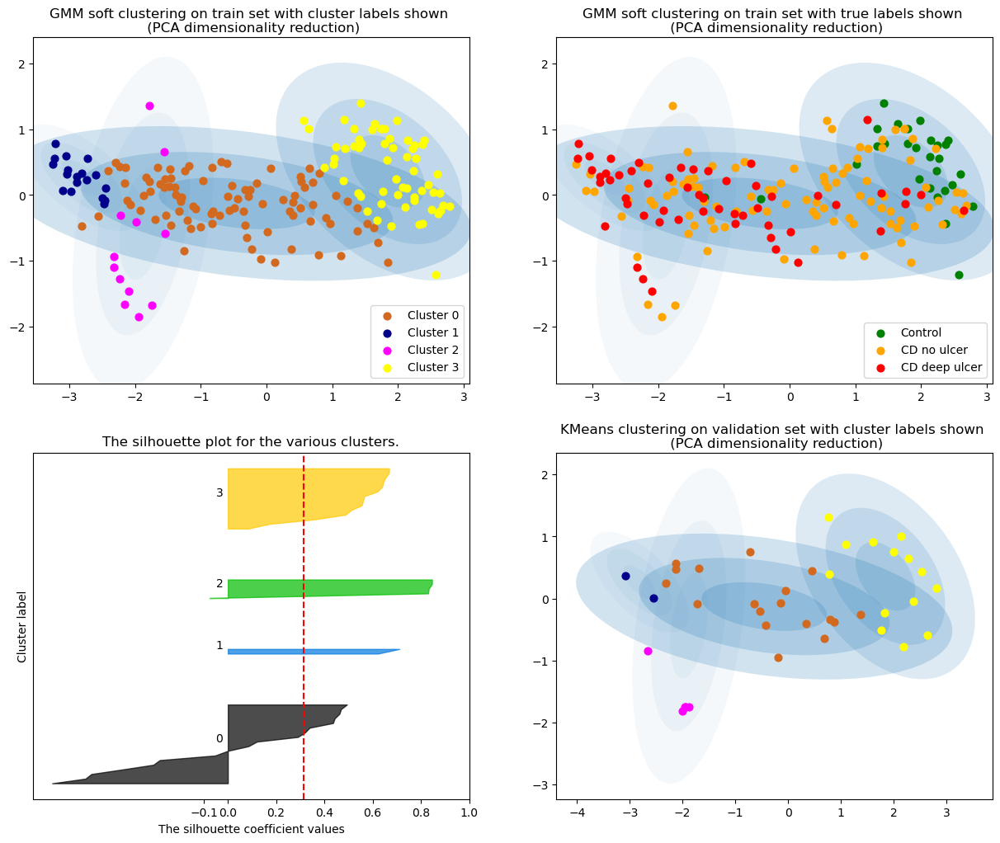

The average silhouette_score is : 0.31531566
Accuracy: 0.07692307692307693
F1 score: 0.09688379253596643


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 170


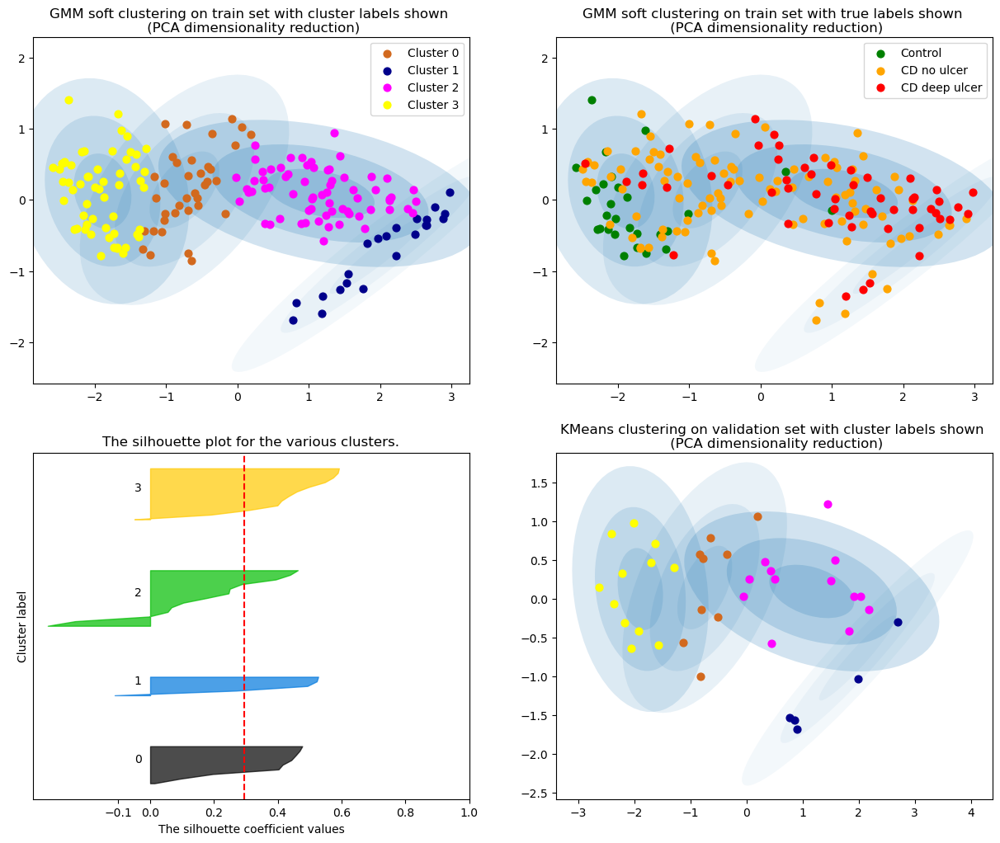

The average silhouette_score is : 0.29580164
Accuracy: 0.2564102564102564
F1 score: 0.29621660390891164


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 180


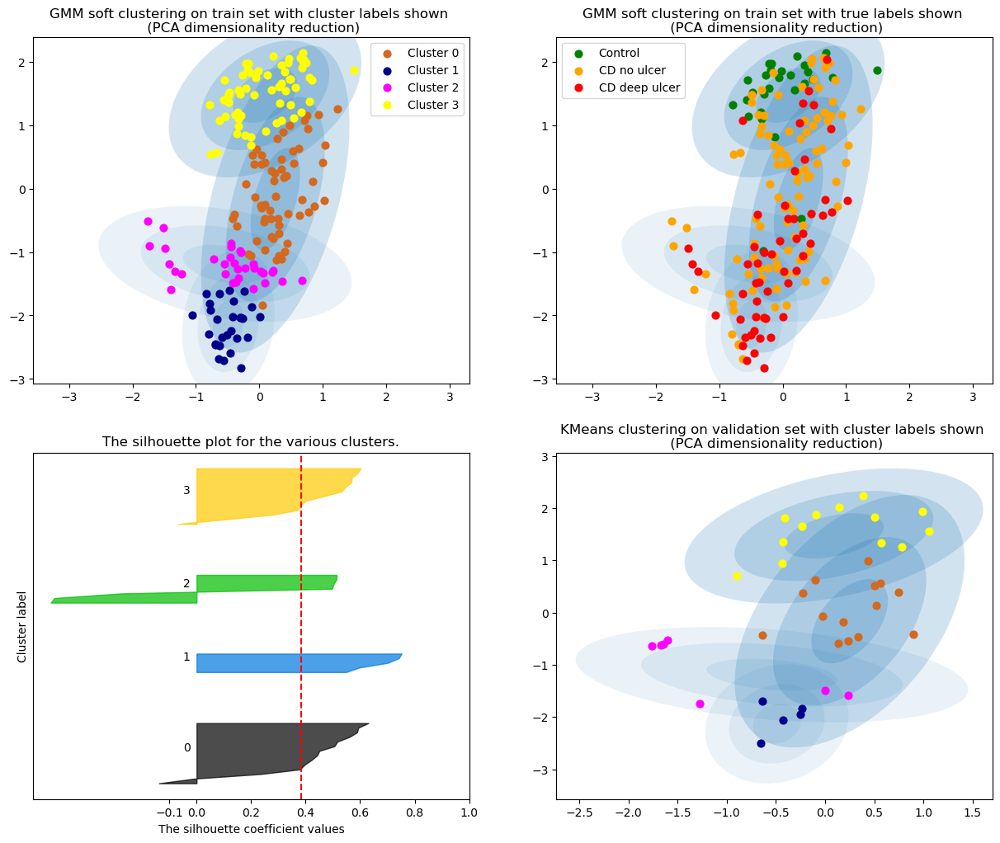

The average silhouette_score is : 0.38332033
Accuracy: 0.15384615384615385
F1 score: 0.18066632364291227


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 190


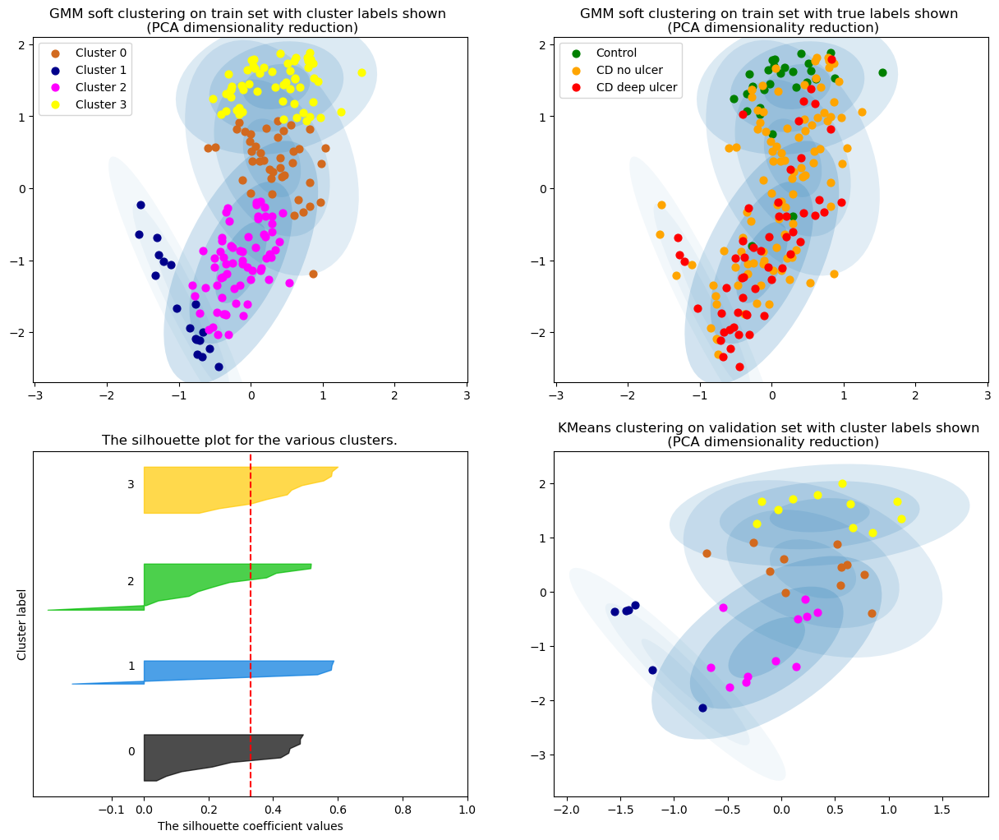

The average silhouette_score is : 0.33003953
Accuracy: 0.3076923076923077
F1 score: 0.360968660968661


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 200


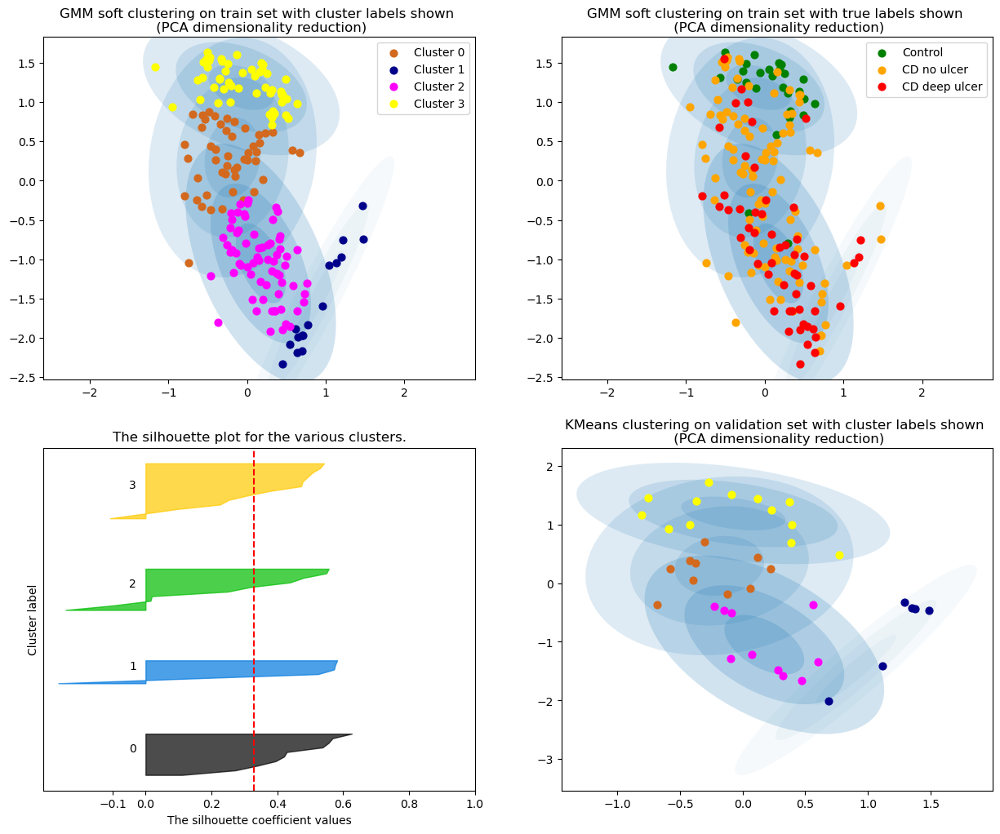

The average silhouette_score is : 0.3285357
Accuracy: 0.3076923076923077
F1 score: 0.3694706852601589


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 210


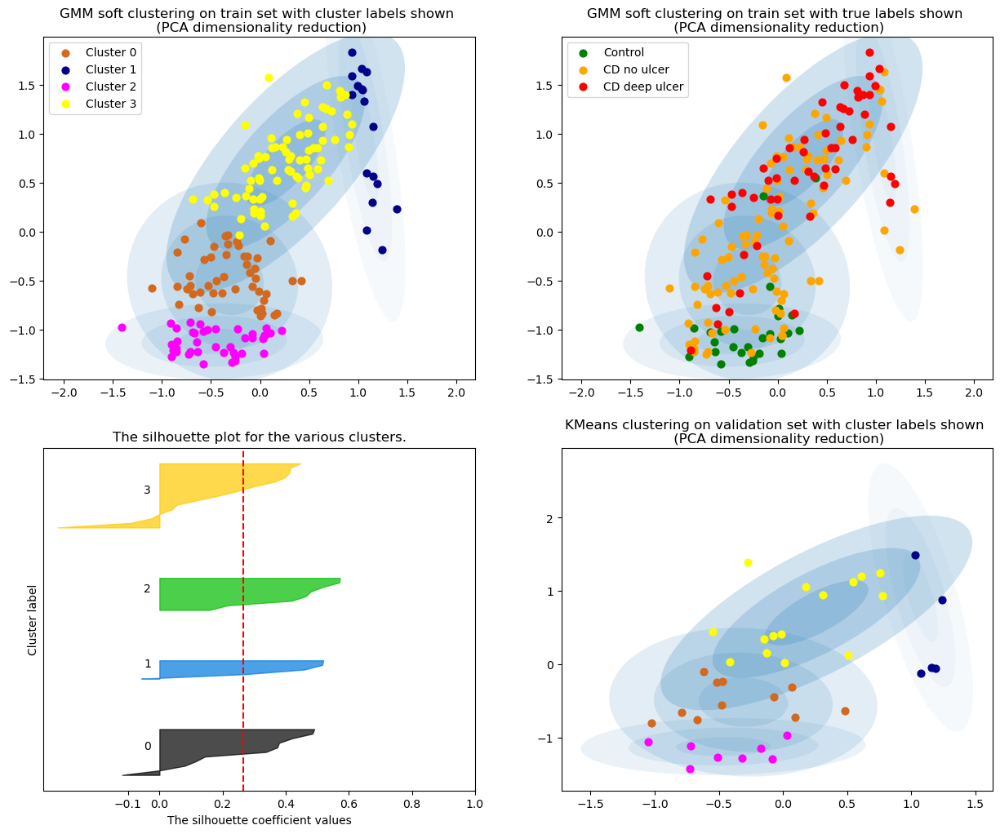

The average silhouette_score is : 0.26607245
Accuracy: 0.15384615384615385
F1 score: 0.2118343195266272


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 220


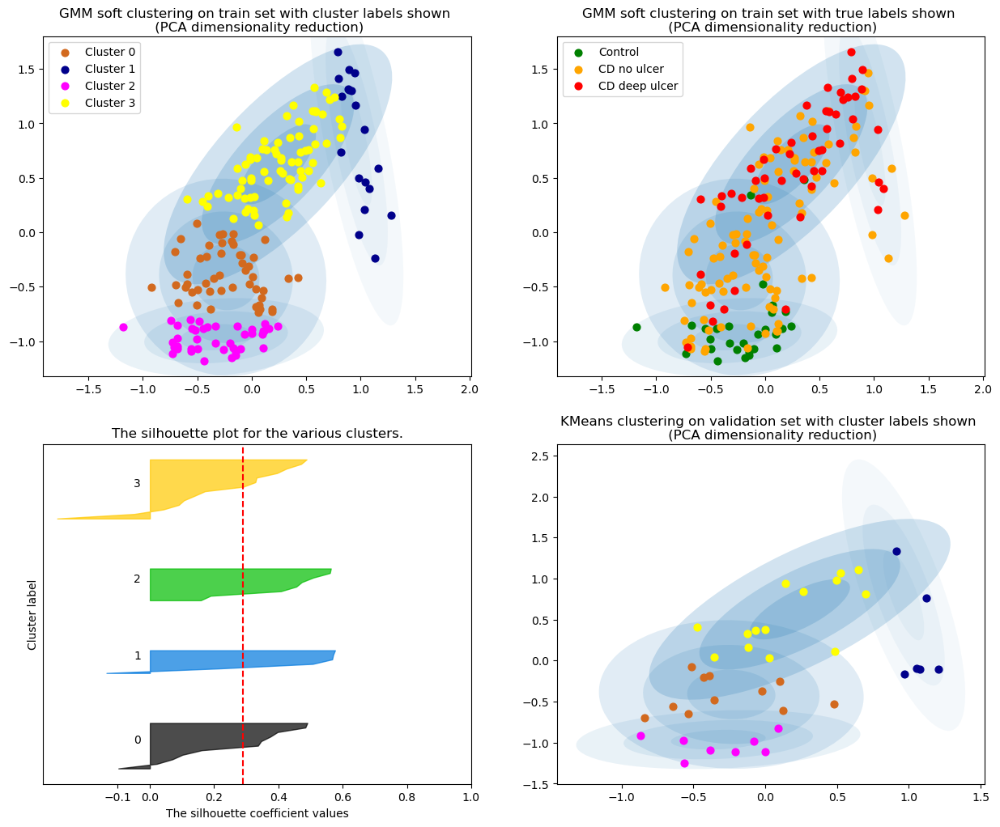

The average silhouette_score is : 0.2882492
Accuracy: 0.1794871794871795
F1 score: 0.2455840455840456


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 230


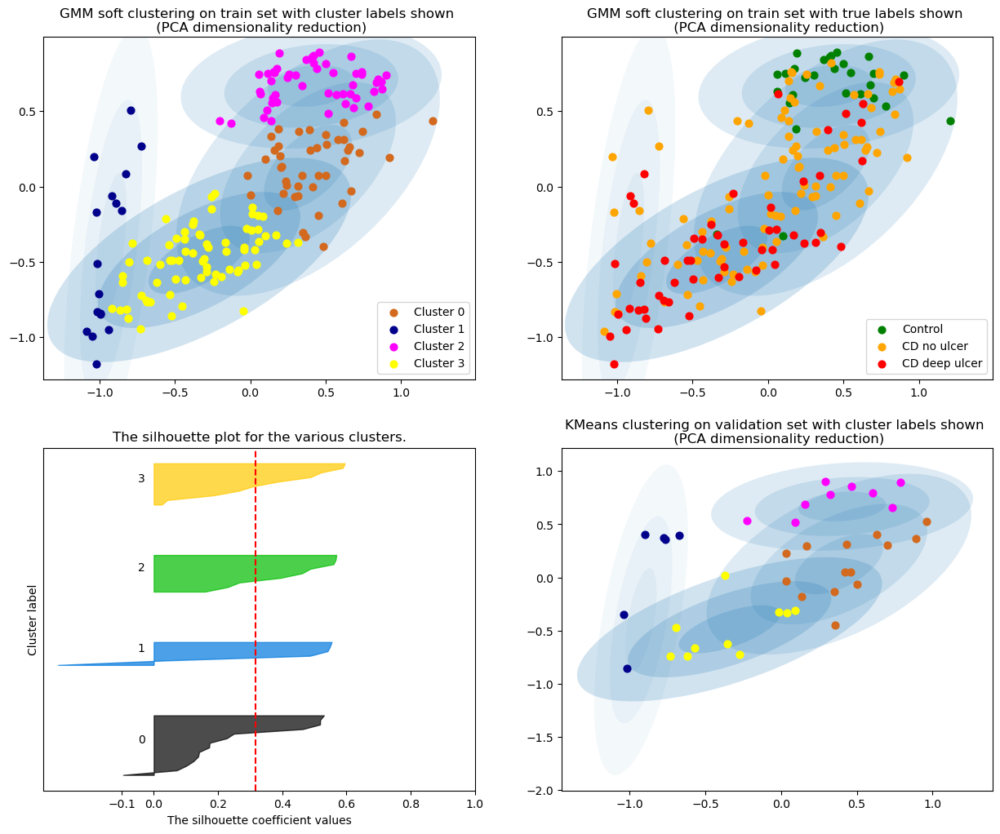

The average silhouette_score is : 0.31554577
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 240


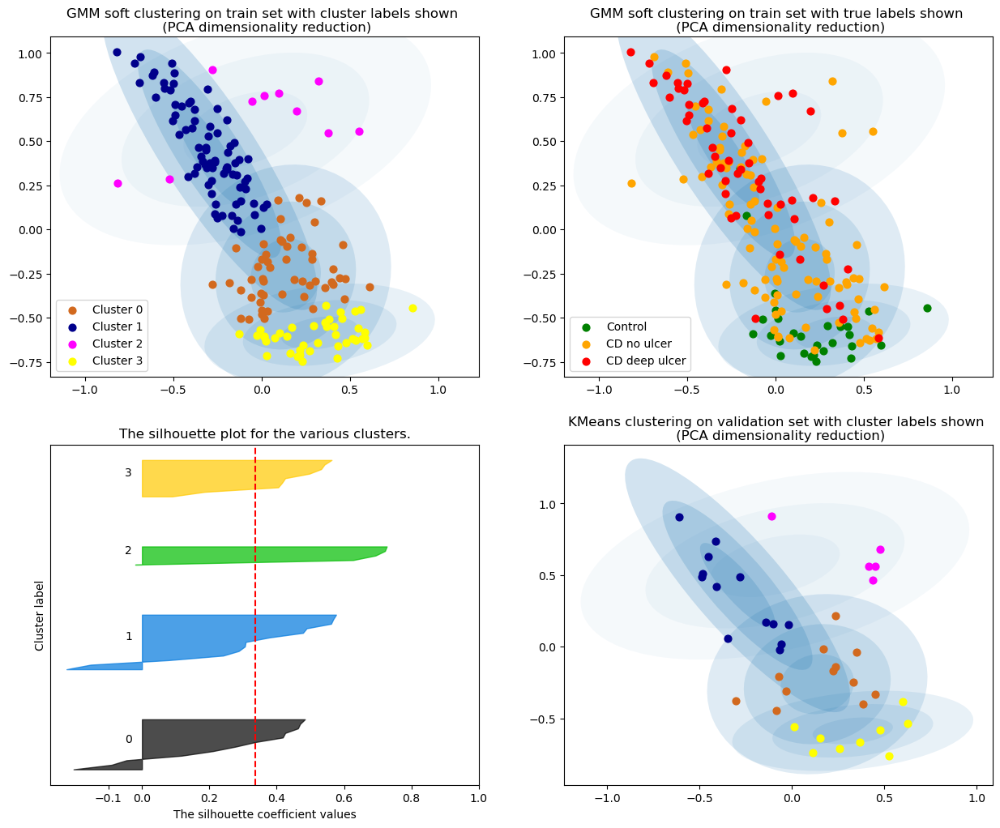

The average silhouette_score is : 0.33756185
Accuracy: 0.28205128205128205
F1 score: 0.33031674208144796


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 250


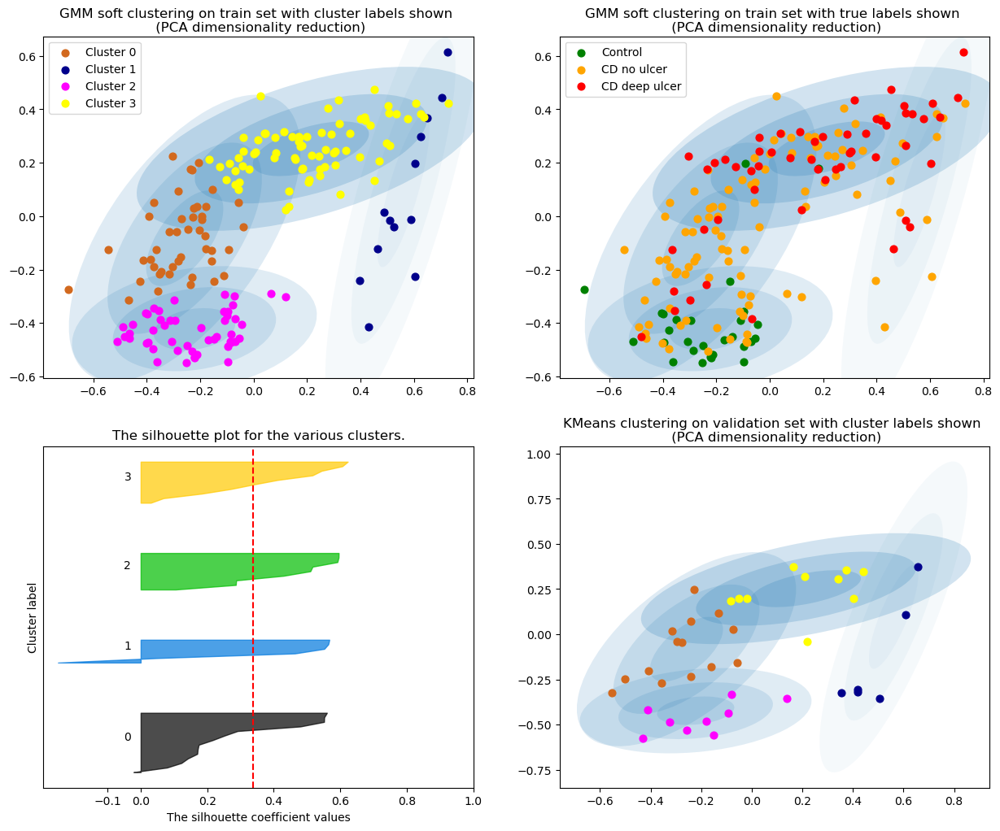

The average silhouette_score is : 0.33830458
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


In [54]:

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_pca, X_train_pca, X_val_pca, train_disease_labels, "PCA", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)
    


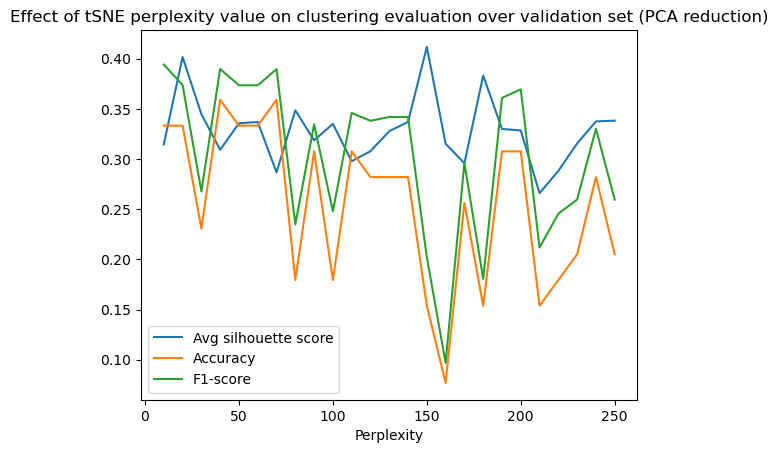

In [55]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

#### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


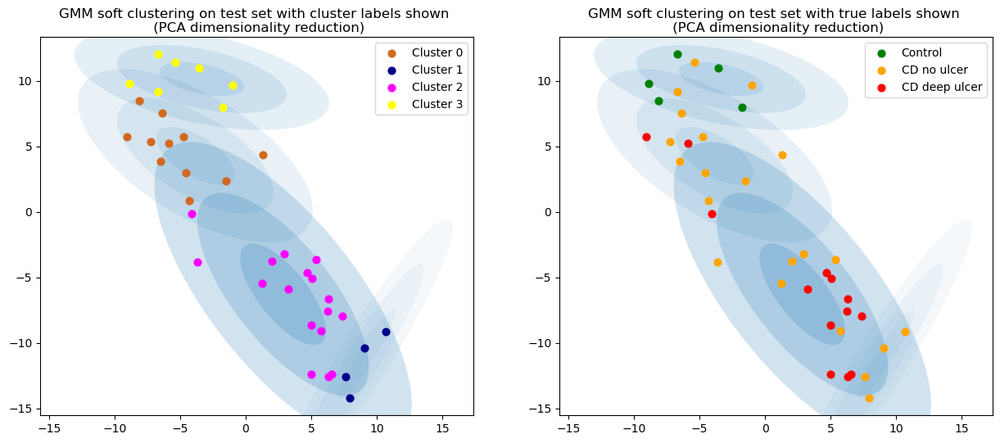

In [56]:
perplexity = 40
gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
gmm_labels_pca = plot_gmm(gmm_pca, X_test_pca, X_val_pca, test_disease_labels, "PCA", num_c=num_c, test=True)


### Fit GMM with autoencoder dimensionality reduction

#### Training

In [57]:
# X_train_ae

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


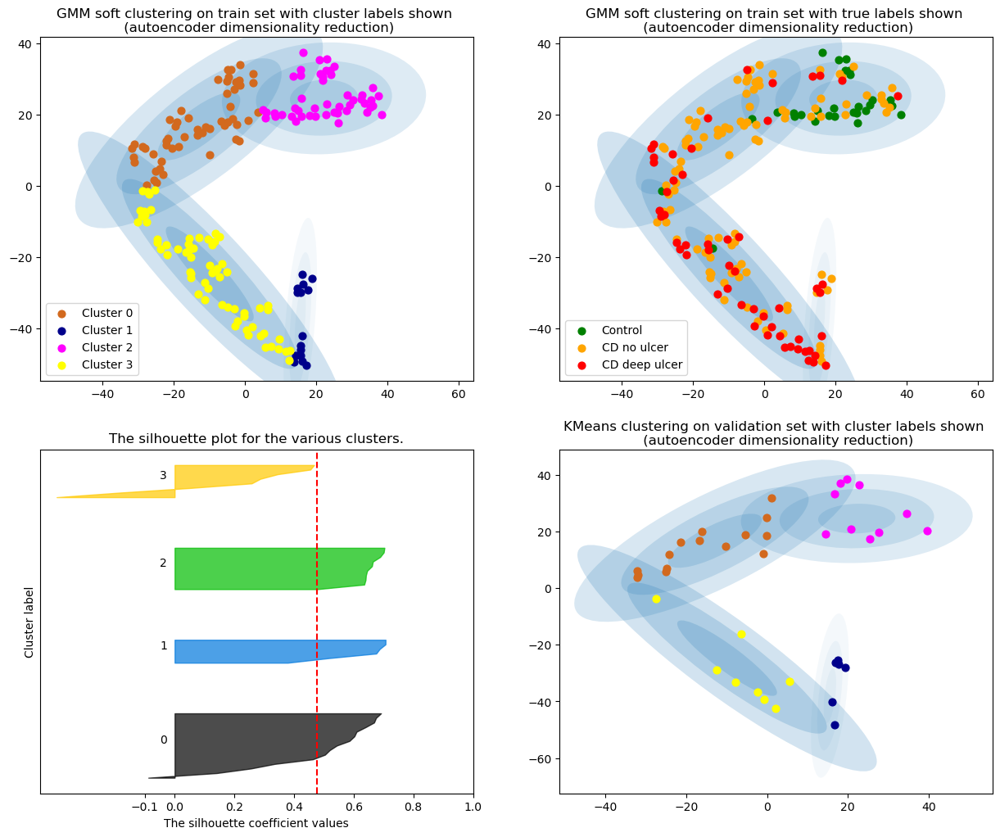

The average silhouette_score is : 0.4758984
Accuracy: 0.1794871794871795
F1 score: 0.23789173789173793


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 20


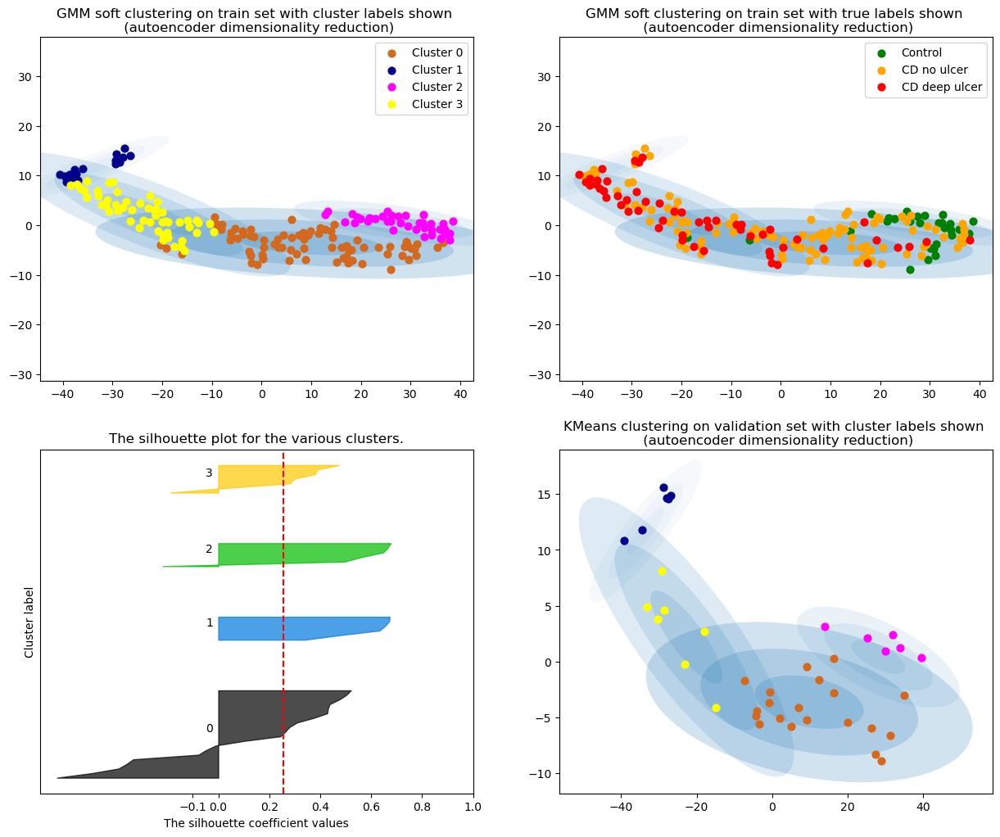

The average silhouette_score is : 0.2550869
Accuracy: 0.2564102564102564
F1 score: 0.27900579624717553


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 30


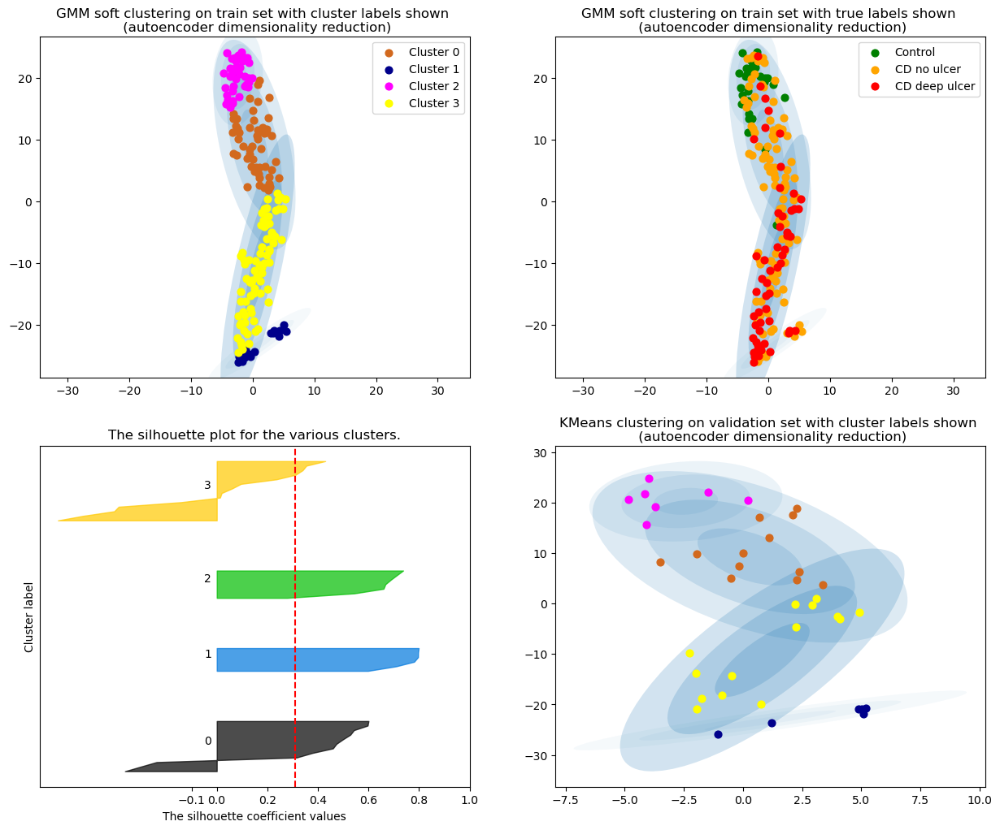

The average silhouette_score is : 0.3083445
Accuracy: 0.20512820512820512
F1 score: 0.2653642653642654


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 40


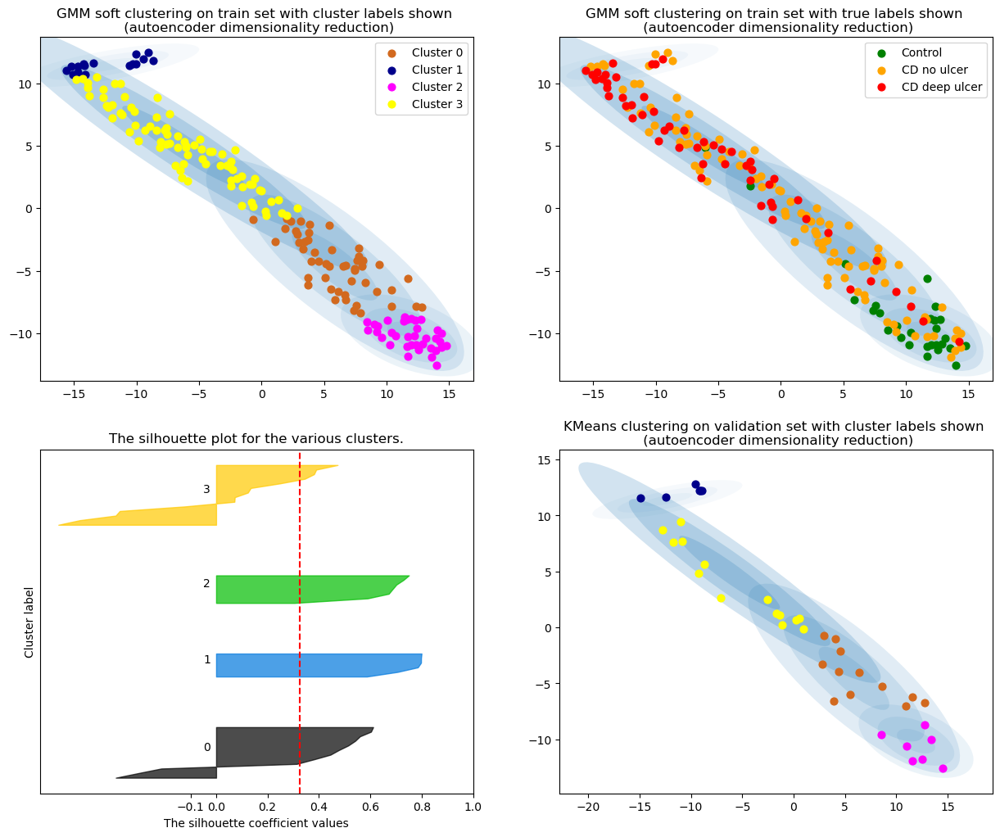

The average silhouette_score is : 0.32449558
Accuracy: 0.20512820512820512
F1 score: 0.2653642653642654


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 50


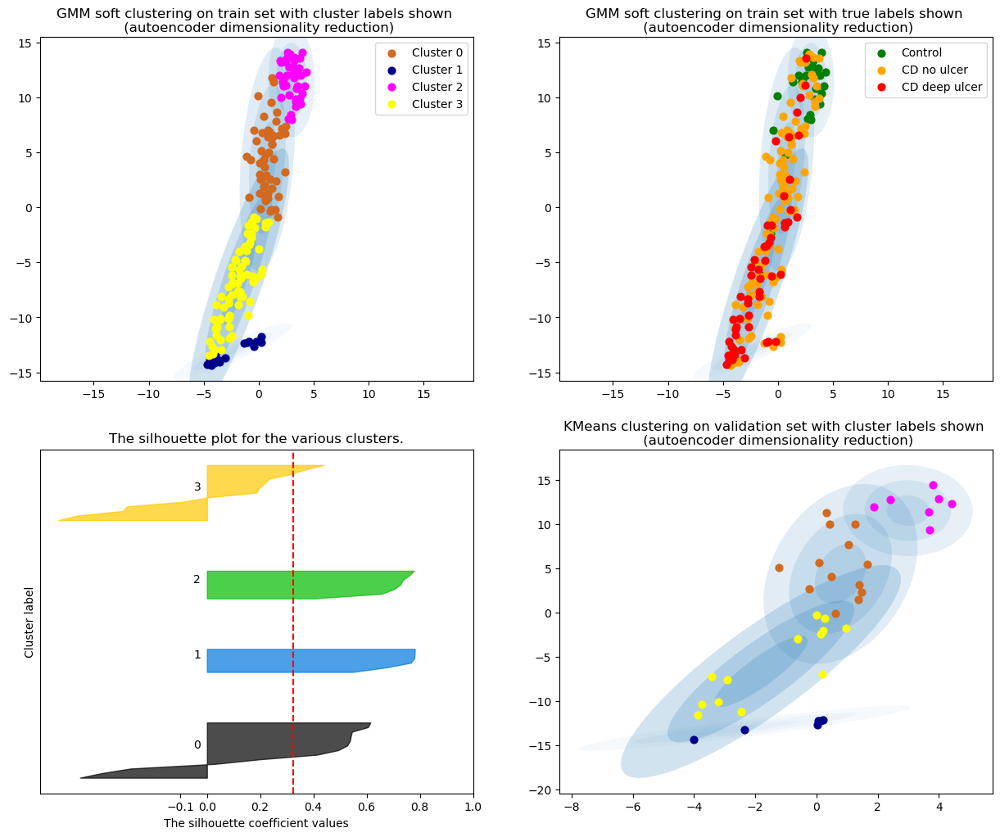

The average silhouette_score is : 0.32435453
Accuracy: 0.20512820512820512
F1 score: 0.2623672623672624


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 60


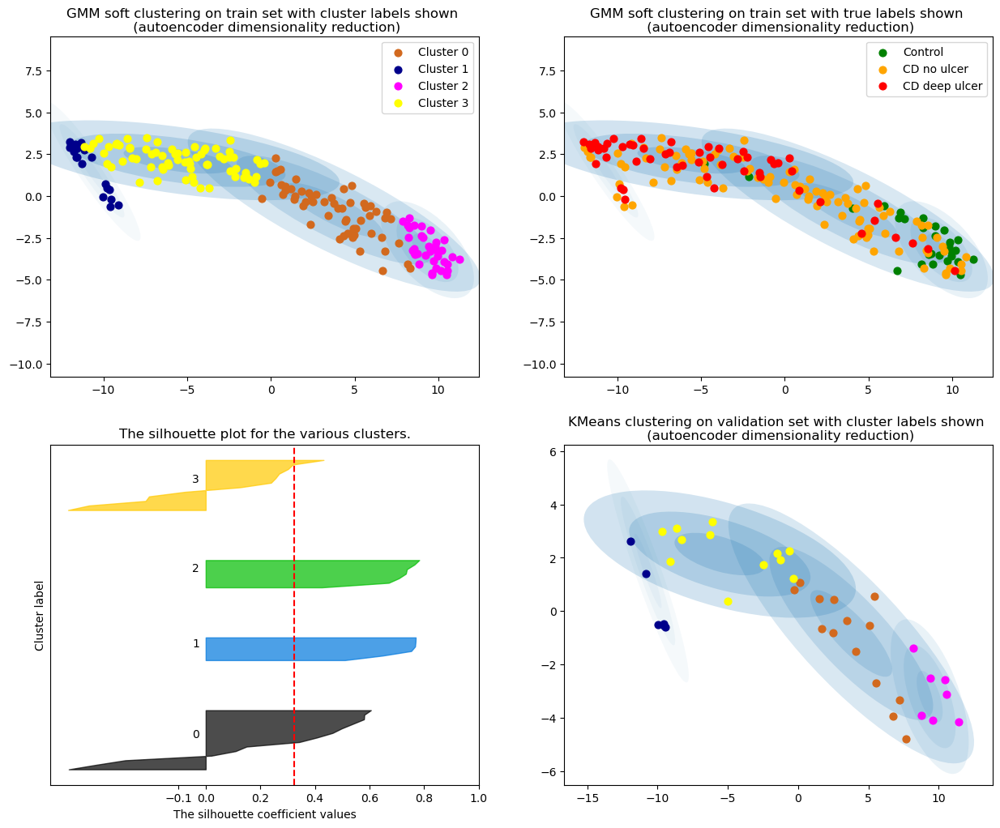

The average silhouette_score is : 0.32408848
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 70


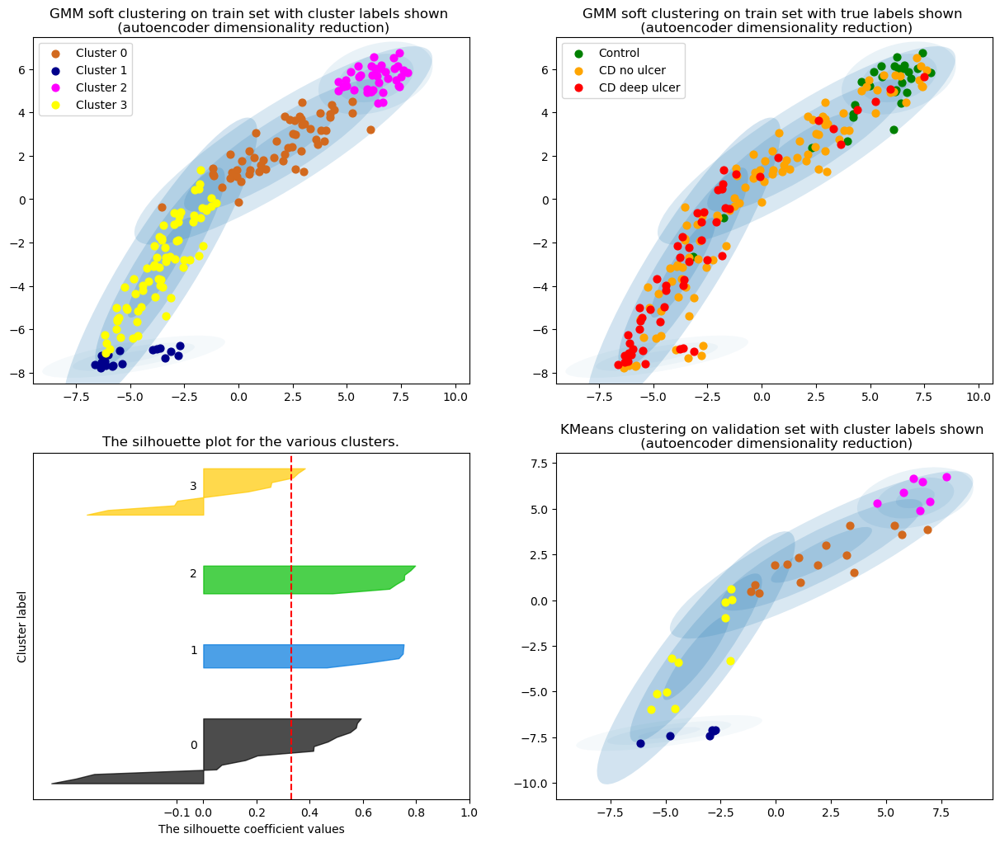

The average silhouette_score is : 0.33220416
Accuracy: 0.20512820512820512
F1 score: 0.2571225071225071


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 80


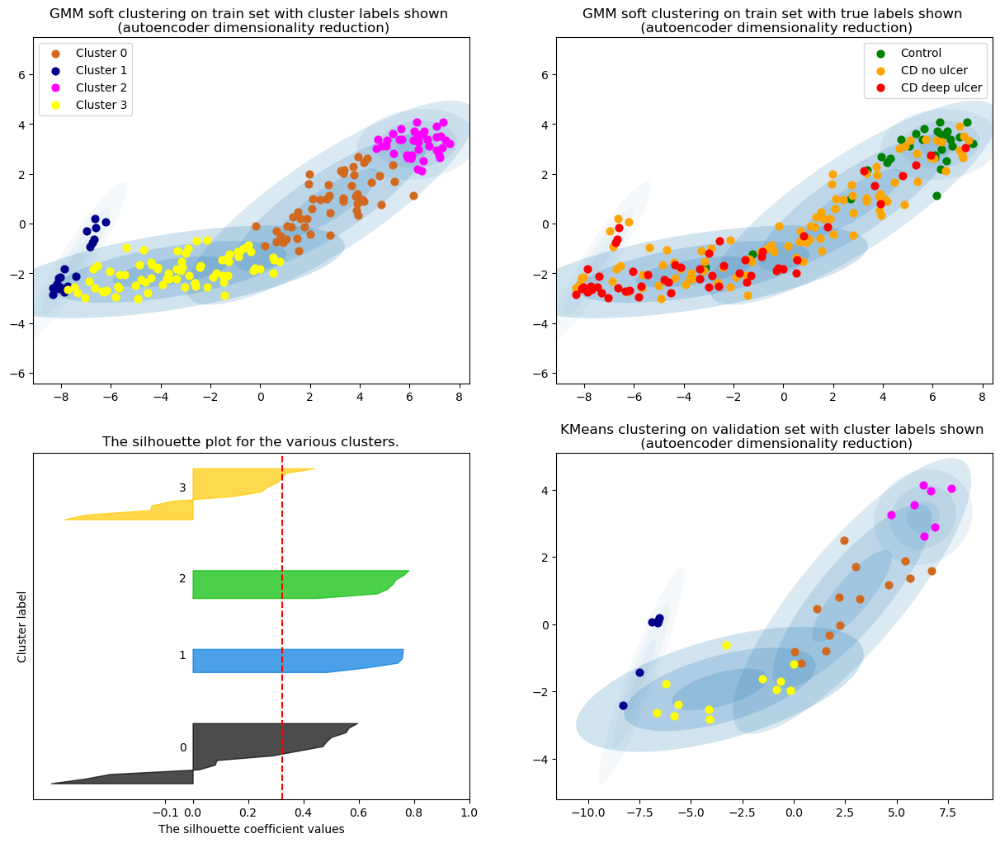

The average silhouette_score is : 0.32324988
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 90


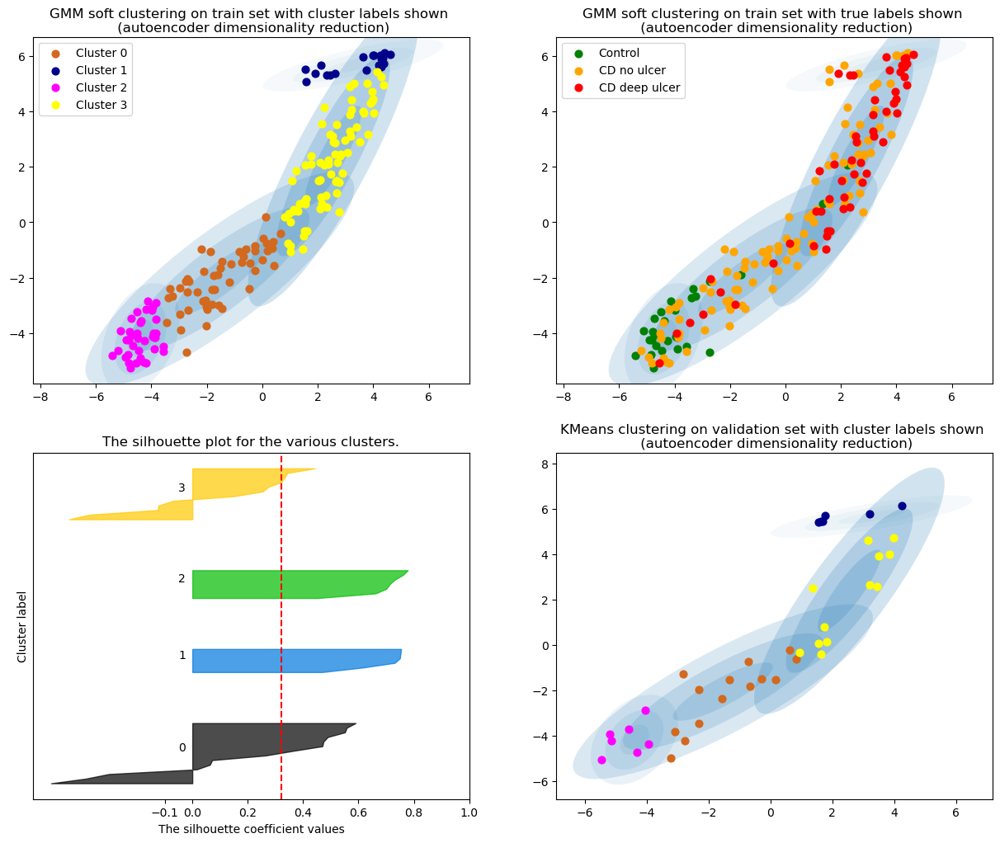

The average silhouette_score is : 0.32238394
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 100


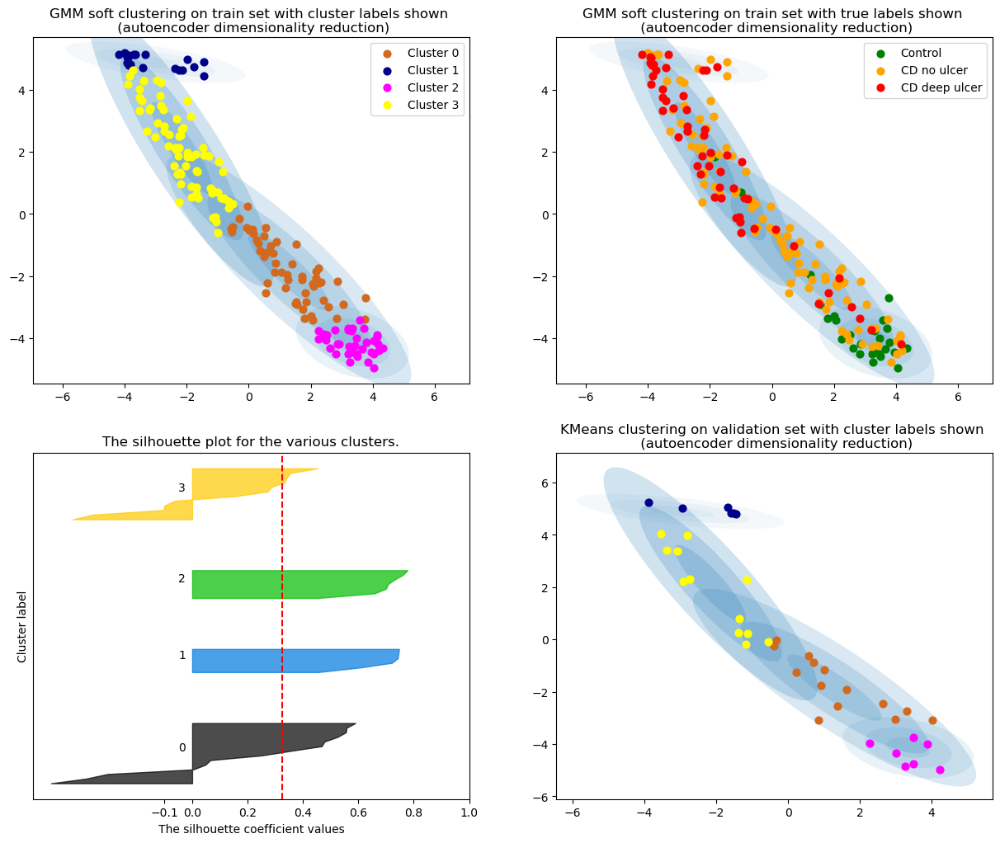

The average silhouette_score is : 0.32418418
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 110


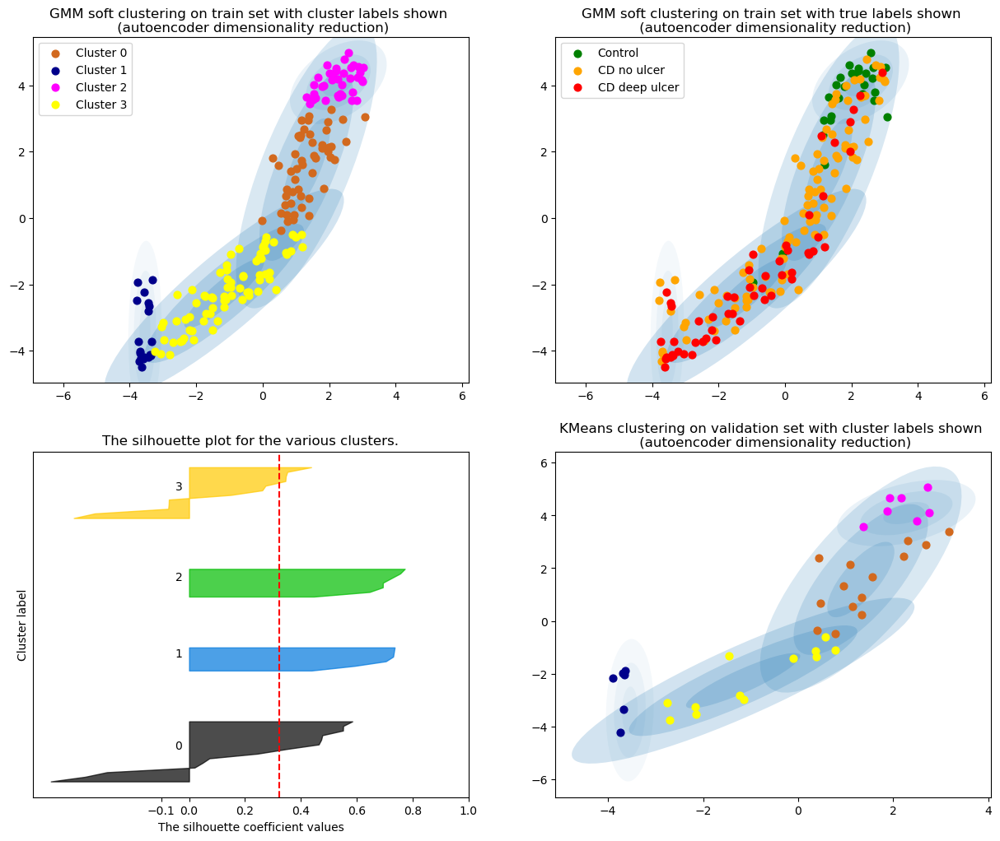

The average silhouette_score is : 0.32138246
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 120


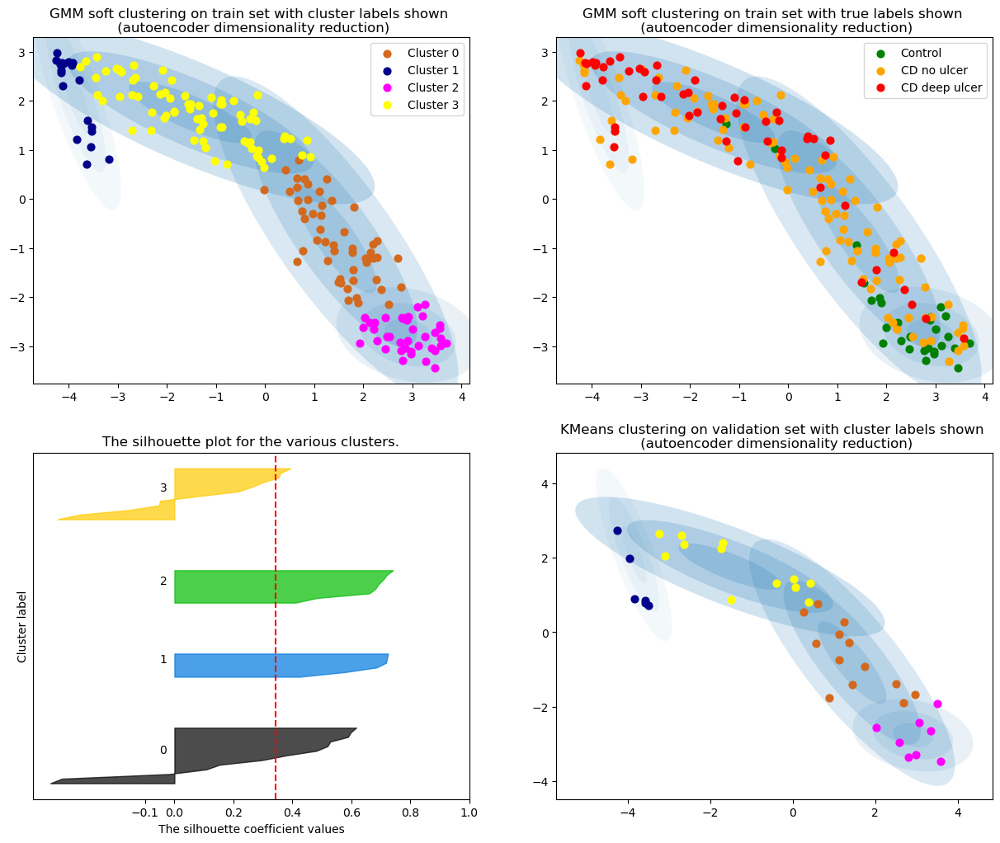

The average silhouette_score is : 0.34356245
Accuracy: 0.1794871794871795
F1 score: 0.24138824138824141


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 130


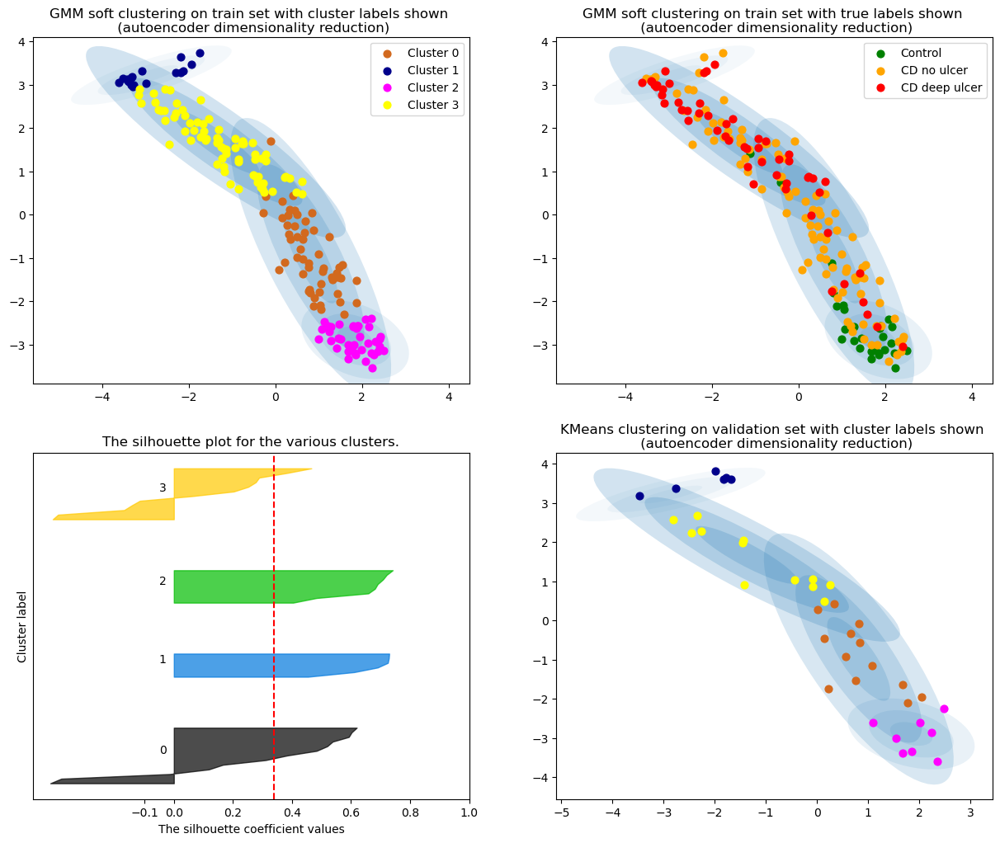

The average silhouette_score is : 0.3395865
Accuracy: 0.1794871794871795
F1 score: 0.24138824138824141


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 140


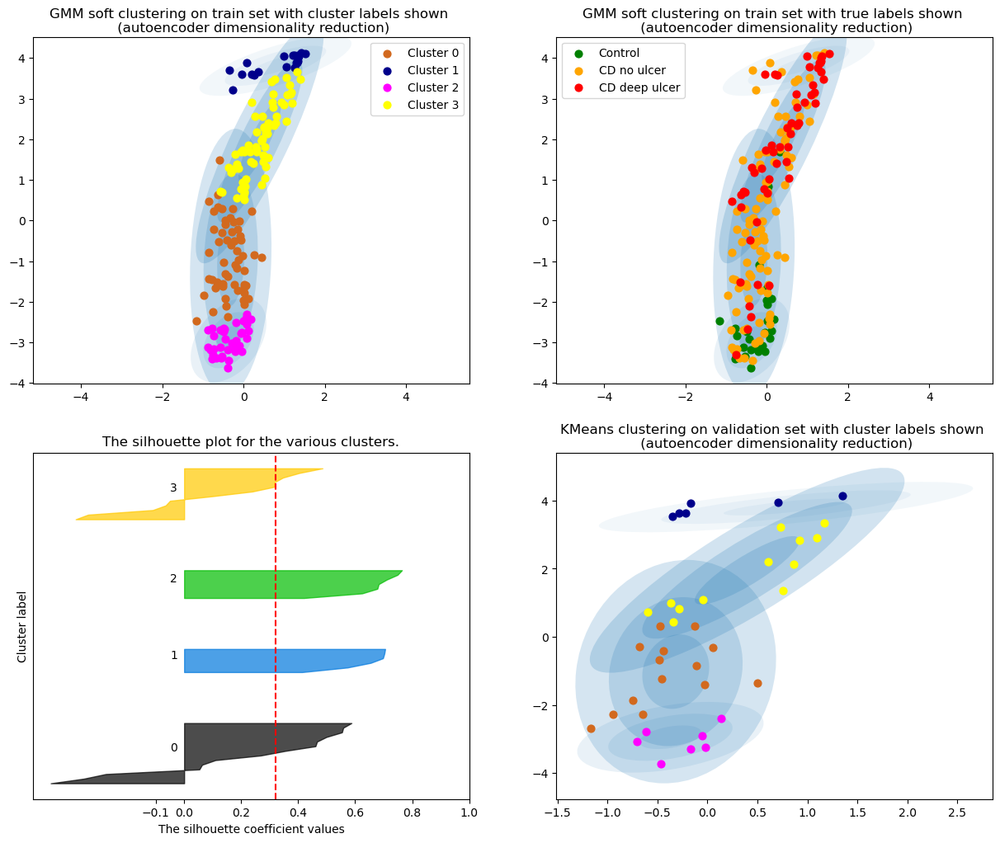

The average silhouette_score is : 0.32103172
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 150


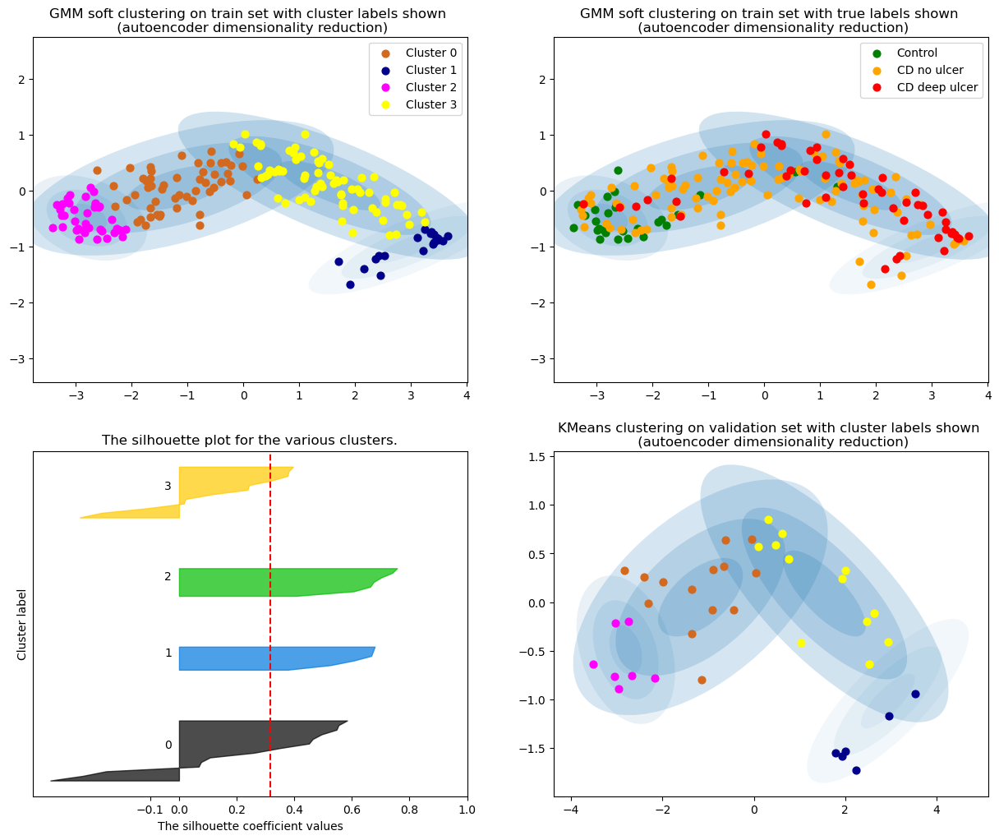

The average silhouette_score is : 0.31752
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passin

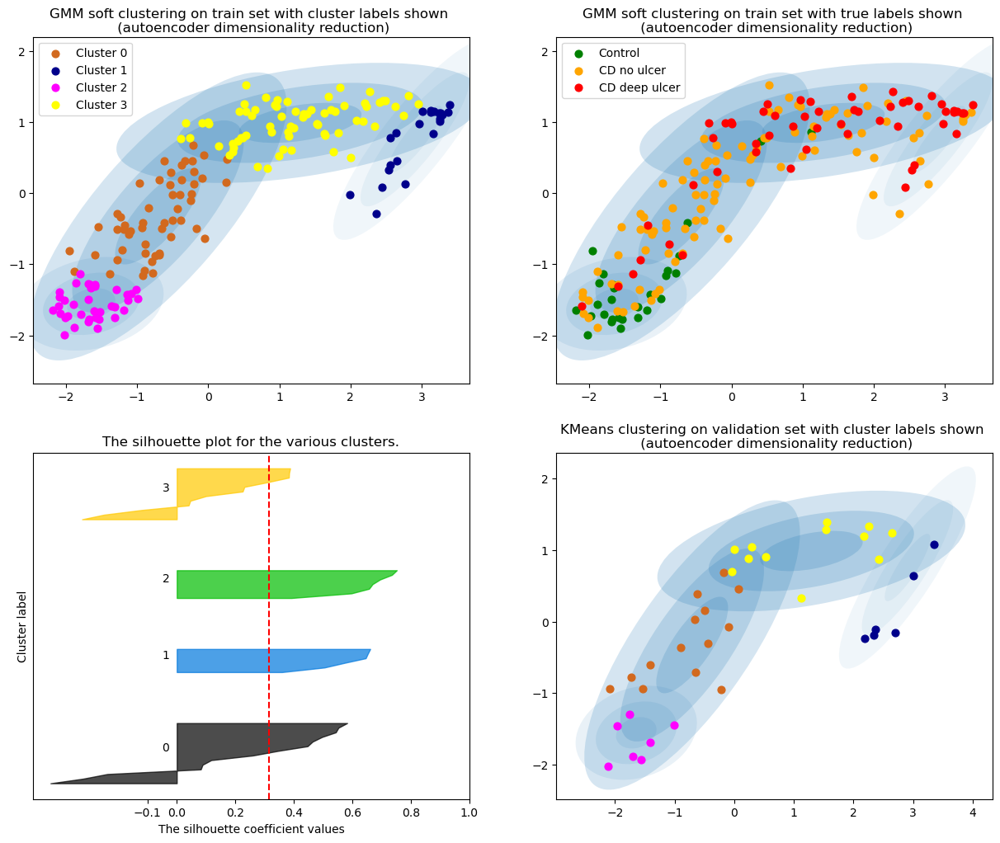

The average silhouette_score is : 0.3155791
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 170


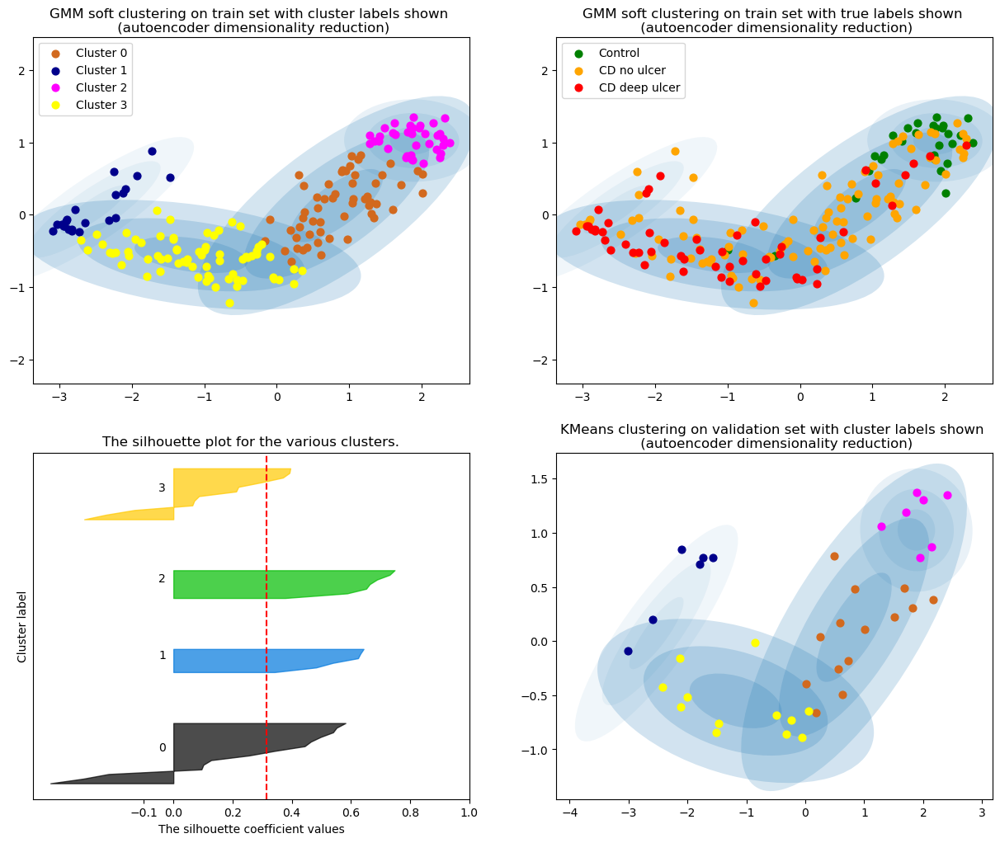

The average silhouette_score is : 0.31344298
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 180


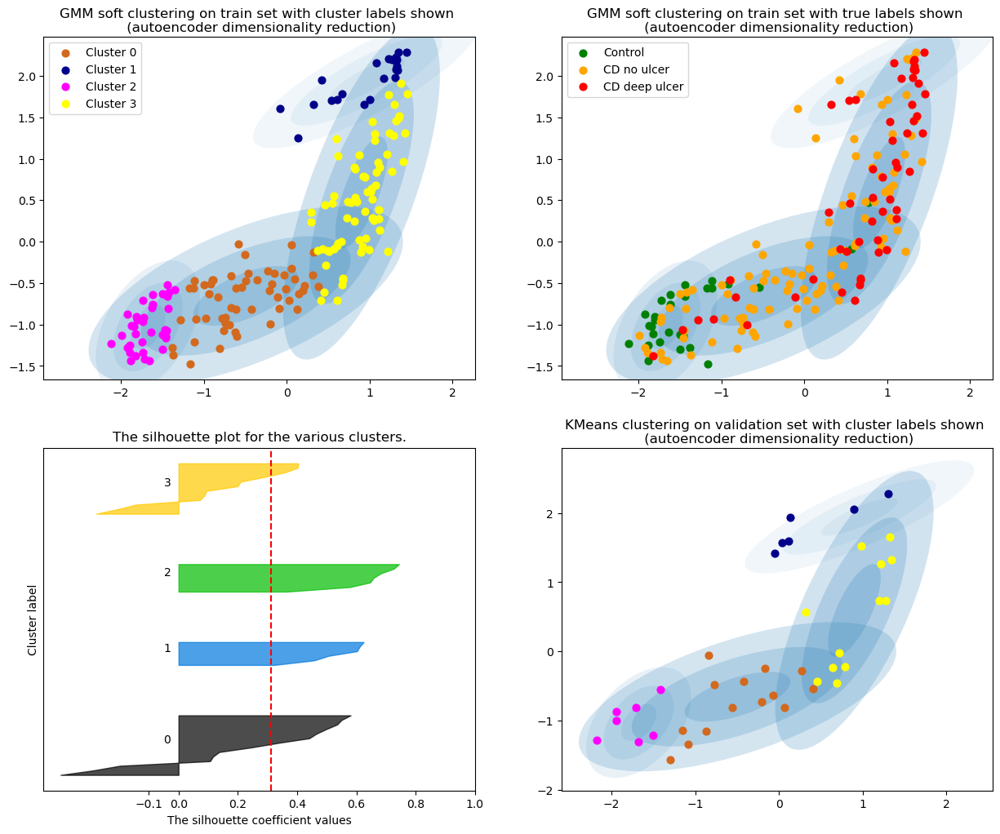

The average silhouette_score is : 0.31135988
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 190


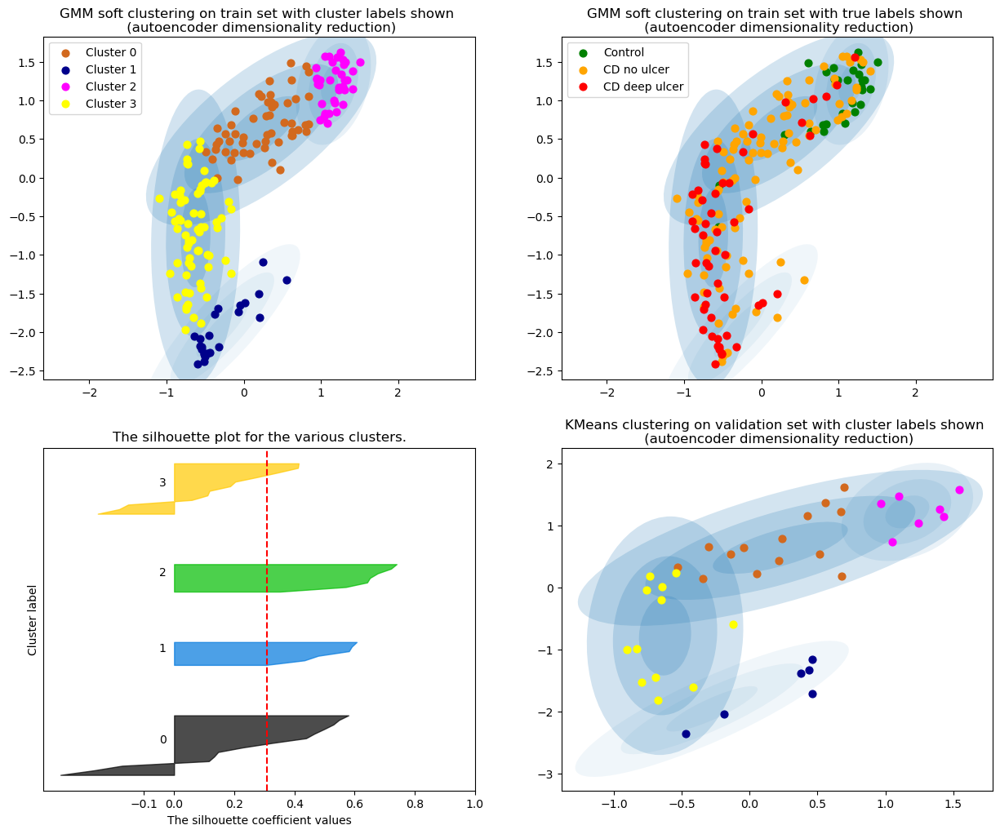

The average silhouette_score is : 0.30964935
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 200


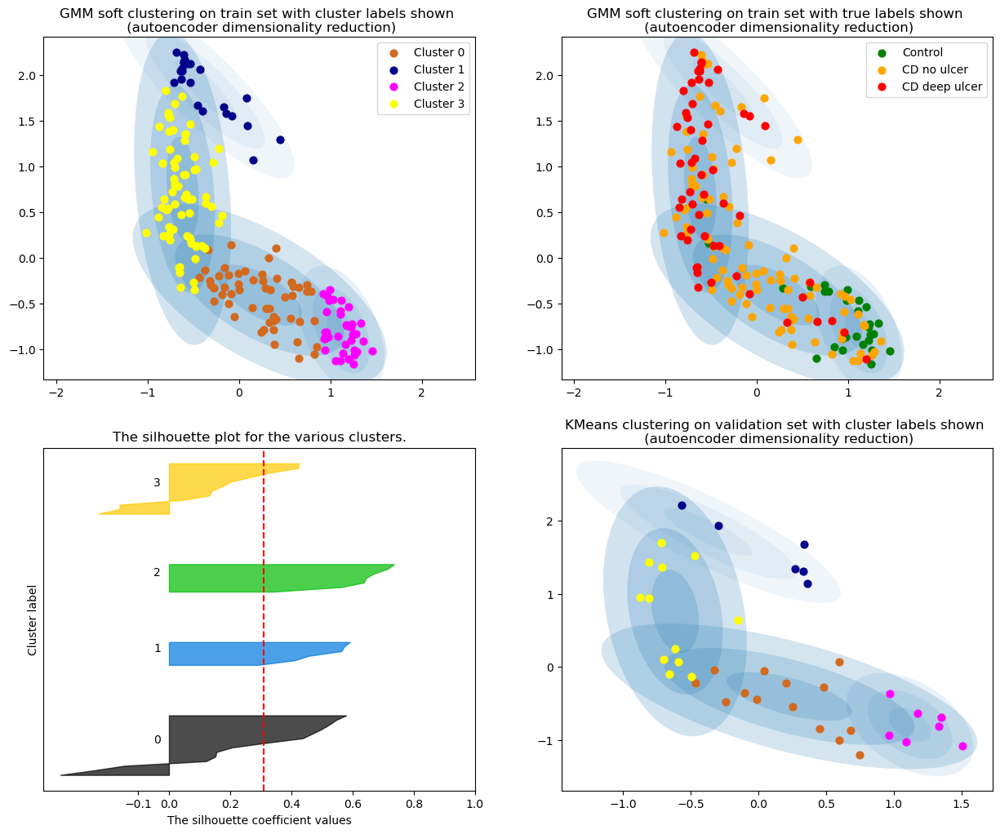

The average silhouette_score is : 0.30869234
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 210


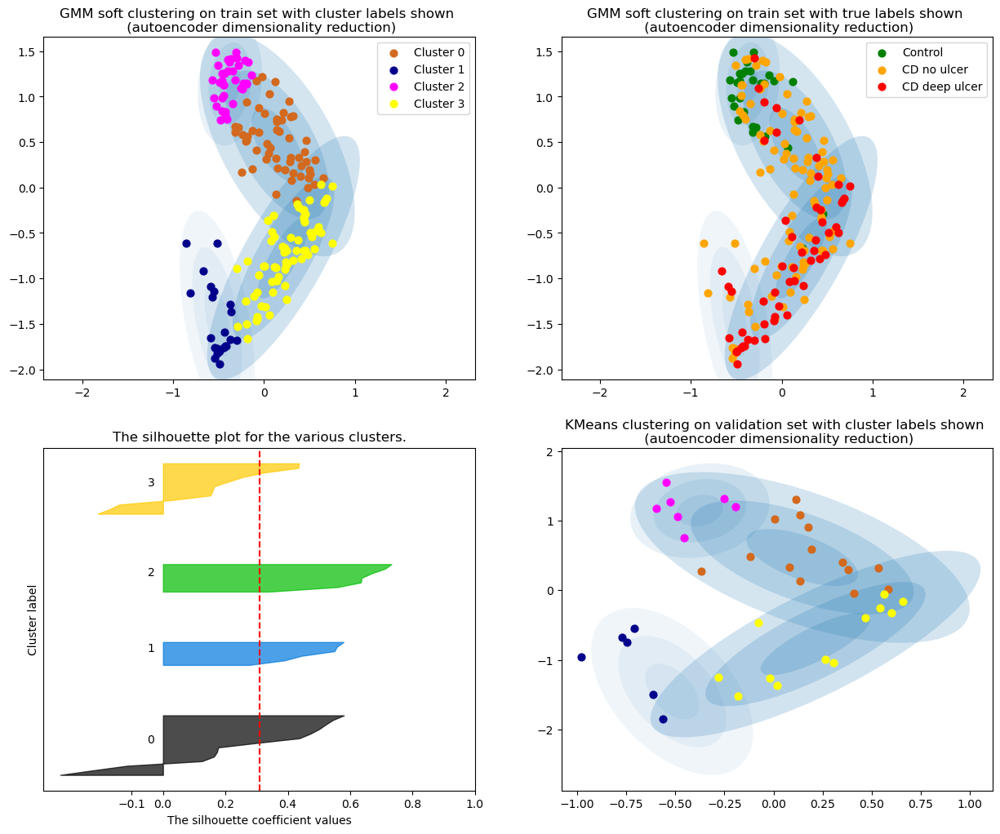

The average silhouette_score is : 0.30897325
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 220


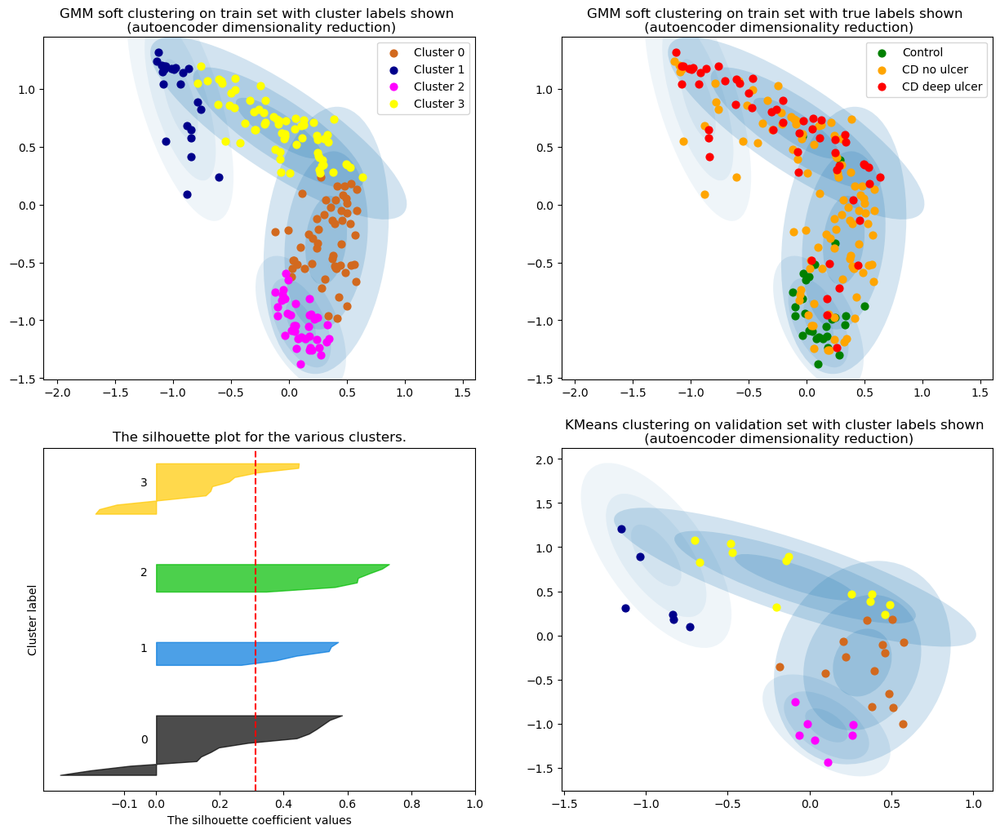

The average silhouette_score is : 0.31120276
Accuracy: 0.20512820512820512
F1 score: 0.2596308683265205


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 230


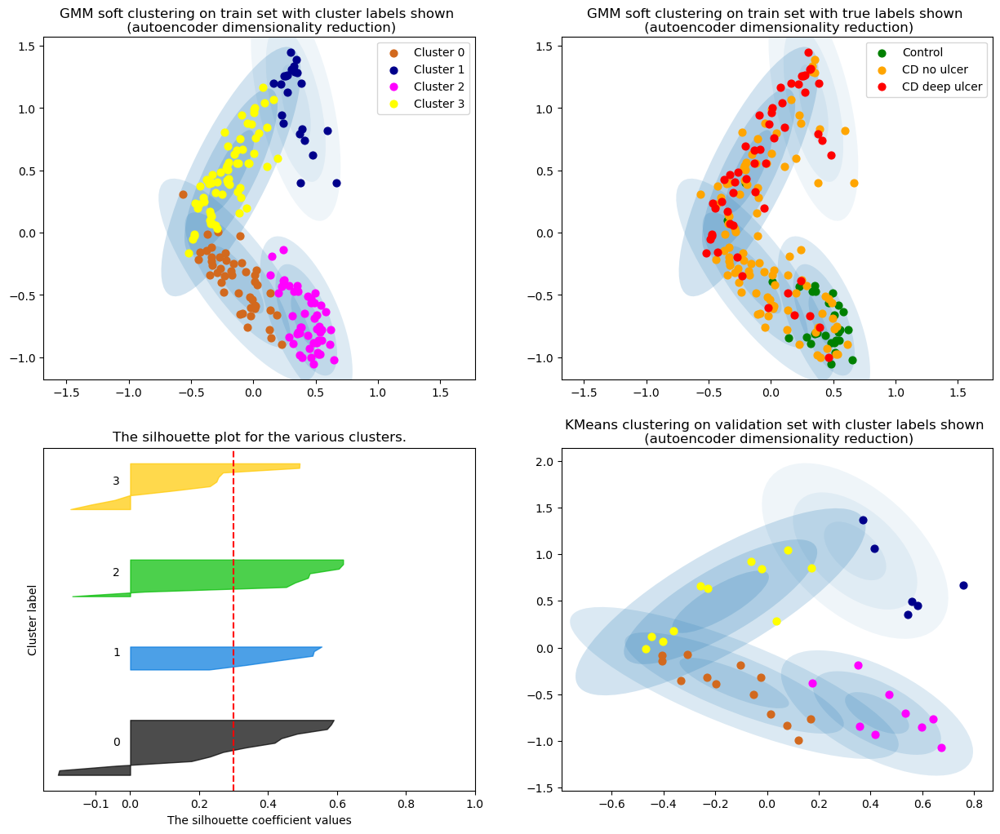

The average silhouette_score is : 0.30020377
Accuracy: 0.20512820512820512
F1 score: 0.2623672623672624


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 240


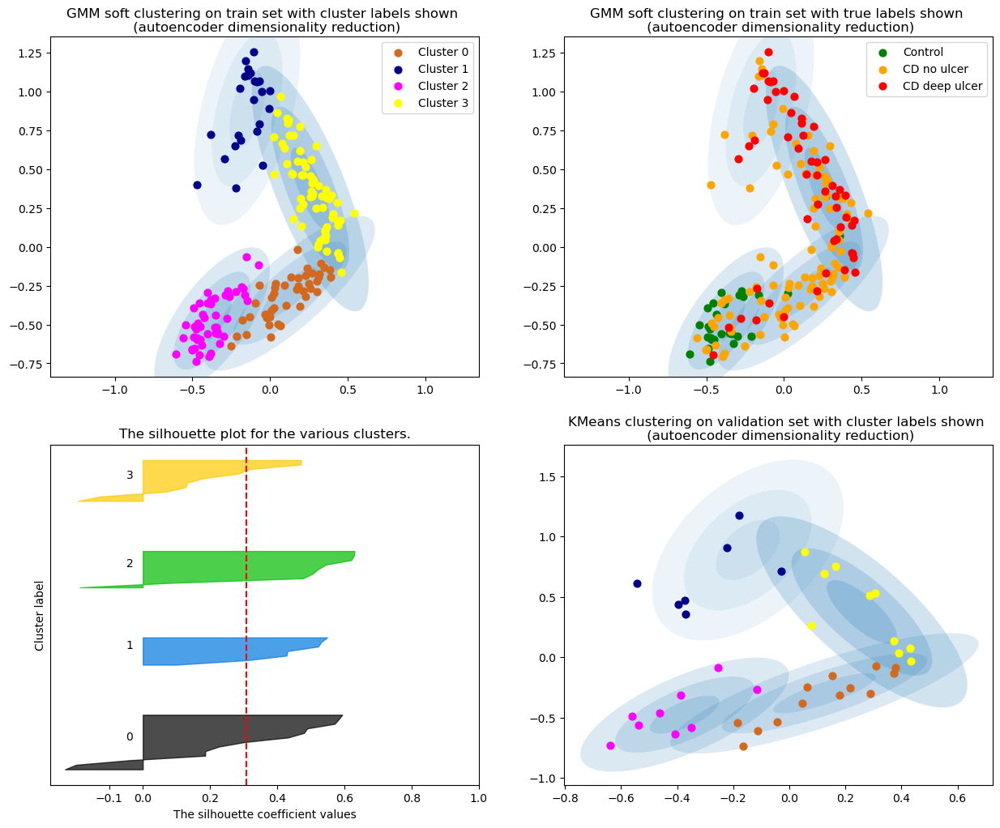

The average silhouette_score is : 0.30785817
Accuracy: 0.20512820512820512
F1 score: 0.25524475524475526


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:86: UserWarning: No data for colormapping

Perplexity = 250


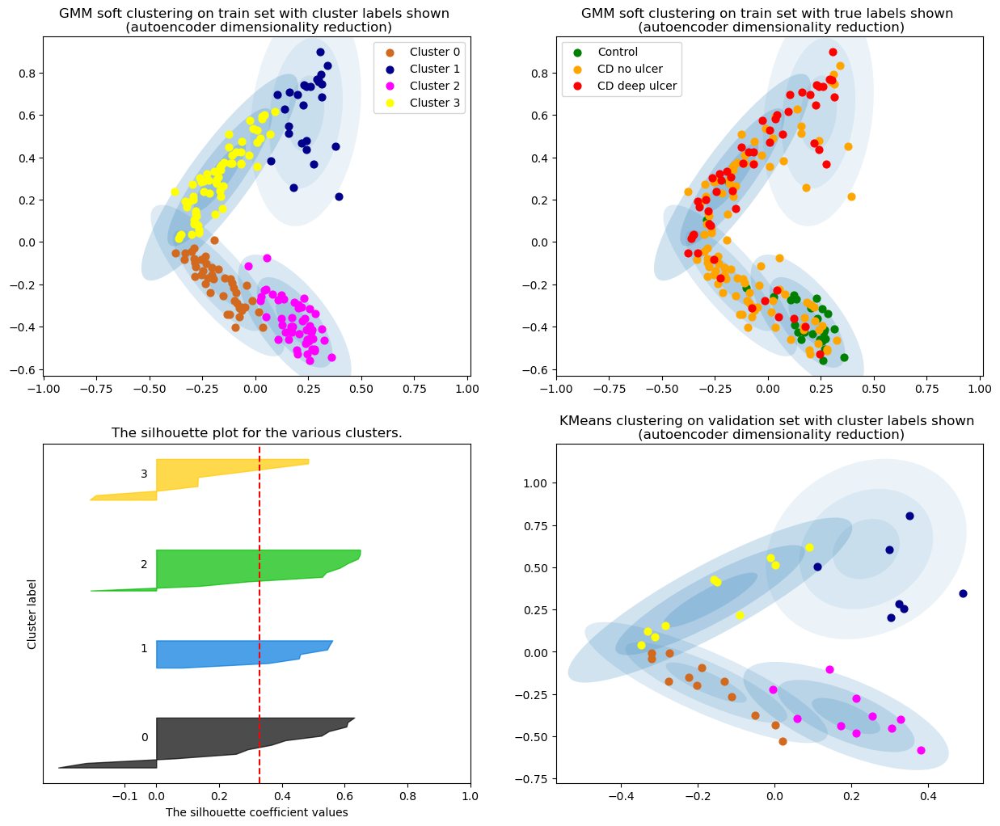

The average silhouette_score is : 0.3275854
Accuracy: 0.20512820512820512
F1 score: 0.2582417582417582


In [58]:
# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_ae, X_train_ae, X_val_ae, train_disease_labels, "autoencoder", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)



    

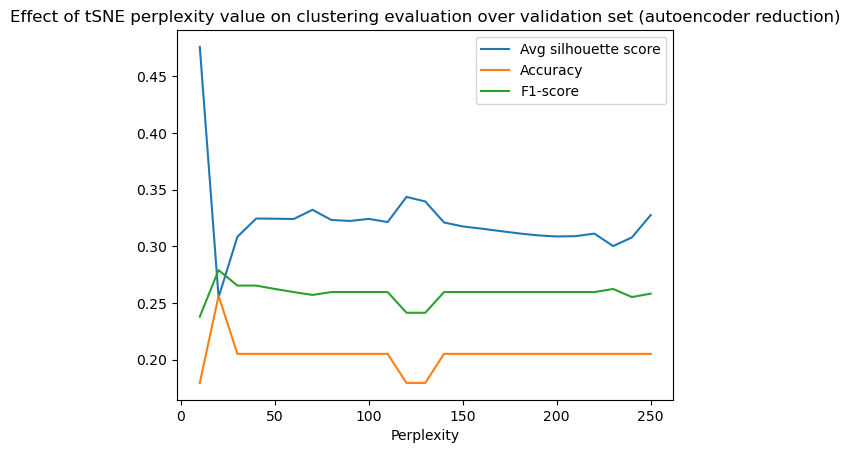

In [59]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


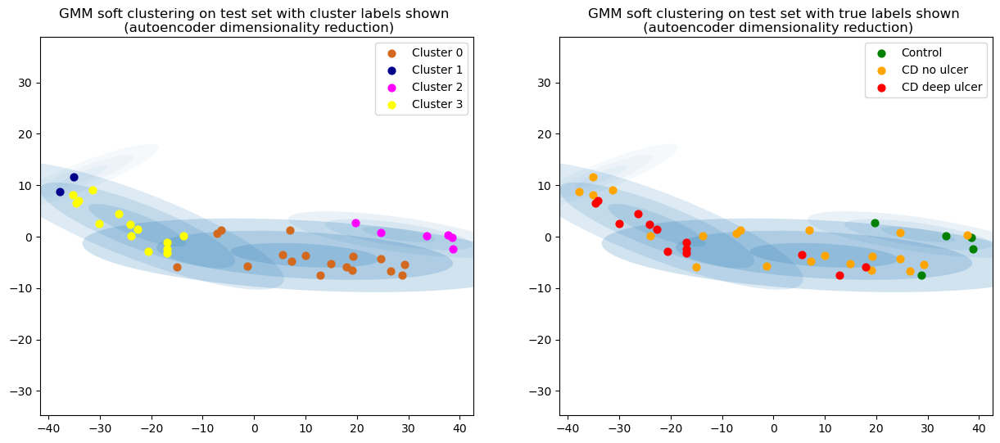

In [60]:
perplexity = 20
gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c)
gmm_labels_ae = plot_gmm(gmm_ae, X_test_ae, X_val_ae, test_disease_labels, "autoencoder", num_c=num_c, test=True)

In [61]:
# np.where(X_test_ae >-30 )
# and X_test_ae[0] <-20
# (X_test_ae > -30 && X_test_ae < -20).all()
# y.logical_and(a, b)
# (X_test_ae[:,0] > -30) and (X_test_ae[:,1] < -20)
# arr = np.logical_and(X_test_ae[:,0] < -20, X_test_ae[:,1] < -12, X_test_ae[:,1] > -20)
# np.where(arr)

In [62]:
# X_test_ae[18,:]

## Process GMM cluster models

In [63]:
import scipy.stats
from scipy.stats import multivariate_normal


In [64]:
# vis
# x, y = np.mgrid[0:30:.01, 0:30:.01]
# pos = np.dstack((x, y))
# fig2 = plt.figure()
# ax2 = fig2.add_subplot(111)
# # for i in range(2):
# ax2.contourf(x, y, comps[0].pdf(pos))
# ax2.contourf(x, y, comps[2].pdf(pos))

In [65]:
def get_amount_matrix_gmm(gmm, X_train, train_disease_labels):
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]
    
    # make matrix to record amount of each class in each mixture component
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    for c, cls in enumerate(classes):
        for i, comp in enumerate(comps): # add up contributions for each component
            weight = w[i]
            pts = X_train[train_disease_labels==c]
            curr_sum = np.sum(comp.pdf(pts)) * weight
            amounts[c][i] = curr_sum
    print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts


def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals


In [66]:
def get_class_probs(X_test, gmm, assignments, couple):
    clus_probs = sum_to_one(gmm.predict_proba(X_test))
#     print("clus_probs:",clus_probs)
    num_classes = 3
    
    arr = np.zeros((X_test.shape[0], num_classes))
    for c in range(num_classes):
        if assignments[c] == couple:
            arr[:,c] = np.max(clus_probs[:,couple], axis=1)
        else:
            cluster = assignments[c][0]
            arr[:,c] = clus_probs[:,cluster]
    arr = sum_to_one(arr)
            
    return np.argmax(arr, axis=1), arr

In [67]:
# gmm_prediction_ae(x_test_scaled)

In [68]:
# gmm_prediction_ae(x_test_scaled.iloc[[41],:])

In [69]:
def final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels):
    # process
    amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    assignments, couple = process_clusters(amounts, X_train, num_c)
    # retrieve clusters
#     gmm_labels = gmm.predict(X_test)
#     test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
    test_set_clusters, probs = get_class_probs(X_test, gmm, assignments, couple)
#     print(test_set_clusters)
#     print(probs)
    
    return test_set_clusters, probs



### Post-processed GMM models on test set

In [70]:
# gmm_labels_list = [gmm_labels_ae, gmm_labels_pca]
gmm_models_list = [gmm_ae, gmm_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]


In [71]:
# X_test_ae

C:\Users\shard\AppData\Local\Temp\ipykernel_11712\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_11712\1019903210.py:21: Ma

autoencoder
[[6.88825416e-03 3.02169669e-96 3.74375004e-02 1.21025109e-03]
 [5.96749793e-02 8.81399534e-03 2.58695899e-02 3.55758051e-02]
 [1.90074615e-02 1.09960996e-02 8.63315623e-04 3.25476576e-02]]
PCA
[[3.01416196e-03 2.70540514e-23 1.03533562e-02 1.31416610e-01]
 [1.04411727e-01 2.58616404e-02 1.66683579e-01 9.19545834e-02]
 [2.49869035e-02 3.88569091e-02 1.34179798e-01 4.81751117e-03]]


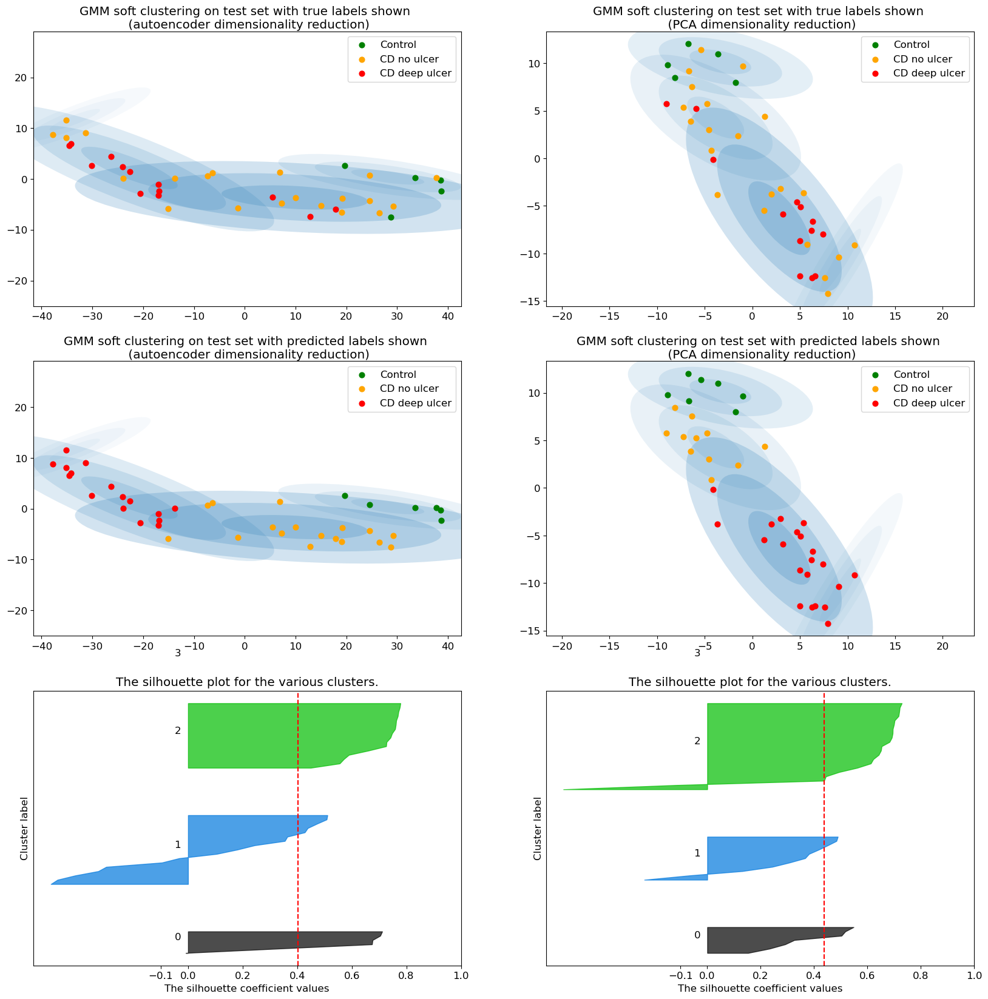

Autoencoder:
Average silhouette score: 0.40215498
Accuracy: 0.6923076923076923
F1 score: 0.6915462033429366
PCA:
Average silhouette score: 0.43766722
Accuracy: 0.5897435897435898
F1 score: 0.5703871292106586


In [72]:
plt.rcParams.update({'font.size': 12})

def plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c):
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
#         if i==0:
#             num_clusters = num_c
#             cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
#             colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
#             ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
#                          wrap=True)
#         else:
#     fig, ax = plt.subplots()
    (fig, subplots) = plt.subplots(3, 2, figsize=(20, 20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    final_probs_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(gmm_models_list)):
    #         print(i)
            ax = subplots[t][i]
            gmm = gmm_models_list[i]
    #         gmm_labels = gmm_labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
    #         amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    #         assignments, couple = process_clusters(amounts, X_train, num_c)
    #         test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
            if t > 0:
                print(reduction[i])
                test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
                final_clusters_lst.append(test_set_clusters)
                final_probs_lst.append(probs)
            else:
                test_set_clusters = test_disease_labels




            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on test set with "+ label +" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            w_factor = 0.2 / gmm.weights_.max()
            for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
                draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
            ax.legend()

#     s_avgs = []
#     for j in range(2):
#         ax = subplots[2][j]
#         X_test = test_set_list[j]
#         test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         s_avgs.append(silhouette_avg)
#         plot_silhouette(num_c, test_clusters, sample_silhouette_values, silhouette_avg, ax)
        
#             s_avgs = []


    s_avgs = []        
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         print(silhouette_avg)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, test_disease_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)


    return final_clusters_lst, final_probs_lst
        
final_clusters_lst, final_probs_lst = plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c)

3rd graph - substructure clustering processed in combination with true labels to obtain final 3 cluster clustering; model can now be easily coupled to shap - why better than simple k=3 clustering

## Evaluation of final clustering models

In [73]:
final_clusters_gmm_ae, final_clusters_gmm_pca = final_clusters_lst
final_probs_gmm_ae, final_probs_gmm_pca = final_probs_lst

In [74]:
test_disease_labels = test_disease_labels.reshape(1,-1)[0]

In [75]:
test_labels = test_disease_labels.reshape(-1,1)

## CD vs control (binary classification)

In [76]:
test_disease_labels_binary = test_disease_labels.copy()
test_disease_labels_binary[test_disease_labels_binary==2] = 1
test_disease_labels_binary = test_disease_labels_binary.reshape(-1,1)

### GMM

In [77]:
final_clusters_gmm_ae_binary = final_clusters_gmm_ae.copy()
final_clusters_gmm_ae_binary[final_clusters_gmm_ae_binary==2] = 1
final_clusters_gmm_ae_binary = final_clusters_gmm_ae_binary.reshape(-1,1)

In [78]:
final_clusters_gmm_pca_binary = final_clusters_gmm_pca.copy()
final_clusters_gmm_pca_binary[final_clusters_gmm_pca_binary==2] = 1
final_clusters_gmm_pca_binary = final_clusters_gmm_pca_binary.reshape(-1,1)

In [79]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.9230769230769231

In [80]:
f1_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.955223880597015

In [81]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.27611116

In [82]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.8974358974358975

In [83]:
f1_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.9393939393939394

In [84]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.2780548

### KMeans

In [85]:
final_clusters_km_ae_binary = final_clusters_ae.copy()
final_clusters_km_ae_binary[final_clusters_km_ae_binary==2] = 1
final_clusters_km_ae_binary = final_clusters_km_ae_binary.reshape(-1,1)

final_clusters_km_pca_binary = final_clusters_pca.copy()
final_clusters_km_pca_binary[final_clusters_km_pca_binary==2] = 1
final_clusters_km_pca_binary = final_clusters_km_pca_binary.reshape(-1,1)

In [86]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.8461538461538461

In [87]:
f1_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.90625

In [88]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_km_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.41083458

In [89]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.6923076923076923

In [90]:
f1_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.8181818181818182

In [91]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_km_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-0.040471137

## Control, CD no ulcer, CD deep ulcer (multiclass)

### GMM

In [92]:
final_clusters_gmm_ae = final_clusters_gmm_ae.reshape(-1,1)
final_clusters_gmm_pca = final_clusters_gmm_pca.reshape(-1,1)


In [93]:
final_clusters_gmm_ae.shape

(39, 1)

In [94]:
test_disease_labels.shape

(39,)

### Autoencoder

In [95]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_ae)
accuracy

0.6923076923076923

In [96]:
f1_score(test_disease_labels, final_clusters_gmm_ae, average='weighted')

0.6915462033429366

In [97]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.40215498

### PCA

In [98]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_pca)
accuracy

0.5897435897435898

In [99]:
f1_score(test_disease_labels, final_clusters_gmm_pca, average='weighted')

0.5703871292106586

In [100]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.43766722

### KMeans

In [101]:
final_clusters_ae = final_clusters_ae.reshape(-1,1)
final_clusters_pca = final_clusters_pca.reshape(-1,1)

### Autoencoder

In [102]:
km_ae_accuracy = accuracy_score(test_disease_labels, final_clusters_ae)
km_ae_accuracy

0.5128205128205128

In [103]:
f1_score(test_disease_labels, final_clusters_ae, average='weighted')

0.5071181911054657

In [104]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.360967

### PCA

In [105]:
km_pca_accuracy = accuracy_score(test_disease_labels, final_clusters_pca)
km_pca_accuracy

0.4358974358974359

In [106]:
f1_score(test_disease_labels, final_clusters_pca, average='weighted')

0.43043837882547564

In [107]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.4575296

## Find class probabilities from cluster model

In [108]:
def get_probs(point, comps, assignments, w):
    probs = []
    for elem in assignments:
        p_cand = []
        for cluster in elem:
            p = comps[cluster].pdf(point) * w[cluster]
#             print("p:",p)
            p_cand.append(p)
#         print(p_cand)
        p = max(p_cand)
        probs.append(p)
        
    return probs

def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals




In [109]:
def get_proba(gmm, assignments, X_test):
    # GMM mixture component distributions
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]

    X_test = X_test.tolist()
    new_list = []
    for point in X_test:
        probs = get_probs(point, comps, assignments, gmm.weights_)
#         print(probs)
        new_list.append(probs)
    pdf_vals = np.asarray(new_list)
#     pdf_vals = -np.log(pdf_vals)
    
#     plt.figure()
#     xr = np.arange(len(pdf_vals))
#     plt.scatter(xr, pdf_vals[:,0])
#     plt.scatter(xr, pdf_vals[:,1])
#     plt.scatter(xr, pdf_vals[:,2])
#     plt.show()

    # rescale so adds up to 1
#     proba = pdf_vals.copy()
#     for i in range(len(proba)):
#         row = proba[i,:]
#         rescaled = softmax(row)

#         proba[i,:] = rescaled
    proba = pdf_vals
    
    return proba

In [110]:
# amounts = get_amount_matrix_gmm(gmm_ae, X_train_ae, train_disease_labels)
# assignments_ae, couple_ae = process_clusters(amounts, X_train_ae, num_c)
# assignments_ae

In [111]:
# amounts = get_amount_matrix_gmm(gmm_pca, X_train_pca, train_disease_labels)
# assignments_pca, couple_pca = process_clusters(amounts, X_train_pca, num_c)
# assignments_pca

In [112]:
# gmm = gmm_ae
# assignments = assignments_ae

In [113]:
# gmm_ae_prob = get_proba(gmm_ae, assignments_ae, X_test_ae)

In [114]:
# gmm_pca_prob = get_proba(gmm_pca, assignments_pca, X_test_pca)

## Retrieving probabilities across classes using GMM model

In [115]:
def save_gmm(gmm, reduction_type):
    path = "data/models/"
    # save to file
    gmm_name = path + 'gmm_' + reduction_type
    np.save(gmm_name + '_weights', gmm.weights_, allow_pickle=False)
#     print('Saved ' + gmm_name + '_weights.npy')
    np.save(gmm_name + '_means', gmm.means_, allow_pickle=False)
    np.save(gmm_name + '_covariances', gmm.covariances_, allow_pickle=False)
    
def load_gmm(gmm_name):
    # reload
    means = np.load(gmm_name + '_means.npy')
    covar = np.load(gmm_name + '_covariances.npy')
    loaded_gmm = mixture.GaussianMixture(n_components = len(means), covariance_type='full')
    loaded_gmm.precisions_cholesky_ = np.linalg.cholesky(np.linalg.inv(covar))
    loaded_gmm.weights_ = np.load(gmm_name + '_weights.npy')
    loaded_gmm.means_ = means
    loaded_gmm.covariances_ = covar
    
    return loaded_gmm


In [116]:
full_pca_dataset.iloc[split_pt:,:] = full_pca_dataset.iloc[split_pt:,:]
full_pca_dataset

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
230_CD_deep_ulcer,3.438941,-0.091869,0.416758,-0.338899,0.072570,0.778925,-0.385882,0.163441,-0.010491,0.224513,...,-0.015743,0.102076,-0.023204,-0.186970,-0.063614,-0.058062,-0.050539,-0.254624,-0.354322,-0.004083
202_CD_deep_ulcer,0.967926,-1.555053,0.357813,-0.576845,0.251410,0.143775,-0.053263,-0.164162,-0.084384,0.328801,...,0.297517,0.035678,0.045667,0.049047,0.158623,0.045135,-0.036006,-0.111289,-0.062109,0.014869
84_control,-3.141619,0.661472,-0.578550,-0.066025,0.163540,0.219103,0.217290,-0.156736,-0.351770,0.046552,...,-0.119786,-0.042007,0.129408,-0.098636,0.078799,-0.088141,-0.233041,-0.150510,-0.156465,-0.150262
22_CD_deep_ulcer,-1.641458,0.019507,0.205896,-0.402185,0.369342,-0.543471,-0.514498,0.514060,0.558534,0.176739,...,-0.157920,-0.039221,0.033003,0.077719,-0.135029,-0.088890,0.194376,0.204734,-0.051522,0.149299
35_control,-2.774731,0.971814,-1.029952,0.067668,0.029446,0.065558,-0.067626,-0.241793,0.048196,0.254932,...,0.069942,-0.166237,-0.164991,-0.069748,-0.293214,0.142348,-0.056131,-0.199816,-0.342436,-0.203046
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273_CD_plain,-2.076711,0.810508,-0.751372,-0.257559,0.037233,-0.166958,0.459237,0.102688,0.382100,0.202568,...,-0.222345,0.051926,-0.070815,0.159719,0.025713,0.046425,-0.064815,-0.166517,-0.079969,-0.148733
23_CD_deep_ulcer,1.893946,-0.047599,0.076832,-0.630463,-0.333784,0.594493,-0.621470,0.450540,0.327648,0.060888,...,-0.101759,0.088106,-0.318254,-0.088547,0.264813,0.028684,0.186297,0.092720,0.160882,-0.172899
210_CD_plain,2.342342,-0.546719,0.372499,-0.606403,-0.117547,0.584836,-0.154494,0.036646,0.184326,0.159604,...,-0.015191,0.145746,0.246967,0.123196,0.246450,0.228957,-0.253672,0.069010,-0.203908,0.030038


In [117]:
full_ds

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,WFDC8,LOC100506385,TRAF6,SLC30A9,ZNF77,LOC100506451,LOC100128103,LOC284294,LOC100419923,KRT37
Patient_ID,,,,,,,,,,,,,,,,,,,,,
230_CD_deep_ulcer,0.512841,0.239306,0.327514,0.462345,0.249761,0.751775,0.000000,0.397554,0.885618,0.342238,...,0.245972,0.206061,0.331737,0.665971,0.520526,0.829675,0.0,0.000000,0.0,0.00000
202_CD_deep_ulcer,0.730613,0.631576,0.719504,0.723623,0.680103,0.669807,0.188788,0.436573,0.654626,0.557570,...,0.263273,0.175898,0.426679,0.624670,0.047303,0.439728,0.0,0.000000,0.0,0.00000
84_control,0.848339,0.806504,0.824615,0.923494,0.762137,0.199403,0.573129,0.192293,0.274358,1.042678,...,0.402809,0.275107,0.621850,0.449404,0.478901,0.459472,0.0,0.005147,0.0,0.00000
22_CD_deep_ulcer,0.788681,0.745856,0.741478,0.847024,0.721888,0.223678,0.388486,0.208201,0.555424,0.719852,...,0.269770,0.224827,0.765126,0.648050,0.554659,0.452266,0.0,0.066095,0.0,0.00000
35_control,0.868755,0.777184,0.832517,0.826357,0.724312,0.000000,0.578185,0.000000,0.391885,0.823626,...,0.172663,0.188365,0.348218,0.444814,0.409077,0.316351,0.0,0.000000,0.0,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273_CD_plain,0.785640,0.732313,0.781703,0.830675,0.704306,0.296024,0.435320,0.199202,0.409907,0.806833,...,0.444678,0.339409,0.414532,0.529085,0.459672,0.578726,0.0,0.000000,0.0,0.00000
23_CD_deep_ulcer,0.610276,0.407870,0.583229,0.646481,0.542063,0.567463,0.128474,0.211069,0.762306,0.475790,...,0.311157,0.263193,0.372075,0.631577,0.446134,0.666428,0.0,0.000000,0.0,0.00000
210_CD_plain,0.440051,0.313384,0.437059,0.571136,0.363223,0.674967,0.264082,0.503306,0.714950,0.417286,...,0.272913,0.208975,0.432354,0.666219,0.412219,0.520778,0.0,0.047052,0.0,0.06532


In [118]:

def gmm_prediction_ae(x_test_scaled):
    # preprocessing

    full_dataset = full_ds.copy()
    split_pt = len(full_dataset) - len(x_test_scaled)
    full_dataset.iloc[split_pt:,:] = x_test_scaled

        
    # dim redction - autoencoder
    full_ae_dataset = ae_encode_dataset(full_dataset)
    
    # tsne
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=24,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_ae_dataset)
    X_test = X[split_pt:]
    
    path = "data/models/"
    filename_assignments = path + "autoencoder_assignments"
    filename_couple = path + "autoencoder_couple"
    load_gmm_name = path + "gmm_autoencoder"
    # load gmm model
    gmm = load_gmm(load_gmm_name)
    # load assignments
    with open(filename_assignments, "rb") as fp:   # Unpickling
        assignments = pickle.load(fp)
    with open(filename_couple, "rb") as fp:   # Unpickling
        couple = pickle.load(fp)
    _, probs = get_class_probs(X_test, gmm, assignments, couple)
    return probs

def gmm_model_get_prediction_ae(x_test_scaled):
    if len(x_test_scaled) <= len(full_ds):
        return gmm_prediction_ae(x_test_scaled)
    else:
        full_resp = np.empty((0,3))
        for i in range(0, len(x_test_scaled), len(full_ds)):
            end = i + len(full_ds)
            if end > len(x_test_scaled):
                end = len(x_test_scaled)
            next_resp = gmm_prediction_ae(x_test_scaled[i:end])
            full_resp = np.concatenate([full_resp, next_resp])
        return full_resp

In [119]:
def gmm_prediction_pca(x_test_scaled):
    # preprocessing
    full_dataset = full_ds.copy()
    split_pt = len(full_dataset) - len(x_test_scaled)
    full_dataset.iloc[split_pt:,:] = x_test_scaled
    
    # dim redction - PCA
    full_pca_dataset, _ = encode_pca(full_dataset)
    
    # tsne
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=24,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_pca_dataset)
    X_test = X[split_pt:]

    path = "data/models/"
    filename_assignments = path + "PCA_assignments"
    filename_couple = path + "PCA_couple"
    load_gmm_name = path + "gmm_PCA"
    # load gmm model
    gmm = load_gmm(load_gmm_name)
    # load assignments
    with open(filename_assignments, "rb") as fp:   # Unpickling
        assignments = pickle.load(fp)
    with open(filename_couple, "rb") as fp:   # Unpickling
        couple = pickle.load(fp)
    _, probs = get_class_probs(X_test, gmm, assignments, couple)
    return probs

def gmm_model_get_prediction_pca(x_test_scaled):
    if len(x_test_scaled) <= len(full_ds):
        return gmm_prediction_pca(x_test_scaled)
    else:
        full_resp = np.empty((0,3))
        for i in range(0, len(x_test_scaled), len(full_ds)):
            end = i + len(full_ds)
            if end > len(x_test_scaled):
                end = len(x_test_scaled)
            next_resp = gmm_prediction_pca(x_test_scaled[i:end])
            full_resp = np.concatenate([full_resp, next_resp])
        return full_resp

In [120]:
def final_gmm_model_get_prob(gmm, X_train, X_test, train_disease_labels, reduction_type, save = False):
    # process
    amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    assignments, couple = process_clusters(amounts, X_train, num_c)
    path = "data/models/"
    if save:
        # save gmm model
        save_gmm(gmm, reduction_type)
        # save assignments
        filename = path + reduction_type + "_assignments"
        filename_c = path + reduction_type + "_couple"
        with open(filename, "wb") as fp:   #Pickling
            pickle.dump(assignments, fp)
        with open(filename_c, "wb") as fp:   #Pickling
            pickle.dump(couple, fp)
    # retrieve clusters
#     probs = get_proba(gmm, assignments, X_test)
    _, probs = get_class_probs(X_test, gmm, assignments, couple)
    
    return probs



## GMM prediction with autoencoder dimensionality reduction

In [121]:
# save required components
gmm_ae_prob = final_gmm_model_get_prob(gmm_ae, X_train_ae, X_test_ae, train_disease_labels, "autoencoder", save=False)
# gmm_ae_prob

[[6.88825416e-03 3.02169669e-96 3.74375004e-02 1.21025109e-03]
 [5.96749793e-02 8.81399534e-03 2.58695899e-02 3.55758051e-02]
 [1.90074615e-02 1.09960996e-02 8.63315623e-04 3.25476576e-02]]


In [122]:
# x_test_scaledvv = np.empty((0,219))
# for i in range(100):
#     x_test_scaledvv = np.concatenate([x_test_scaledvv, x_test_scaled.values])
# x_test_scaledvv.shape

In [123]:
# x_test_scaledvv = pd.concat([x_test_scaled,x_test_scaled,x_test_scaled,x_test_scaled])
# x_test_scaledvv.shape

In [124]:
# x_test_scaledv = x_test_scaled.copy()
# for i in range(5):
#     x_test_scaledv = pd.concat([x_test_scaledv,x_test_scaledv])
    
# x_test_scaled.shape

In [125]:

gmm_ae_prob = gmm_model_get_prediction_ae(x_test_scaled)
# gmm_ae_prob

<class 'pandas.core.frame.DataFrame'>


In [126]:
x_test_scaled.iloc[41,:]

AADAC           0.588189
APOA1           0.625309
APOA4           0.750597
APOB            0.746795
APOC3           0.678619
                  ...   
LOC100506451    0.443042
LOC100128103    0.000000
LOC284294       0.012885
LOC100419923    0.000000
KRT37           0.000000
Name: 260_CD_deep_ulcer, Length: 220, dtype: float64

In [127]:
gmm_model_get_prediction_ae(x_test_scaled.head(1))

<class 'pandas.core.frame.DataFrame'>


array([[1.85444801e-105, 3.57890980e-032, 1.00000000e+000]])

## GMM prediction with PCA dimensionality reduction

In [128]:
# save required components
gmm_pca_prob = final_gmm_model_get_prob(gmm_pca, X_train_pca, X_test_pca, train_disease_labels, "PCA", save=False)

[[3.01416196e-03 2.70540514e-23 1.03533562e-02 1.31416610e-01]
 [1.04411727e-01 2.58616404e-02 1.66683579e-01 9.19545834e-02]
 [2.49869035e-02 3.88569091e-02 1.34179798e-01 4.81751117e-03]]


In [129]:

gmm_pca_prob = gmm_model_get_prediction_pca(x_test_scaled)
gmm_pca_prob.shape

(78, 3)